# Contents :
**Part 0 : Setting up the environnement**
 - <a href="#C1">Importation of libraries</a>
 - <a href="#C2">Definition of functions</a>
 - <a href="#C3">Dataset import</a>
 
***--- Part A : File Analysis ---***
 
**Part 1 : Analysis of the file format**
  
**Part 2 : Analysis of the file content**
 
***--- Part B : Classification of textual data ---***

**Part 3 : Pre-processing**
 - <a href="#C4">Method NLTK</a>
 - <a href="#C5">Method Spacy</a>

**Part 4 : Features Extraction**
 - <a href="#C6">Method BoW - CV</a>
 - <a href="#C7">Method BoW - TF_IDF</a>
 - <a href="#C8">Method Word2Vec</a>
 - <a href="#C9">Method BERT</a>
 - <a href="#C10">Method USE</a>
 
**Part 5 : Modeling and Visualisation**
 - <a href="#C11">Clustering</a>
 - <a href="#C12">Supervised classification</a>
 
***--- Part C : Classification of visual data ---***

**Part 6 : Pre-processing**
 - <a href="#C13">Method OpenCV</a>

**Part 7 : Features Extraction**
 - <a href="#C14">Method ORB</a>
 - <a href="#C15">Method CNN Simple</a>
 - <a href="#C16">Method CNN VGG16</a>
 
**Part 8 : Modeling and Visualisation**
 - <a href="#C17">Clustering</a>
 - <a href="#C18">Supervised classification</a>

# Part 0 : Setting up the environnement

# <a name="C1">Importation of libraries</a>

In [1]:
#import of libraries
import pandas as pd
from pandas import DataFrame
import numpy as np
import statsmodels.api as sm
import datetime as dt
import time

import matplotlib as mp
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import seaborn as sns
sns.set()

import scipy.stats as st
from scipy.cluster.hierarchy import dendrogram

from sklearn import manifold, decomposition
from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn import feature_extraction, model_selection, naive_bayes, pipeline, manifold, preprocessing
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import cluster, metrics
import sklearn.metrics as metrics
from sklearn.metrics import classification_report, accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier

from collections import Counter

import cv2

import re

import string

from wordcloud import WordCloud

import nltk
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('words')
nltk.download('wordnet')

from PIL import Image, ImageOps, ImageFilter
from PIL import Image as Image_PIL

import gensim
import gensim.downloader as gensim_api
from gensim.models import Word2Vec

from scipy.ndimage import gaussian_filter

import os
os.environ["TF_KERAS"]='1'

import transformers
from transformers import *


import spacy
from spacy.matcher import Matcher
from spacy.matcher import PhraseMatcher
from spacy.language import Language
from spacy.tokens import Doc, Span
from spacy.tokens import Token
from string import punctuation
from spacy.lang.en import English

import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

import keras
from keras import backend
from keras.applications import imagenet_utils
from keras.engine import training
from keras.layers import VersionAwareLayers
from keras.utils import data_utils
from keras.utils import layer_utils
from tensorflow.python.util.tf_export import keras_export
from keras.applications.vgg16 import VGG16
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import decode_predictions
from keras.layers import Dense
from keras import Model
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Flatten, Dense

C:\Users\najwa\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:7: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import (to_datetime, Int64Index, DatetimeIndex, Period,
C:\Users\najwa\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:7: FutureWarning: pandas.Float64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import (to_datetime, Int64Index, DatetimeIndex, Period,
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\najwa\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\najwa\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\najwa\AppData\Roaming\nltk_

In [2]:
# Displaying versions of libraries used
print("pandas version : " + pd.__version__)
print("numpy version : " + np.__version__)
print("matplotlib version : " + mp.__version__)
print("seaborn version : " + sns.__version__)
print("tensorfloz version : " + tf.__version__)

pandas version : 1.4.2
numpy version : 1.21.5
matplotlib version : 3.5.1
seaborn version : 0.11.2
tensorfloz version : 2.8.0


# <a name="C2">Definition of functions</a>

In [3]:
# Initialising terms
words = set(nltk.corpus.words.words())
stopwords = nltk.corpus.stopwords.words('english')
lemmatizer = WordNetLemmatizer()

def pretraitement_nltk(desc):
    '''Function that standardises and simplifies the text with nltk'''
      
    # Transforming to lowercase and removing punctuation
    desc_p1 = "".join([i.lower() for i in desc if i not in string.punctuation])
    
    # Deleting numbers
    desc_p2 = ''.join(i for i in desc_p1 if not i.isdigit())
        
    # Tokenising 
    tokens = nltk.tokenize.word_tokenize(desc_p2)
        
    # Deleting stopwords 
    tokens_p1 = [w for w in tokens if w not in stopwords]
        
    # Lemmatising
    tokens_p2 = [lemmatizer.lemmatize(lemmatizer.lemmatize(lemmatizer.lemmatize(w, 'a'),'v'),'n') for w in tokens_p1]

    # Deleting words with less than 3 letters
    tokens_p3 = [w for w in tokens_p2 if len(w) > 3]
    
    return " ".join(tokens_p3)

In [4]:
# Initialising terms
nlp = spacy.load("en_core_web_sm")
pos_tag = ['PROPN', 'ADJ', 'NOUN', 'VERB']
stopwords = list(nlp.Defaults.stop_words)
    
def pretraitement_spacy(desc):
    '''Function that standardises and simplifies the text with spacy'''
    
    # Transforming to lowercase and tokenising
    doc = nlp(desc.lower())

    # Lemmatising and keeping words that are pronoun, adj, noun or verb
    tokens = [token.lemma_ for token in doc if token.pos_ in pos_tag]
    
    # Deleting stopwords
    tokens = [token for token in tokens if token not in stopwords] 
    
    # Deleting words with less than 3 letters
    tokens = [token for token in tokens if len(token) > 3]

    return "".join(str(tokens))

C:\Users\najwa\anaconda3\lib\site-packages\spacy\util.py:837: UserWarning: [W095] Model 'en_core_web_sm' (3.0.0) was trained with spaCy v3.0 and may not be 100% compatible with the current version (3.3.0). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


In [5]:
def pas_une_occ(desc, liste_une_occ):
    '''Function that simplifies the text by deleting words with one occurence'''
        
    # Tokenising 
    tokens = nltk.tokenize.word_tokenize(desc)
        
    # Deleting words with one occurence
    tokens_p1 = [w for w in tokens if w not in liste_une_occ]
        
    return " ".join(tokens_p1)

In [6]:
def encode_df(liste, vectorizer):
    '''Function that encodes a list of words'''
    
    matrix = vectorizer.fit_transform(liste)
    return DataFrame(matrix.toarray(), columns = vectorizer.get_feature_names())

In [7]:
def feature_W2V_fct(sentences, w2v_size, w2v_window, w2v_min_count, w2v_epochs, maxlen) :
    '''Function that creates features using Word2Vec'''
        
    time1 = time.time()
    
    # Creating the model
    sentences = [gensim.utils.simple_preprocess(text) for text in sentences]
    w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                                vector_size=w2v_size,
                                                seed=42,
                                                workers=1)

    w2v_model.build_vocab(sentences)
    w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
    model_vectors = w2v_model.wv
    w2v_words = model_vectors.index_to_key

    # Preparing sentences (tokenization)
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(sentences)
    x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     maxlen=maxlen,
                                                     padding='post') 
                                                   
    num_words = len(tokenizer.word_index) + 1
    
    # Creating embedding matrix
    word_index = tokenizer.word_index
    vocab_size = len(word_index) + 1
    embedding_matrix = np.zeros((vocab_size, w2v_size))
    i=0
    j=0
    
    for word, idx in word_index.items():
        i +=1
        if word in w2v_words:
            j +=1
            embedding_vector = model_vectors[word]
            if embedding_vector is not None:
                embedding_matrix[idx] = model_vectors[word]
            
    word_rate = np.round(j/i,4)
    
    # Creating the model
    input=Input(shape=(len(x_sentences),maxlen),dtype='float64')
    word_input=Input(shape=(maxlen,),dtype='float64')  
    word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
    word_vec=GlobalAveragePooling1D()(word_embedding)  
    embed_model = Model([word_input],word_vec)
    
    # Running the model
    features = embed_model.predict(x_sentences)
    time2 = np.round(time.time() - time1,0)
    
    return features

In [8]:
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    '''Function that prepares textual data to create features with BERT'''
    
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot

In [9]:
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    '''Function that creates features using BERT'''
    
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        
        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
    
    time2 = np.round(time.time() - time1,0)
    print("execution time : ", time2)
     
    return features_bert, last_hidden_states_tot

In [10]:
def feature_USE_fct(sentences, b_size) :
    '''Function that creates features using USE'''
    
    import tensorflow_hub as hub

    embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [11]:
def ARI_fct(features, y_cat_num, l_cat) :
    '''Function that determines the ARI, after PCA/TSNE reduction and KMeans clustering'''
        
    time1 = time.time()
    num_labels=len(l_cat)
    
    # Reducing to PCA components represnting 80% of inertia
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)
    pca = PCA()
    pca.fit(features_scaled)
    sum_pca = np.cumsum(pca.explained_variance_ratio_*100)
    for counter, rank in enumerate(sum_pca):
        if rank > 80:
            features_pca = pca.transform(features_scaled)[:,:counter]
            break
    print('Nb of PCA features: {} representing an inertia of: {}'.format(counter+1,np.cumsum(pca.explained_variance_ratio_*100)[counter]))
    
    # Reducing to 2 TSNE components
    tsne = manifold.TSNE(n_components=2, perplexity=20, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features_pca)
    
    # Determining clusters after TSNE
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, X_tsne, cls.labels_

In [12]:
def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    '''Function that allows to see Tsne on true categories and on clusters'''

    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, loc="best", title="Category")
    plt.title('Descriptions per true categories')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=labels, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels), loc="best", title="Clusters")
    plt.title('Descriptions per clusters')
    
    plt.show()
    print("ARI : ", ARI)

In [13]:
def accuracy_fct(features, df, index_mat) :
    '''Function that determines the accuracy of true categories using supervised classification'''

    # Creating numercial feature for the cat_classe_1 category
    
    time1 = time.time()
    num_labels=len(l_cat)
    
    # Reducing to PCA components represnting 80% of inertia
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)
    pca = PCA()
    pca.fit(features_scaled)
    sum_pca = np.cumsum(pca.explained_variance_ratio_*100)
    for counter, rank in enumerate(sum_pca):
        if rank > 80:
            features_pca = pca.transform(features_scaled)[:,:counter]
            break
    print('Nb of PCA features: {} representing an inertia of: {}'.format(counter+1,np.cumsum(pca.explained_variance_ratio_*100)[counter]))
    
    # Reducing to 2 TSNE components
    tsne = manifold.TSNE(n_components=2, perplexity=20, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features_pca)
    
    # Spliting datatest into 2 datasets (train and test) to compare 2 models (train and real)
    X_train,X_test,y_train,y_test = train_test_split(X_tsne,df['cat_classe_1'],test_size = 0.2 ,random_state= 0 ,stratify = df.cat_classe_1)
    
    # Determining clusters after TSNE
    model = KNeighborsClassifier()
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    Accuracy = np.round(metrics.accuracy_score(y_test, y_pred),4)
    time2 = np.round(time.time() - time1,0)
    print("Accuracy : ", Accuracy, "time : ", time2)
    
    # Confusion matrix
    conf_mat = confusion_matrix(y_test,y_pred)
    df_cm = pd.DataFrame(conf_mat, index = index_mat,
                  columns = [ 0, 1, 2, 3, 4, 5, 6])
    plt.figure(figsize = (10,8))
    sns.heatmap(df_cm, annot=True, fmt='d', cmap="Blues", cbar=False)
    plt.xlabel('Cluster Nb')
    plt.ylabel('True Category')
    plt.title('Confusion Matrix')
    plt.tight_layout()
    plt.show()
    
    return Accuracy, X_tsne

In [14]:
def pretraitement(image):
    '''Function that preprocces the image for CNN'''

    file_dir=os.path.split(image)
    
    # Tranforming to black and white
    img = Image.open(image).convert("L")

    # Equalising the histogram
    img = ImageOps.equalize(img)
    
    # Deleting noise with a kernel (pixels nb = 3)
    img = img.filter(ImageFilter.MedianFilter(size=3))
    
    img.save("Images_NB/"+file_dir[1])
    
    return "Images_NB/"+file_dir[1]

In [15]:
def pretraitement_ORB(im):
    '''Function that preprocces the image for ORB'''

    orb = cv2.ORB_create(500)
    im = cv2.imread(im)

    # Redimensionning the image
    dsize = (224, 224)
    im = cv2.resize(im, dsize)

    # Tranforming to black and white
    im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

    # Equalising frequencies
    im = cv2.equalizeHist(im)   # equalize image histogram

    # Deleting noise
    im = cv2.GaussianBlur(im, (5, 5), 0)

    return im

In [16]:
def build_histogram(kmeans, des, image_num):
    '''Function that builds images histogram'''
    
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist

In [17]:
def features_ORB_fct(df):
    '''Function that creates features using ORB'''

    # Identifying the points of interests and descriptors
    import time, cv2
    orb_keypoints = []
    temps1=time.time()
    orb = cv2.ORB_create(500)

    for image_num in range(len(df)) :
        imgp = pretraitement_ORB(df['image'][image_num])   # equalize image histogram
        kp, des = orb.detectAndCompute(imgp, None)
        orb_keypoints.append(des)

    orb_keypoints_by_img = np.asarray(orb_keypoints)
    orb_keypoints_all    = np.concatenate(orb_keypoints_by_img, axis=0)

    print()
    print("Nb of descripteurs : ", orb_keypoints_all.shape)

    duration1=time.time()-temps1
    print("time ORB descriptor : ", "%15.2f" % duration1, "secondes")

    # Creating image features = histogram of images  = Counting for each image the number of descriptors per cluster (features)
    temps1=time.time()

    # Creating a matrix of histograms
    hist_vectors=[]
    k = int(round(np.sqrt(len(orb_keypoints_all)),0))
    kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
    kmeans.fit(orb_keypoints_all)

    for i, image_desc in enumerate(orb_keypoints_by_img) :
        if i%100 == 0 : print(i)  
        hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
        hist_vectors.append(hist) #histogram is the feature vector

    orb_features = np.asarray(hist_vectors)

    duration1=time.time()-temps1
    print("time ORB features : ", "%15.2f" % duration1, "secondes")

    return orb_features

In [18]:
def features_CNN_fct(df, model):
    '''Function that creates features using CNN'''

    cnn_keypoints = []

    temps1=time.time()

    for image_num in range(len(df)) :
        path = ""
        filename = path + pretraitement(df['image'][image_num])
        img = load_img(filename, target_size=(224, 224))
        # converting image into numpy array 
        img = img_to_array(img)
        # restructuring data for the model
        img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))
        # prepare l'image pour CNN
        img = preprocess_input(img)
        features = model.predict(img)
        cnn_keypoints.append(features)

    cnn_keypoints_by_img = np.asarray(cnn_keypoints)
    cnn_keypoints_all    = np.concatenate(cnn_keypoints_by_img, axis=0)

    print()
    print("Nb of descriptors VGG : ", cnn_keypoints_all.shape)

    duration1=time.time()-temps1
    print("time VGG descriptor : ", "%15.2f" % duration1, "secondes")
    
    return cnn_keypoints_all

# <a name="C3">Dataset import</a>

In [19]:
#import of file
df = pd.read_csv("flipkart_com-ecommerce_sample_1050.csv")

In [20]:
#copy of file
df_or = df.copy()

# --- Part A : File Analysis ---

# Part 1 : Analysis of file format

In [21]:
# Displaying 5 first lines
df.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [22]:
# Displaying file size
df.shape

(1050, 15)

In [23]:
# Displaying columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [24]:
# Correcting type to type Date
df.crawl_timestamp = pd.to_datetime(df.crawl_timestamp, errors='coerce')

In [25]:
# Searching duplicates
df.duplicated().sum()

0

In [26]:
# Displaying missing data
df.isna().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [27]:
# Displaying column descriptions
df.describe()

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


In [28]:
# Showing categorical columns
df.describe(include = "object")

,uniq_id,product_url,product_name,product_category_tree,pid,image,description,product_rating,overall_rating,brand,product_specifications
count,1050,1050,1050,1050,1050,1050,1050,1050,1050,712,1049
unique,1050,1050,1050,642,1050,1050,1050,27,27,490,984
top,55b85ea15a1536d46b7190ad6fff8ce7,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""va..."
freq,1,1,1,56,1,1,1,889,889,11,22


In [29]:
# Displaying values of 'product_rating'
df['product_rating'].unique()

array(['No rating available', '5', '1', '2.3', '2.7', '4.5', '4', '3.8',
       '4.3', '3.7', '3.6', '3.5', '4.1', '4.9', '3.1', '4.2', '4.8',
       '4.4', '3.9', '3', '3.3', '2.5', '2', '4.7', '2.2', '3.2', '1.5'],
      dtype=object)

In [30]:
# Displaying values of 'overall_rating'
df['overall_rating'].unique()

array(['No rating available', '5', '1', '2.3', '2.7', '4.5', '4', '3.8',
       '4.3', '3.7', '3.6', '3.5', '4.1', '4.9', '3.1', '4.2', '4.8',
       '4.4', '3.9', '3', '3.3', '2.5', '2', '4.7', '2.2', '3.2', '1.5'],
      dtype=object)

In [31]:
# Replacing "no rating" par NaN for both
df['product_rating'] = df['product_rating'].replace ("No rating available",np.nan)
df['overall_rating'] = df['overall_rating'].replace ("No rating available",np.nan)

# <a name="C4">Analysis of file content</a>

In [32]:
# Displaying first 2 lines
df.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56+00:00,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,NaN,NaN,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56+00:00,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,NaN,NaN,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [33]:
# Displaying details of first line
for c in df.columns:
    print(c, " : ", df[c][0])

uniq_id  :  55b85ea15a1536d46b7190ad6fff8ce7
crawl_timestamp  :  2016-04-30 03:22:56+00:00
product_url  :  http://www.flipkart.com/elegance-polyester-multicolor-abstract-eyelet-door-curtain/p/itmeg7bkzdgthcts?pid=CRNEG7BKMFFYHQ8Z
product_name  :  Elegance Polyester Multicolor Abstract Eyelet Door Curtain
product_category_tree  :  ["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]
pid  :  CRNEG7BKMFFYHQ8Z
retail_price  :  1899.0
discounted_price  :  899.0
image  :  55b85ea15a1536d46b7190ad6fff8ce7.jpg
is_FK_Advantage_product  :  False
description  :  Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environmen

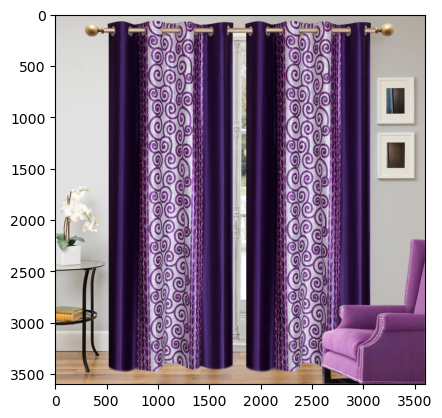

In [34]:
# Visualising photo assosiated with this line
plt.style.use('default')
image = plt.imread("Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg")
plt.imshow(image)

In [35]:
# Creating a dataset with relevant features 
dataset = df[['image', 'product_category_tree','product_name','discounted_price','description']]
dataset.head(2)

,image,product_category_tree,product_name,discounted_price,description
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,"[""Home Furnishing >> Curtains & Accessories >>...",Elegance Polyester Multicolor Abstract Eyelet ...,899.0,Key Features of Elegance Polyester Multicolor ...
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Sathiyas Cotton Bath Towel,449.0,Specifications of Sathiyas Cotton Bath Towel (...


In [36]:
# Creating a list of strings removing >> to identify articles' category
liste = dataset["product_category_tree"].str.split(">>")
liste[0]

['["Home Furnishing ',
 ' Curtains & Accessories ',
 ' Curtains ',
 ' Elegance Polyester Multicolor Abstract Eyelet Do..."]']

In [37]:
# Retrieving first 2 elements of the list = 2 products classes
dataset["cat_classe_1"] = liste.apply(lambda x: x[0])
dataset["cat_classe_2"] = liste.apply(lambda x: x[1])

C:\Users\najwa\AppData\Local\Temp\ipykernel_9716\1318638186.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset["cat_classe_1"] = liste.apply(lambda x: x[0])
C:\Users\najwa\AppData\Local\Temp\ipykernel_9716\1318638186.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset["cat_classe_2"] = liste.apply(lambda x: x[1])


In [38]:
# Shwoing the new dataset
dataset.head(2)

,image,product_category_tree,product_name,discounted_price,description,cat_classe_1,cat_classe_2
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,"[""Home Furnishing >> Curtains & Accessories >>...",Elegance Polyester Multicolor Abstract Eyelet ...,899.0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing",Curtains & Accessories
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Sathiyas Cotton Bath Towel,449.0,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care",Baby Bath & Skin


In [39]:
# Displaying the number of categories in classe 1
dataset["cat_classe_1"].nunique()

7

In [40]:
# Correcting Classe 1 categories
dataset["cat_classe_1"] = dataset["cat_classe_1"].map(lambda x: x.replace('["',''))

C:\Users\najwa\AppData\Local\Temp\ipykernel_9716\478852771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset["cat_classe_1"] = dataset["cat_classe_1"].map(lambda x: x.replace('["',''))


In [41]:
# Displaying the number of categories in classe 2
dataset["cat_classe_2"].nunique()

63

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Home Furnishing '),
  Text(1, 0, 'Baby Care '),
  Text(2, 0, 'Watches '),
  Text(3, 0, 'Home Decor & Festive Needs '),
  Text(4, 0, 'Kitchen & Dining '),
  Text(5, 0, 'Beauty and Personal Care '),
  Text(6, 0, 'Computers ')])

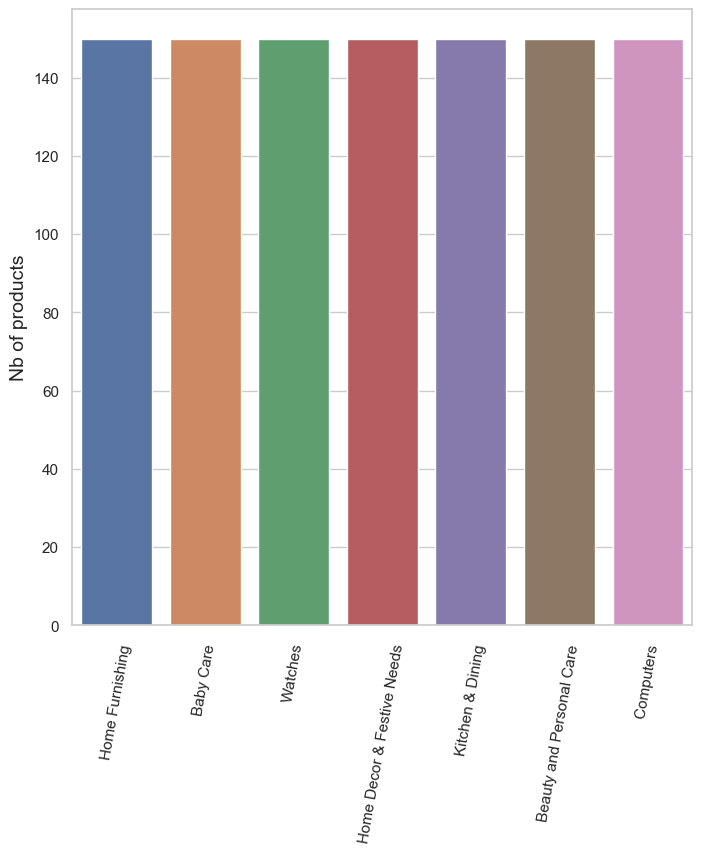

In [42]:
# Nb of products in each classe 1 category
sns.set_theme(style="whitegrid")
plt.figure(figsize=(8, 8))

nb = dataset["cat_classe_1"].value_counts()
nb = pd.DataFrame(nb)

ax = sns.barplot(x=nb.index, y=nb["cat_classe_1"])

plt.ylabel("Nb of products", size=14)
    
plt.xticks(rotation=80)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62]),
 [Text(0, 0, ' Wrist Watches '),
  Text(1, 0, ' Laptop Accessories '),
  Text(2, 0, ' Infant Wear '),
  Text(3, 0, ' Coffee Mugs '),
  Text(4, 0, ' Showpieces '),
  Text(5, 0, ' Bed Linen '),
  Text(6, 0, ' Fragrances '),
  Text(7, 0, ' Network Components '),
  Text(8, 0, ' Cookware '),
  Text(9, 0, ' Table Decor & Handicrafts '),
  Text(10, 0, ' Combos and Kits '),
  Text(11, 0, ' Wall Decor & Clocks '),
  Text(12, 0, ' Bath Linen '),
  Text(13, 0, ' Curtains & Accessories '),
  Text(14, 0, ' Makeup '),
  Text(15, 0, ' Baby Bedding '),
  Text(16, 0, ' Body and Skin Care '),
  Text(17, 0, ' Baby & Kids Gifts '),
  Text(18, 0, ' Baby Bath & Skin '),
  Text(19, 0, ' Kitchen Tools '),
  Text(20, 0, ' Kitchen

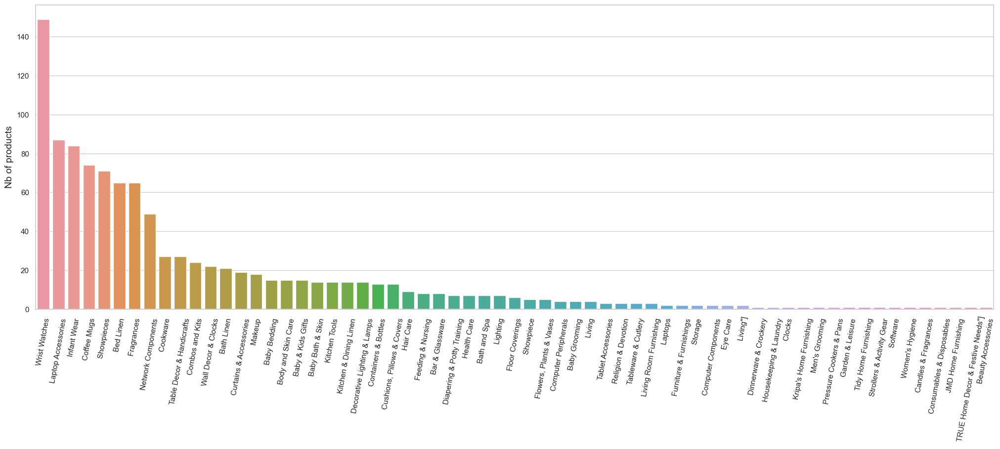

In [43]:
# Nb of products in each classe 2 category
plt.figure(figsize=(25, 8))

plt.xticks(rotation=80)

nb = dataset["cat_classe_2"].value_counts()
nb = pd.DataFrame(nb)

sns.barplot(x=nb.index, y=nb["cat_classe_2"])

plt.ylabel("Nb of products", size=14)
    
plt.xticks(rotation=80)

In [44]:
# Displaying the 10 descriptions for each classe 1 categories
for classe in dataset["cat_classe_1"].unique():
    data_temp = dataset.loc[dataset['cat_classe_1'] == classe,:]
    print('\n', classe, " : ")
    i=1
    for desc in data_temp['description'].sample(10):
        print(i, ' : ',desc, '\n')
        i=i+1


 Home Furnishing   : 
1  :  Buy Rajasthan Crafts Abstract Single Quilts & Comforters Multicolor at Rs. 840 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery! 

2  :  Buy meSleep Animal Cushions Cover at Rs. 699 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery! 

3  :  Key Features of Furnishing Zone Printed Back Cushion Attractive Colours Fiber Filled Great As Decorative Economy Range Machine Washable,Furnishing Zone Printed Back Cushion (Pack of2, Gold) Price: Rs. 295 Soft Fur Cushion For Your Loved Ones (14inch),Beautifully Crafted,Decorative,Washable,Gift Item,Specifications of Furnishing Zone Printed Back Cushion (Pack of2, Gold) General External Material Polyester Velvet Pillow Cover Material Polyester Velvet Brand Furnishing Zone Pillow Cover Design Two Sided Designed Fabric Sweat Absorbent Yes Type Back Cushion Model Name TTFUR-01 Filling Material Microfibre Hand Washable Yes Model ID TT-03 Pillow Design Rectangle Color Gold Dimensio

In [45]:
# Displaying content of 'image'
dataset['image']

0       55b85ea15a1536d46b7190ad6fff8ce7.jpg
1       7b72c92c2f6c40268628ec5f14c6d590.jpg
2       64d5d4a258243731dc7bbb1eef49ad74.jpg
3       d4684dcdc759dd9cdf41504698d737d8.jpg
4       6325b6870c54cd47be6ebfbffa620ec7.jpg
                        ...                 
1045    958f54f4c46b53c8a0a9b8167d9140bc.jpg
1046    fd6cbcc22efb6b761bd564c28928483c.jpg
1047    5912e037d12774bb73a2048f35a00009.jpg
1048    c3edc504d1b4f0ba6224fa53a43a7ad6.jpg
1049    f2f027ad6a6df617c9f125173da71e44.jpg
Name: image, Length: 1050, dtype: object

In [46]:
# Formatting content of "image" to allow for viewing
dataset['image'] = "Images/"+dataset['image']
dataset['image']

C:\Users\najwa\AppData\Local\Temp\ipykernel_9716\3475656057.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['image'] = "Images/"+dataset['image']


0       Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg
1       Images/7b72c92c2f6c40268628ec5f14c6d590.jpg
2       Images/64d5d4a258243731dc7bbb1eef49ad74.jpg
3       Images/d4684dcdc759dd9cdf41504698d737d8.jpg
4       Images/6325b6870c54cd47be6ebfbffa620ec7.jpg
                           ...                     
1045    Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg
1046    Images/fd6cbcc22efb6b761bd564c28928483c.jpg
1047    Images/5912e037d12774bb73a2048f35a00009.jpg
1048    Images/c3edc504d1b4f0ba6224fa53a43a7ad6.jpg
1049    Images/f2f027ad6a6df617c9f125173da71e44.jpg
Name: image, Length: 1050, dtype: object

Home Furnishing   : 


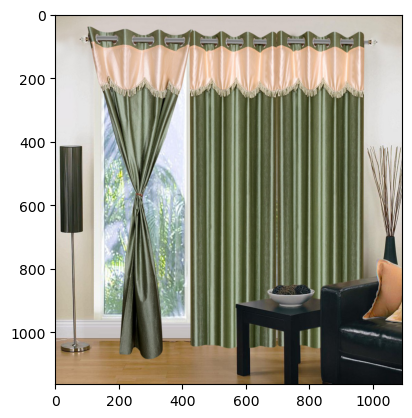

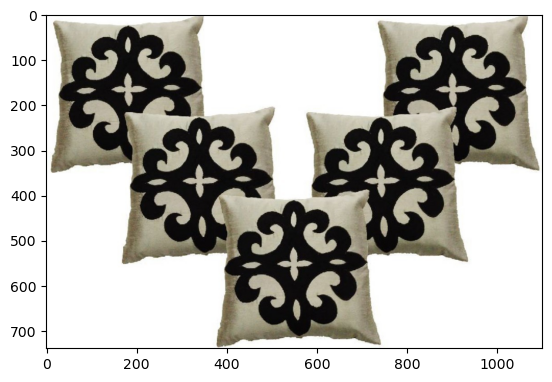

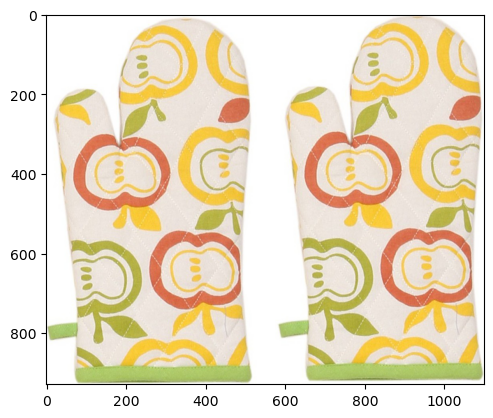

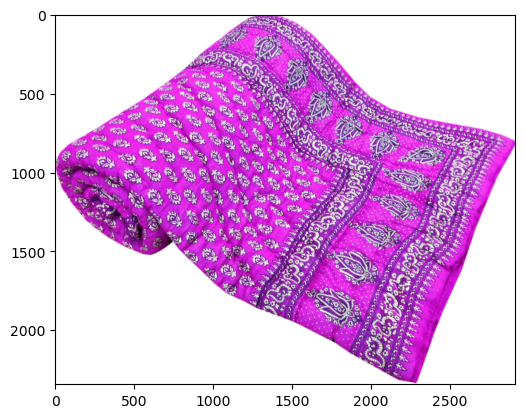

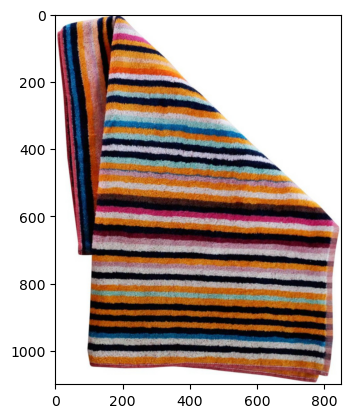

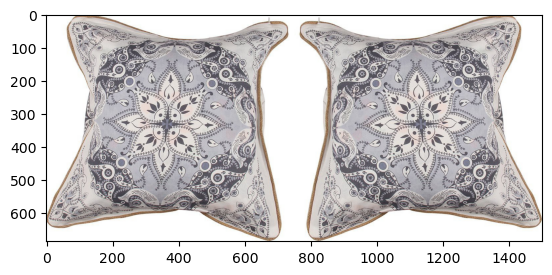

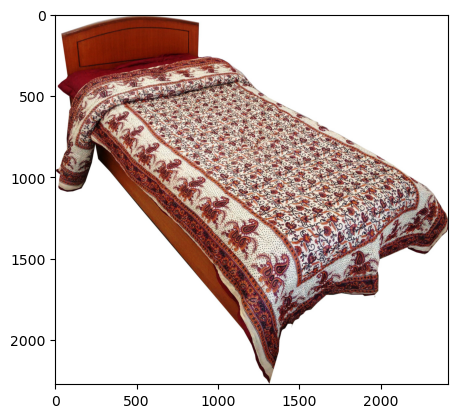

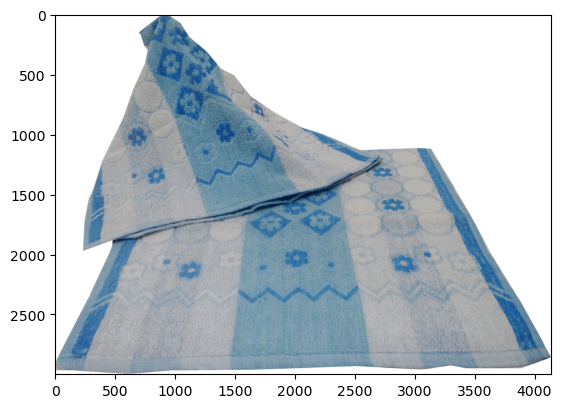

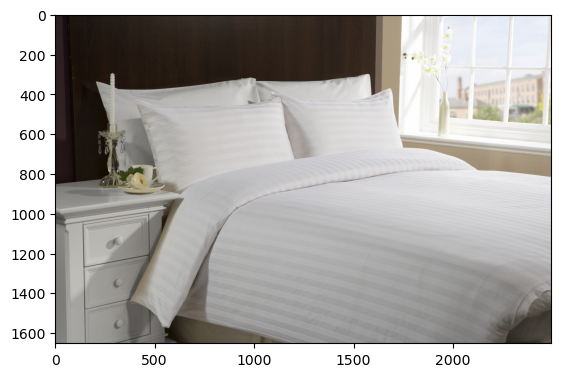

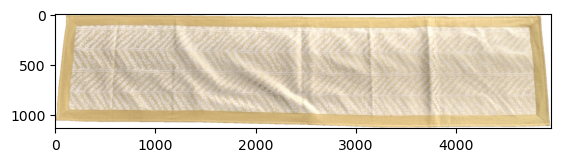

Baby Care   : 


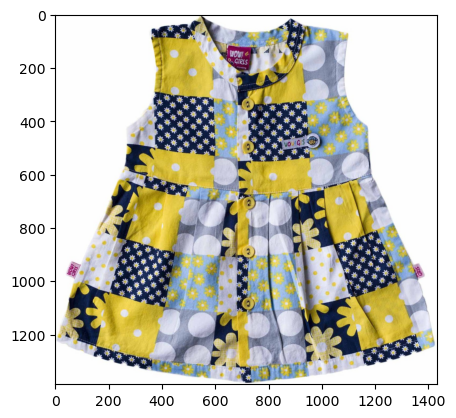

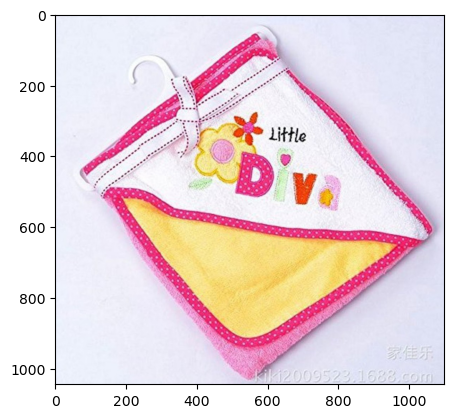

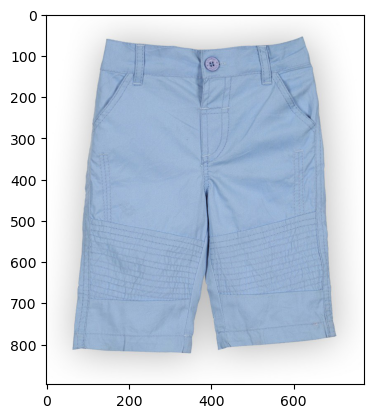

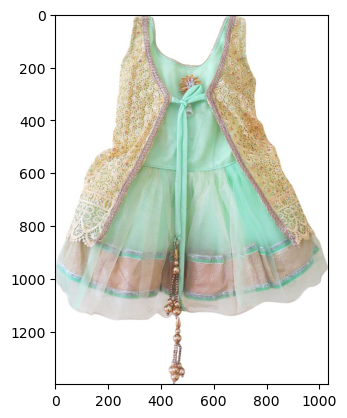

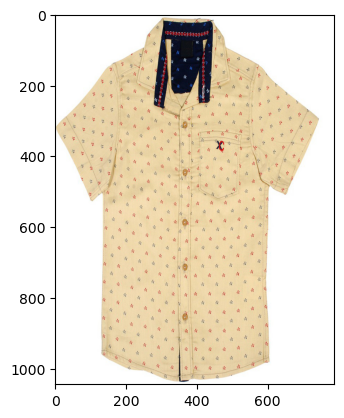

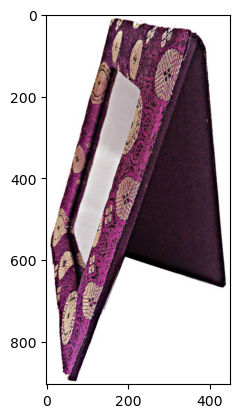

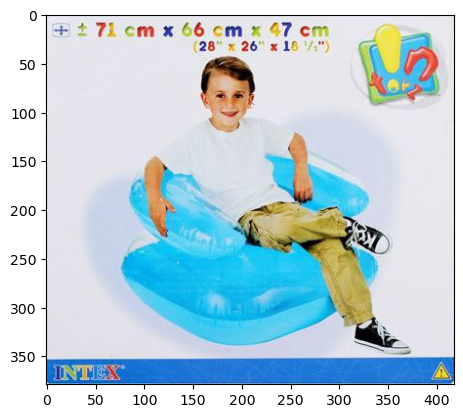

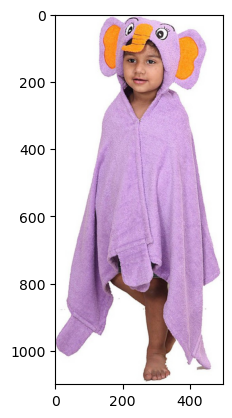

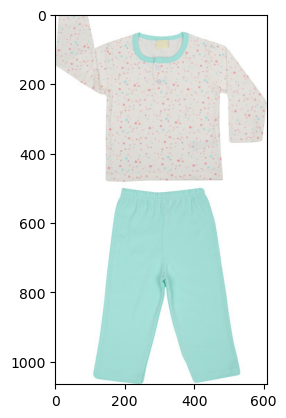

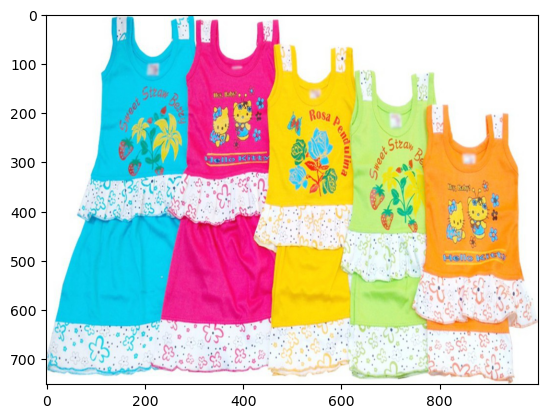

Watches   : 


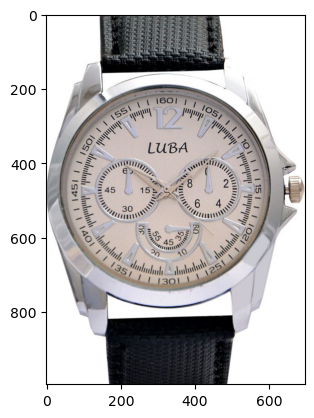

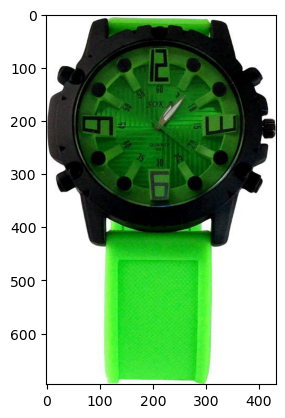

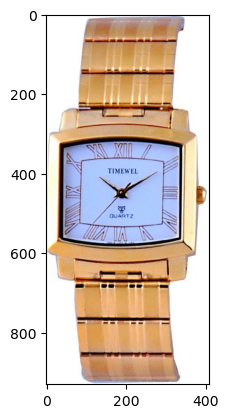

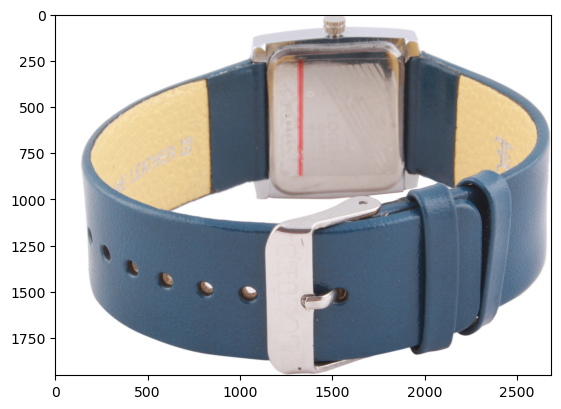

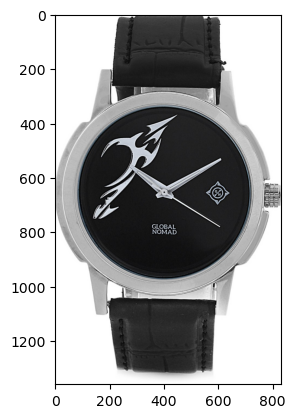

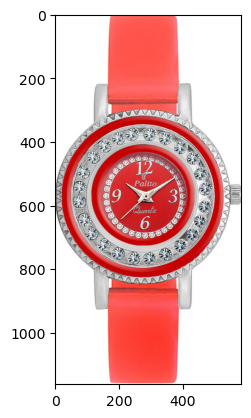

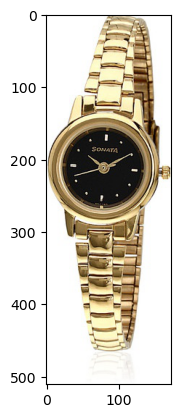

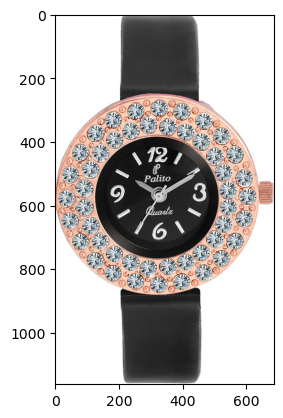

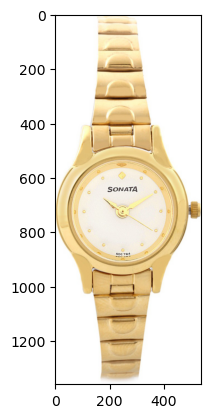

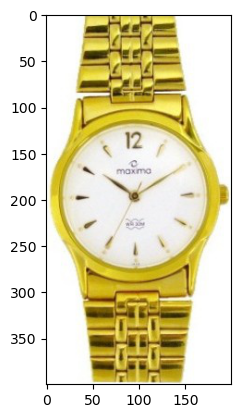

Home Decor & Festive Needs   : 


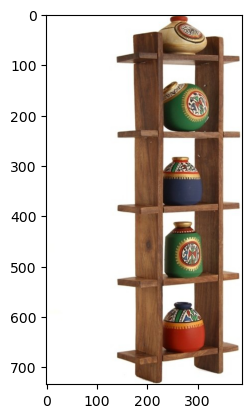

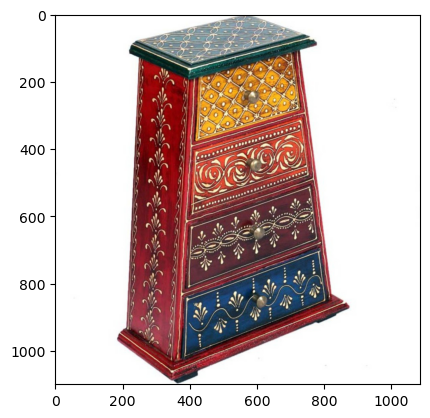

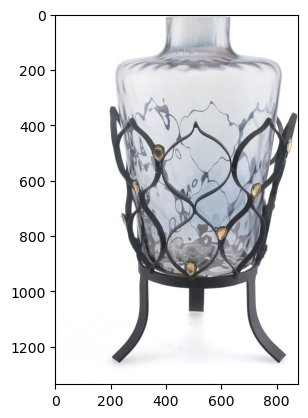

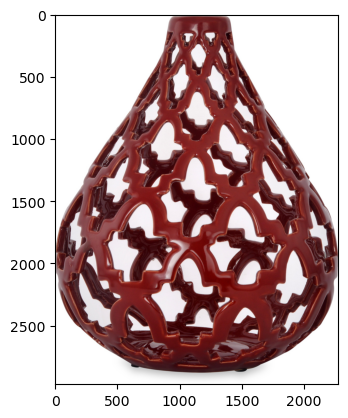

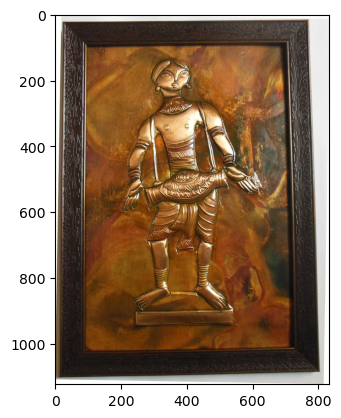

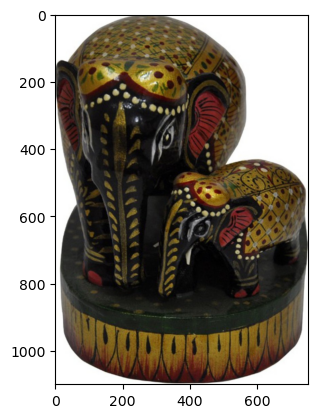

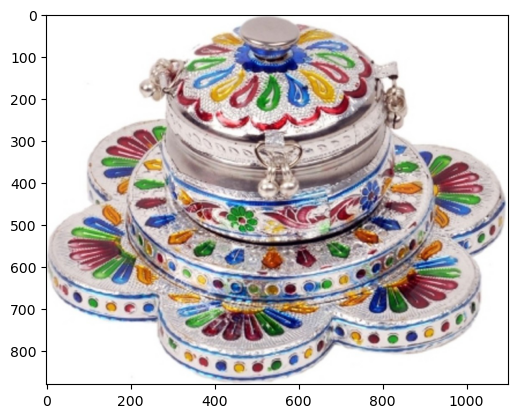

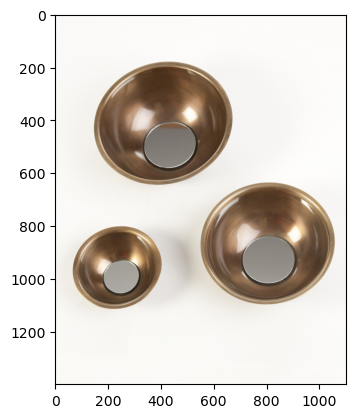

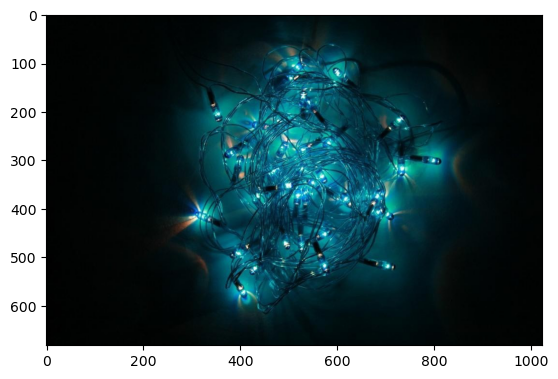

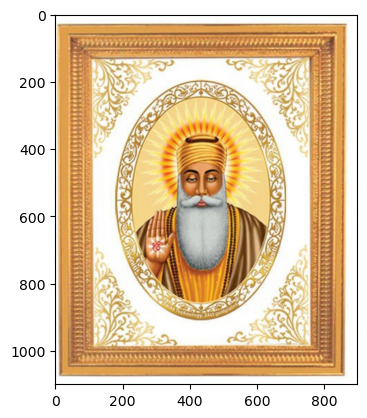

Kitchen & Dining   : 


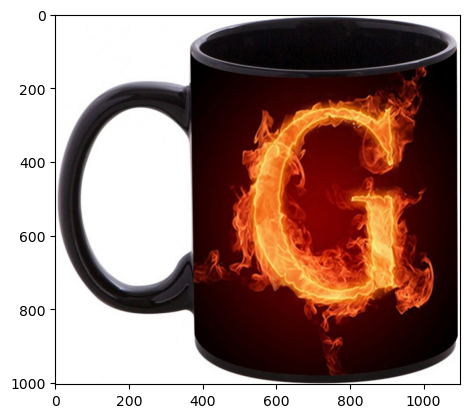

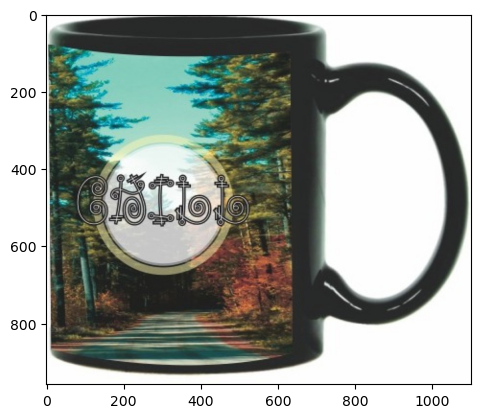

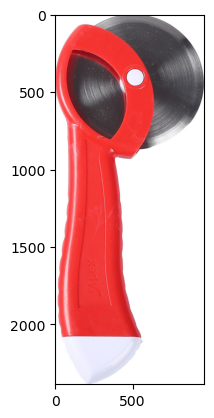

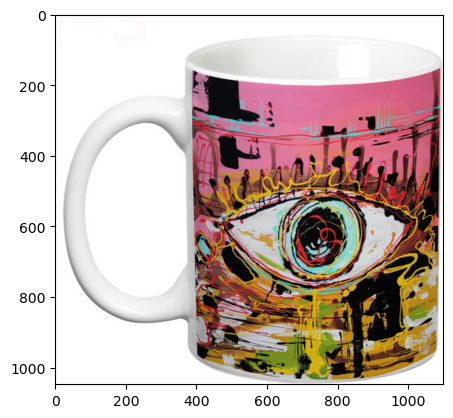

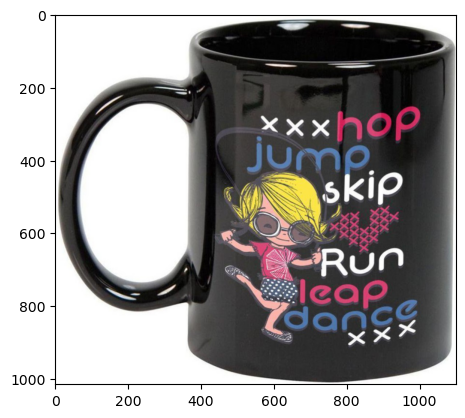

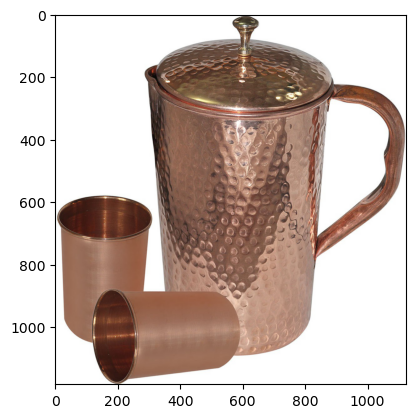

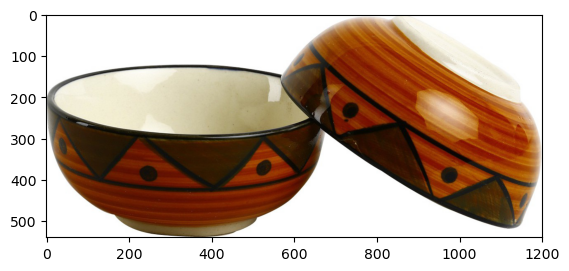

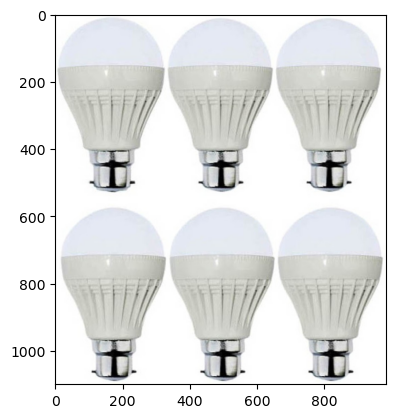

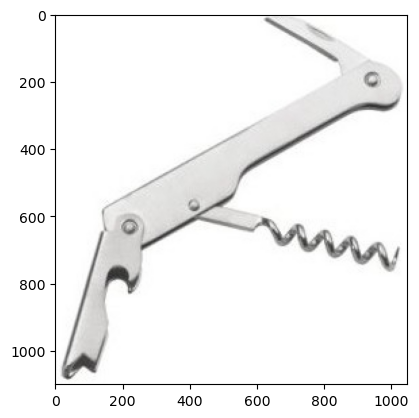

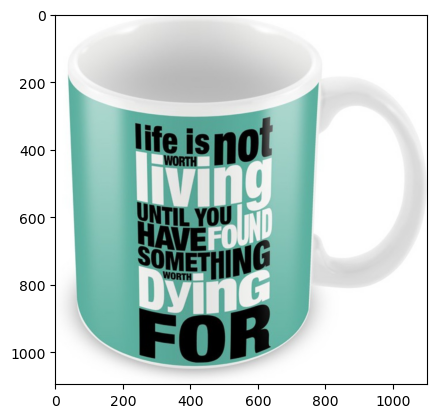

Beauty and Personal Care   : 


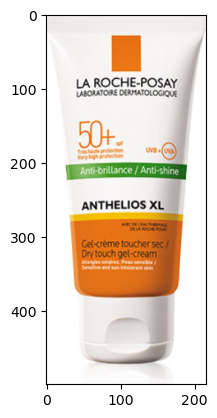

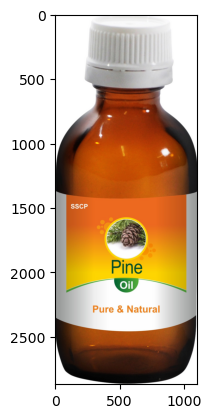

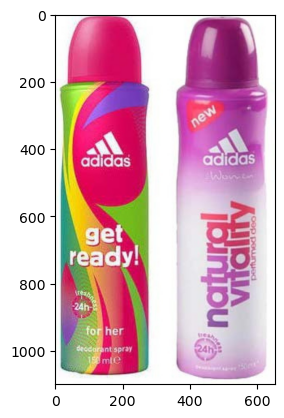

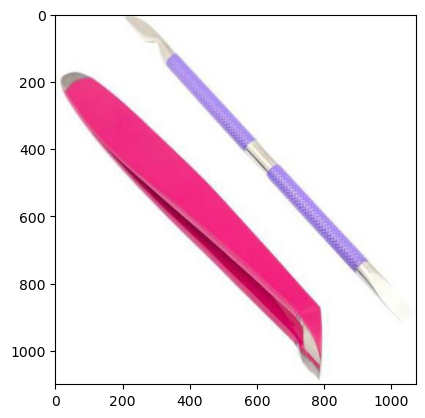

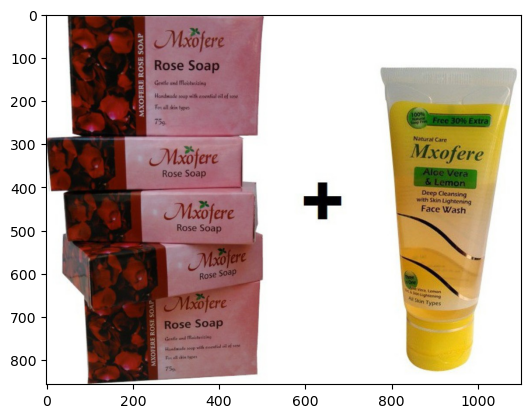

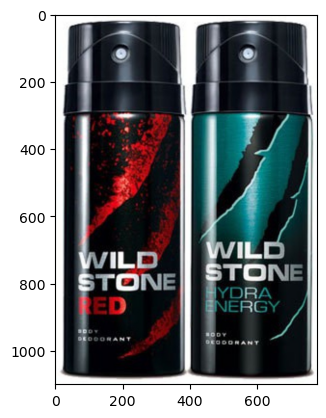

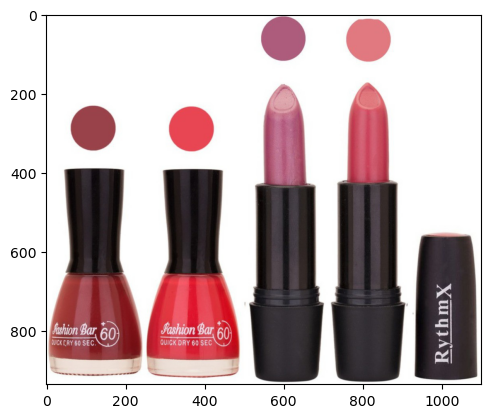

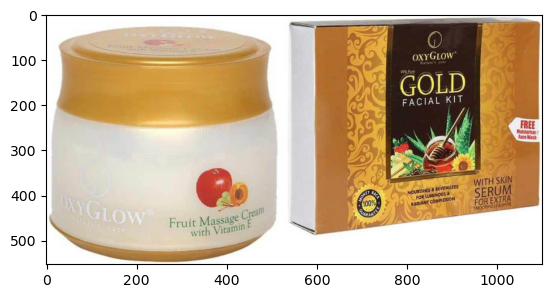

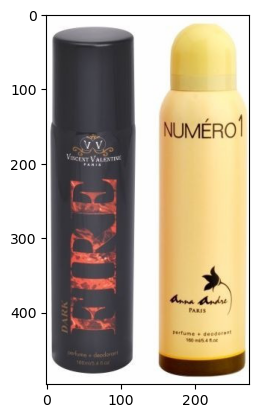

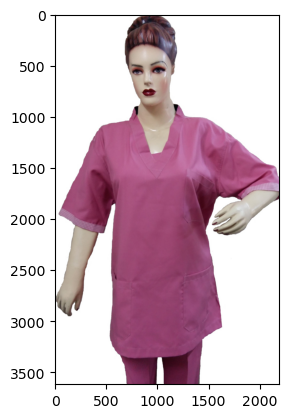

Computers   : 


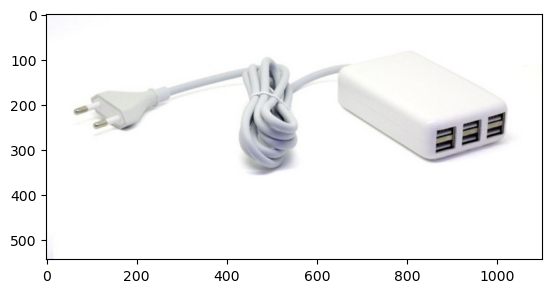

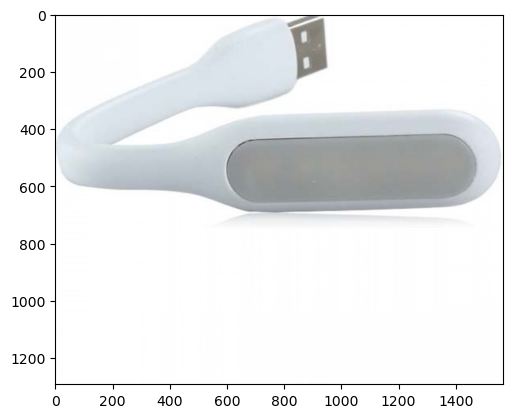

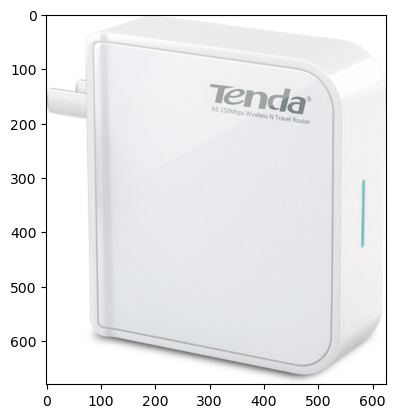

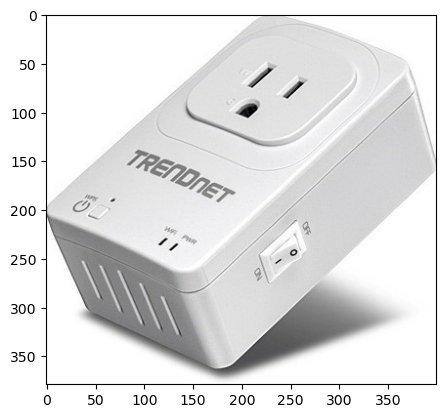

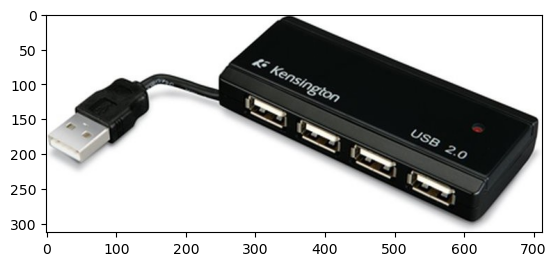

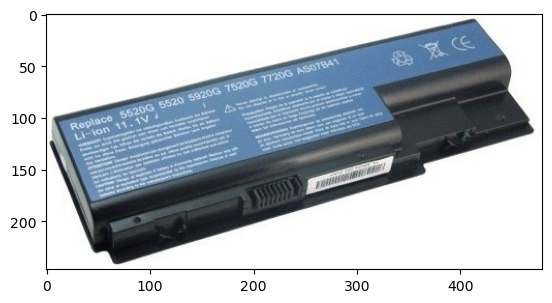

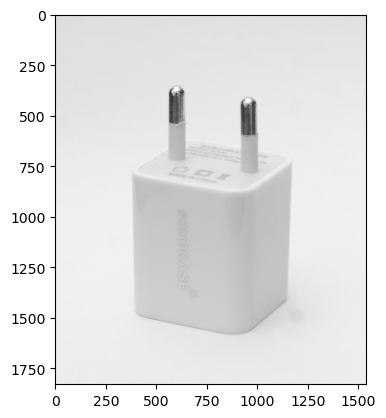

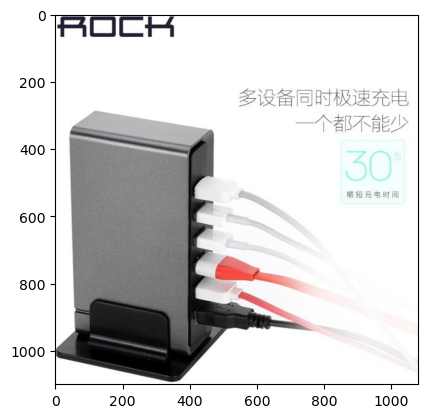

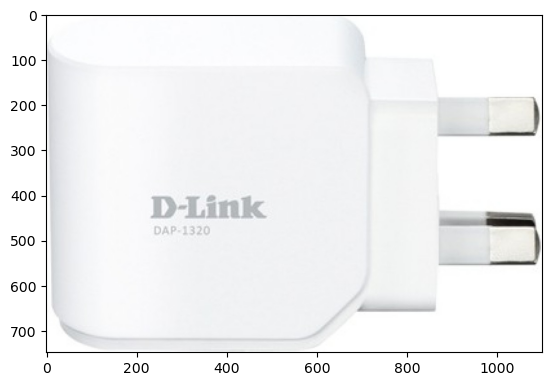

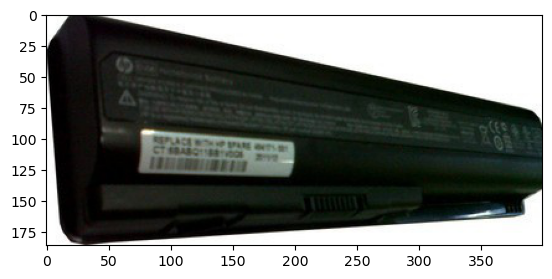

In [47]:
# Displaying the 10 images for each classe 1 categories
for classe in dataset["cat_classe_1"].unique():
    data_temp = dataset.loc[dataset['cat_classe_1'] == classe,:]
    print(classe, " : ")
    for image in data_temp['image'].sample(10):
        plt.style.use('default')
        pic = plt.imread(image)
        plt.imshow(pic)
        plt.show()

In [48]:
# Reminding the dataset columns
dataset.columns

Index(['image', 'product_category_tree', 'product_name', 'discounted_price',
       'description', 'cat_classe_1', 'cat_classe_2'],
      dtype='object')

In [49]:
# Limitimg the dataset to relevant variables for the classification
dataset = dataset[['image', 'description', 'cat_classe_1']]

In [50]:
# Saving the file
dataset.to_csv('dataset.csv', index=False)

# --- Part B : Classification of textual data --- #

# Part 4 : Pre-processing

In [51]:
# Importing of file
df = pd.read_csv("dataset.csv")

In [52]:
# Listig the classe 1 categories
l_cat = list(set(df['cat_classe_1']))
l_cat

['Home Furnishing ',
 'Kitchen & Dining ',
 'Baby Care ',
 'Beauty and Personal Care ',
 'Home Decor & Festive Needs ',
 'Watches ',
 'Computers ']

In [53]:
# Lsiting numerical target (categories classe 1)
y_cat_num = [(1-l_cat.index(df.iloc[i]['cat_classe_1'])) for i in range(len(df))]

# <a name="C4">Pre-processing with NLTK</a>

In [54]:
#Initialising terms
words = set(nltk.corpus.words.words())
stopwords = nltk.corpus.stopwords.words('english')
lemmatizer = WordNetLemmatizer()

In [55]:
# Different steps of standardisation and simplification applied to a description

desc = df['description'][0]

# Displaying initial description
print("Initial description : ",desc,"\n")

# Transforming to lowercase and removal punctuation 
desc_p1 = "".join([i.lower() for i in desc if i not in string.punctuation])
print("Description in lowercase and no punctuation : ",desc_p1,"\n")

# Removing the numbers
desc_p2 = ''.join(i for i in desc_p1 if not i.isdigit())
print("Description without numbers : ",desc_p2,"\n")

# Tokenising
tokens = nltk.tokenize.word_tokenize(desc_p2)
print("Description tokenised : ",tokens,"\n")
        
# Removing stopwords 
tokens_p1 = [w for w in tokens if w not in stopwords]
print("Description with no stop words : ",tokens_p1,"\n")
        
# Lemmatising
tokens_p2 = [lemmatizer.lemmatize(lemmatizer.lemmatize(lemmatizer.lemmatize(w, 'a'),'v'),'n') for w in tokens_p1]
print("Description lemmatised : ",tokens_p2,"\n")

# Removing words with less than 3 letters
tokens_p3 = [w for w in tokens_p2 if len(w) > 3]
print("Description with no words shorter than 3 letters : ",tokens_p3,"\n")

print("Final Description: ", " ".join(tokens_p3),"\n")

Initial description :  Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in

In [56]:
# Comparing before and after pre-processing with NLTK
desc = df['description'][0]
print('Sentence : '+desc, '\n')
print('Pre-processed sentence : '+pretraitement_nltk(desc))

Sentence : Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room s

In [57]:
#Creating a new feature/variable description with the preprocessed nltk description
df['description_nltk'] = df.description.apply(lambda x: pretraitement_nltk(x))

In [58]:
# Visualising updated feature
print(df['description_nltk'][0])

feature elegance polyester multicolor abstract eyelet door curtain floral curtainelegance polyester multicolor abstract eyelet door curtain height pack price curtain enhance look interiorsthis curtain make high quality polyester fabricit feature eyelet style stitch metal ringit make room environment romantic lovingthis curtain wrinkle anti shrinkage elegant apparancegive home bright modernistic appeal design surreal attention sure steal heart contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright want wish good morning whole world draw close even create special moment joyous beauty give soothe print bring home elegant curtain softly filter light room right amount sunlightspecifications elegance polyester multicolor abstract eyelet door curtain height pack general brand elegance design door type eyelet model name abstract polyester door curtain model duster color multicolor dimension length number content sale package pack sale package curtain b

In [59]:
# Merging all descriptions
corpus = ' '.join(df['description_nltk'])
corpus_old = ' '.join(df['description'])

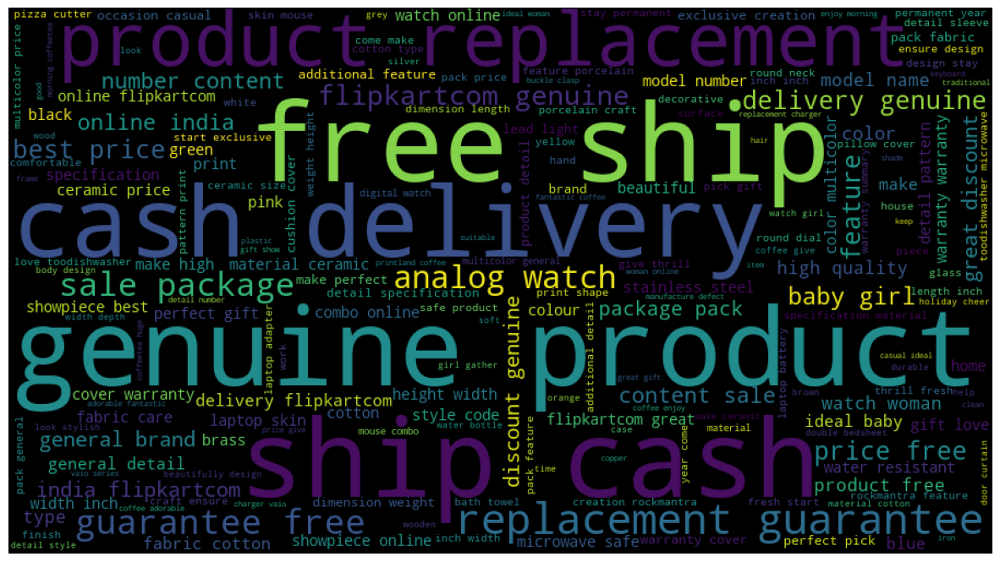

In [60]:
# Displaying Wordcloud global to see most frequent words
plt.figure(figsize=(15, 12))
cloud = WordCloud(width=900, height=500,random_state=10, max_font_size=100).generate(corpus)
plt.imshow(cloud)
plt.axis('off')
plt.show()

Home Furnishing   : 


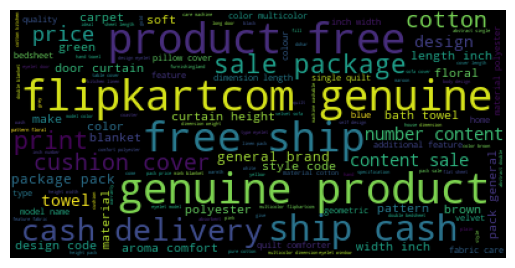

Baby Care   : 


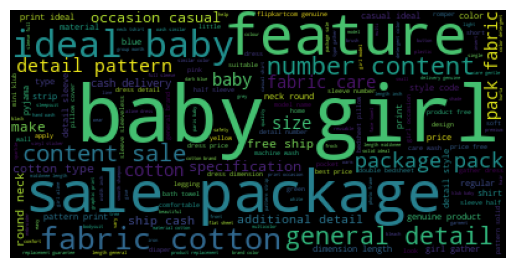

Watches   : 


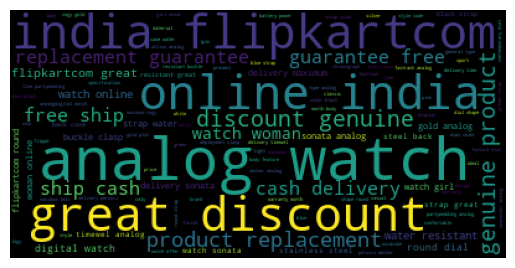

Home Decor & Festive Needs   : 


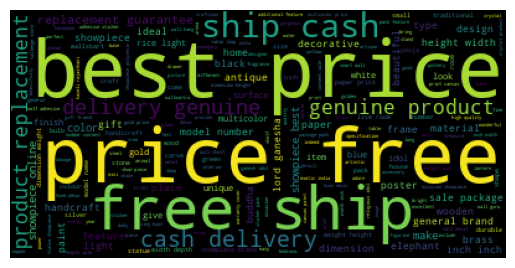

Kitchen & Dining   : 


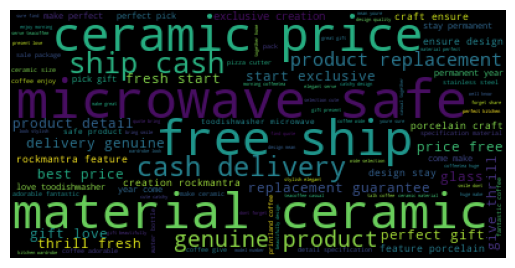

Beauty and Personal Care   : 


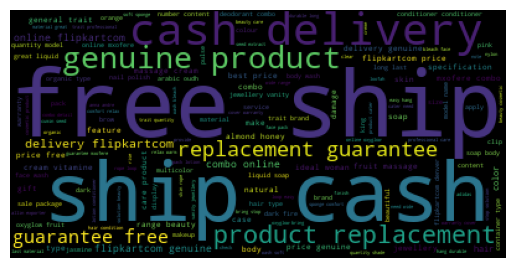

Computers   : 


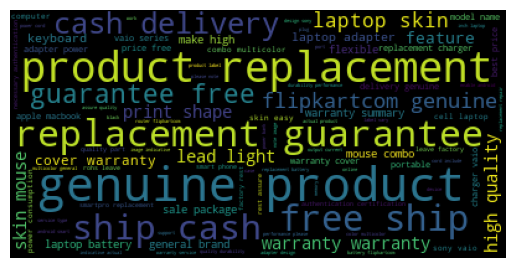

In [61]:
# Displaying Wordcloud per class 1 category
for classe in df["cat_classe_1"].unique():
    df_temp = df.loc[df['cat_classe_1'] == classe,:]
    corpus_c = ' '.join(df_temp['description_nltk'])
    cloud = WordCloud().generate(corpus_c)
    print(classe, " : ")
    plt.imshow(cloud)
    plt.axis('off')
    plt.show()

In [62]:
# Comparing nb of tokens before and after pre-processing
tokens = corpus.split()
tokens_old = corpus_old.split()
counts = Counter(tokens)
counts_old = Counter(tokens_old)
print('Nb of tokens: ', len(counts_old))
print('Nb of tokens after pre-processing: ', len(counts))

Nb of tokens:  9591
Nb of tokens after pre-processing:  4335


Text(0.5, 1.0, '10 most common words in the initial corpus')

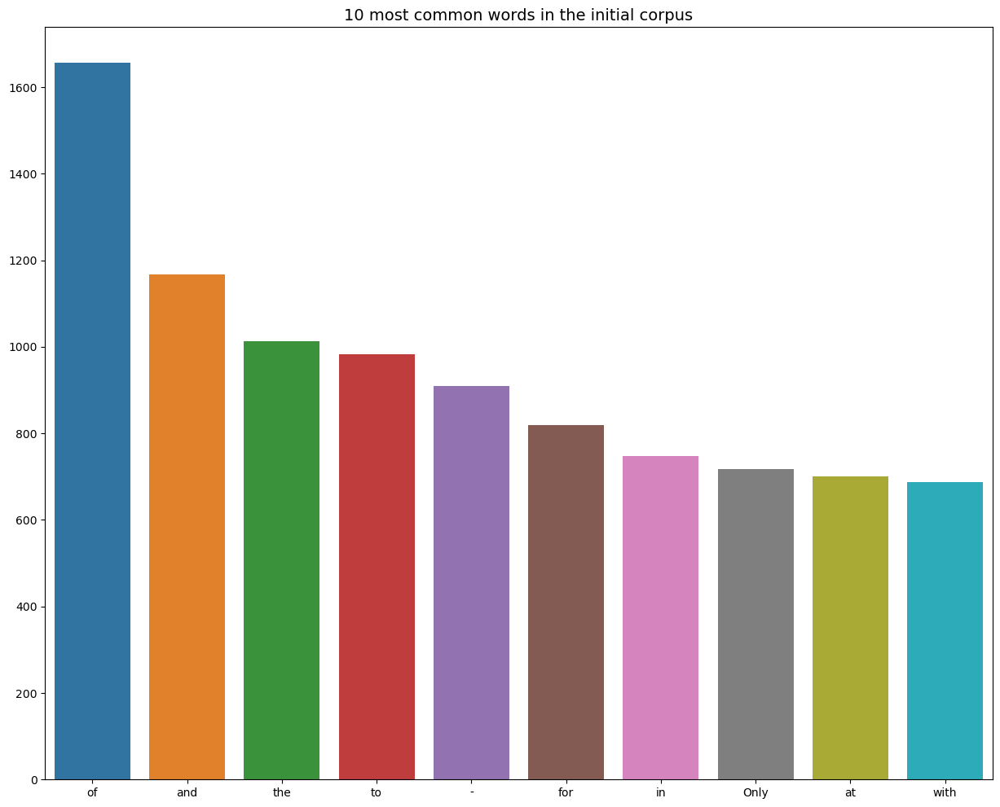

In [63]:
# Displaying the 10 most frequent tokens before pre-processing
common_words = [word[0] for word in counts_old.most_common(10)]
common_counts = [word[1] for word in counts_old.most_common(10)]

plt.figure(figsize=(15, 12))
sns.barplot(x=common_words, y=common_counts)
plt.title("10 most common words in the initial corpus", size=14)

Text(0.5, 1.0, '10 most common words in the pre-processed corpus')

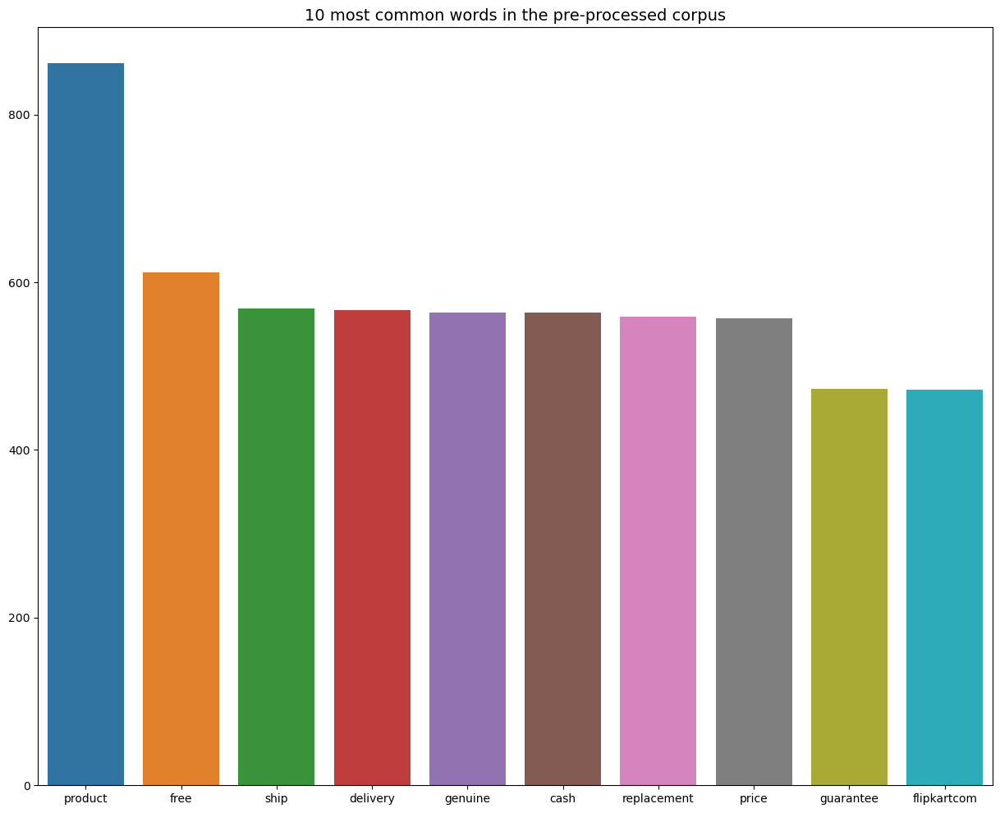

In [64]:
# Displaying the 10 most frequent tokens after pre-processing
common_words = [word[0] for word in counts.most_common(10)]
common_counts = [word[1] for word in counts.most_common(10)]

plt.figure(figsize=(15, 12))
sns.barplot(x=common_words, y=common_counts)
plt.title("10 most common words in the pre-processed corpus", size=14)

Home Furnishing   : 


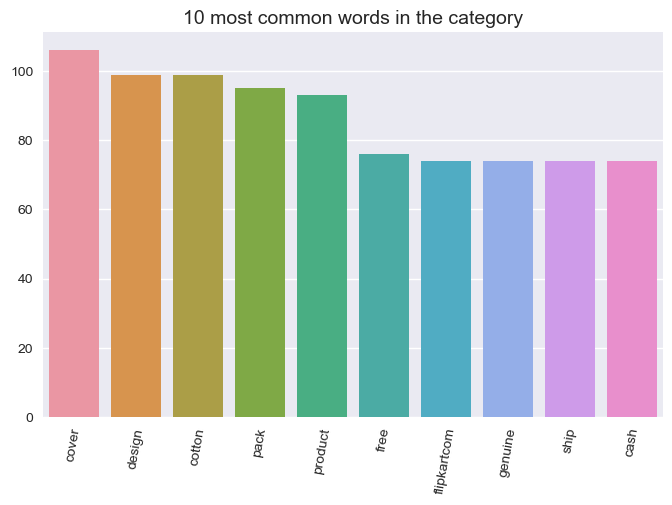

Baby Care   : 


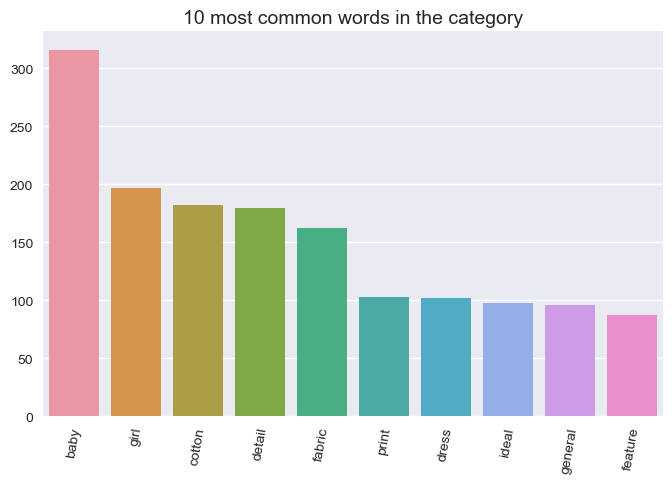

Watches   : 


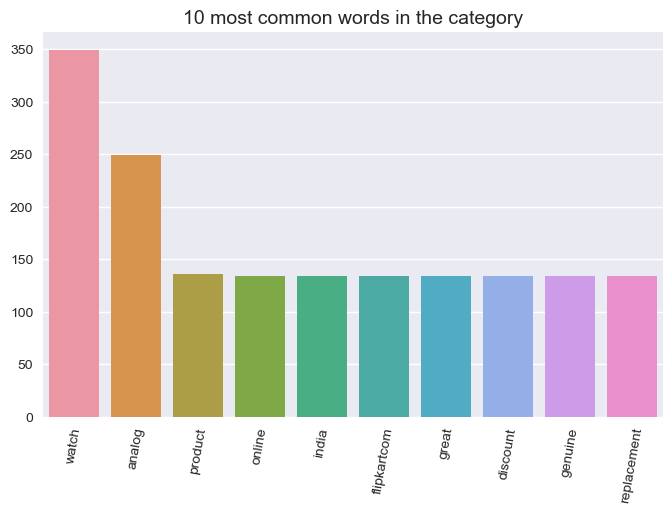

Home Decor & Festive Needs   : 


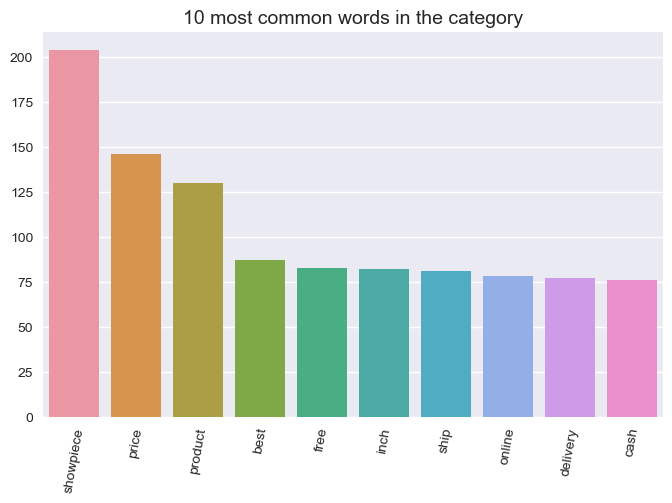

Kitchen & Dining   : 


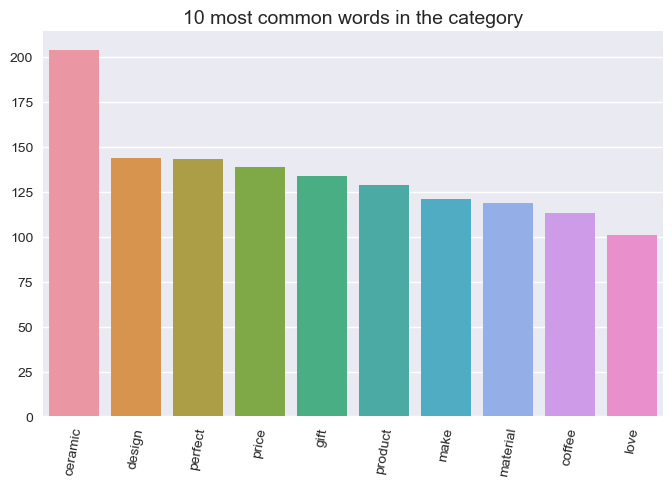

Beauty and Personal Care   : 


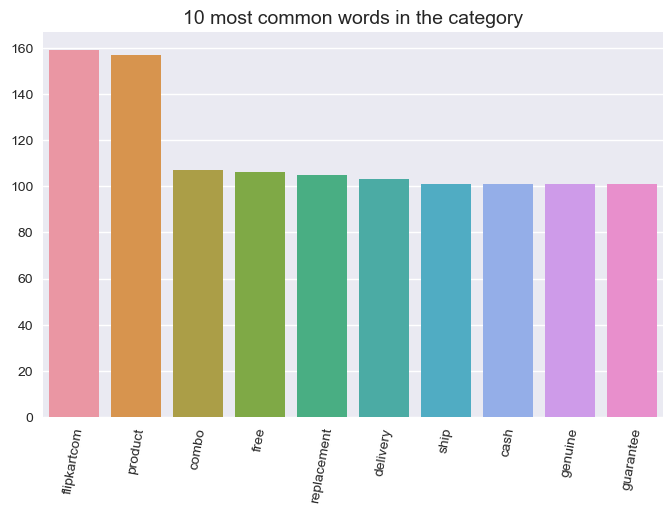

Computers   : 


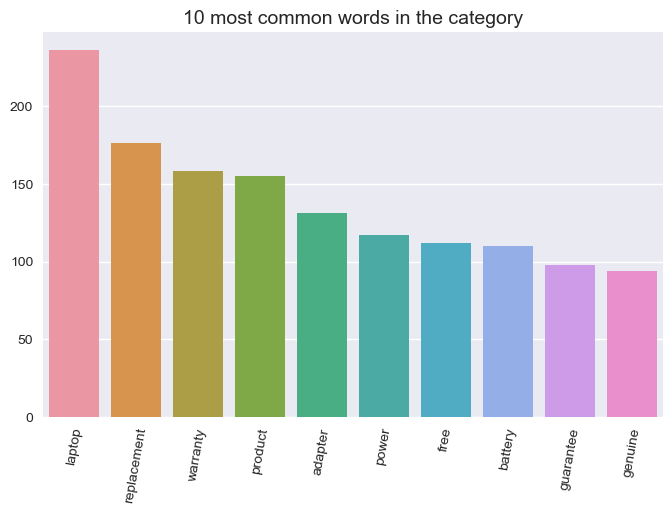

In [65]:
# Displaying 10 most present tokens after pre-processing, by category
for classe in df["cat_classe_1"].unique():
    df_temp = df.loc[df['cat_classe_1'] == classe,:]
    corpus_c = ' '.join(df_temp['description_nltk'])
    tokens_c = corpus_c.split()
    counts_c = Counter(tokens_c)
    common_words = [word[0] for word in counts_c.most_common(10)]
    common_counts = [word[1] for word in counts_c.most_common(10)]
    print(classe, " : ")
    plt.style.use('seaborn')
    plt.figure(figsize=(8, 5))
    plt.xticks(rotation=80)
    sns.barplot(x=common_words, y=common_counts)
    plt.title("10 most common words in the category", size=14)
    plt.show()

In [66]:
# Listing tokens present once in the pre-processed feature
one_occ_token=[]
for i in tokens:
    if  tokens.count(i)<2 and i not in one_occ_token:
        one_occ_token.append(i)
one_occ_token

['curtainelegance',
 'interiorsthis',
 'fabricit',
 'ringit',
 'romantic',
 'lovingthis',
 'wrinkle',
 'apparancegive',
 'modernistic',
 'surreal',
 'steal',
 'valance',
 'joyous',
 'softly',
 'sunlightspecifications',
 'duster',
 'asvtwl',
 'mediam',
 'enrich',
 'renowned',
 'susceptible',
 'cmsspecifications',
 'shuvam',
 'perfact',
 'giftingspecifications',
 'goldbedi',
 'cottonjaipur',
 'lifespecifications',
 'onle',
 'ufttswbkbr',
 'reminder',
 'hijri',
 'gregorian',
 'calnedars',
 'quran',
 'bookmark',
 'alrams',
 'swissmade',
 'sapphire',
 'metre',
 'megnet',
 'arrival',
 'girlswatch',
 'eblk',
 'hybrid',
 'sporty',
 'analogue',
 'calculation',
 'vizion',
 'cmsantosh',
 'oodles',
 'excite',
 'furniture',
 'kitchenware',
 'pricesspecifications',
 'dsnsan',
 'outerinner',
 'thrade',
 'coverspecifications',
 'dcosmart',
 'stripeblack',
 'riva',
 'shag',
 'bathmatri',
 'freshener',
 'inchescapacity',
 'gramsdungri',
 'southampton',
 'mrsa',
 'remain',
 'alive',
 'three',
 'prefer',


In [67]:
# Comparing before and after removal of toekns present once in pre-processed feature
desc = df['description_nltk'][0]
print('Pre-processed sentence : '+desc, '\n')
print('Sentences without unique occurence : '+pas_une_occ(desc,one_occ_token))

Pre-processed sentence : feature elegance polyester multicolor abstract eyelet door curtain floral curtainelegance polyester multicolor abstract eyelet door curtain height pack price curtain enhance look interiorsthis curtain make high quality polyester fabricit feature eyelet style stitch metal ringit make room environment romantic lovingthis curtain wrinkle anti shrinkage elegant apparancegive home bright modernistic appeal design surreal attention sure steal heart contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright want wish good morning whole world draw close even create special moment joyous beauty give soothe print bring home elegant curtain softly filter light room right amount sunlightspecifications elegance polyester multicolor abstract eyelet door curtain height pack general brand elegance design door type eyelet model name abstract polyester door curtain model duster color multicolor dimension length number content sale package pa

In [68]:
# Updating feature description with the description without unique occurence
df['description_nltk'] = df.description_nltk.apply(lambda x: pas_une_occ(x,one_occ_token))

In [69]:
# Visualisinf updated feature
print(df['description_nltk'][0])

feature elegance polyester multicolor abstract eyelet door curtain floral polyester multicolor abstract eyelet door curtain height pack price curtain enhance look curtain make high quality polyester feature eyelet style stitch metal make room environment curtain anti shrinkage elegant home bright appeal design attention sure heart contemporary eyelet curtain slide smoothly draw apart first thing morning welcome bright want wish good morning whole world draw close even create special moment beauty give soothe print bring home elegant curtain filter light room right amount elegance polyester multicolor abstract eyelet door curtain height pack general brand elegance design door type eyelet model name abstract polyester door curtain model color multicolor dimension length number content sale package pack sale package curtain body design material polyester


In [70]:
# Comparing number of tokens before and after final pre-processing 
corpus = ' '.join(df['description_nltk'])
corpus_old = ' '.join(df['description'])
tokens = corpus.split()
tokens_old = corpus_old.split()
counts = Counter(tokens)
counts_old = Counter(tokens_old)
print('Nb of tokens : ', len(counts_old))
print('Nb of tokens after final pre-processing : ', len(counts))

Nb of tokens :  9591
Nb of tokens after final pre-processing :  2871


In [71]:
# Creating the dataset nltk
df_nltk = df[['description_nltk','cat_classe_1']].copy()

In [72]:
# Displaying the dataset nltk
df_nltk.head()

,description_nltk,cat_classe_1
0,feature elegance polyester multicolor abstract...,Home Furnishing
1,specification sathiyas cotton bath towel bath ...,Baby Care
2,feature eurospa cotton terry face towel size s...,Baby Care
3,feature santosh royal fashion cotton print kin...,Home Furnishing
4,feature jaipur print cotton floral king size d...,Home Furnishing


# <a name="C5">Pre-processing with Spacy</a>

In [73]:
# Comparing before and after pre-processing with spacy 
desc = df['description'][0]
print('Sentence : '+desc, '\n')
print('Preprocessed sentence : '+pretraitement_spacy(desc))

Phrase de base : Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your 

In [74]:
# Updating feature description with description pre-processed with spacy
df['description_spacy'] = df.description.apply(lambda x: pretraitement_spacy(x))

In [75]:
# Visualising updated feature
print(df['description_spacy'][0])

['feature', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'price', 'curtain', 'enhance', 'look', 'curtain', 'make', 'high', 'quality', 'polyester', 'feature', 'eyelet', 'style', 'stitch', 'metal', 'ring.it', 'make', 'room', 'environment', 'romantic', 'curtain', 'wrinkle', 'anti', 'shrinkage', 'elegant', 'apparance.give', 'home', 'bright', 'modernistic', 'appeal', 'design', 'surreal', 'attention', 'sure', 'steal', 'heart', 'contemporary', 'eyelet', 'valance', 'curtain', 'slide', 'draw', 'first', 'thing', 'morning', 'welcome', 'bright', 'want', 'wish', 'good', 'morning', 'whole', 'world', 'draw', 'evening', 'create', 'special', 'moment', 'joyous', 'beauty', 'give', 'soothe', 'print', 'bring', 'elegant', 'curtain', 'filter', 'light', 'room', 'right', 'amount', 'sunlight', ',specification', 'elegance', 'polyester', 'multicolor', 'abstract'

In [76]:
# Merging all descriptions 
corpus = ''.join(df['description_spacy'])
corpus_old = ' '.join(df['description'])

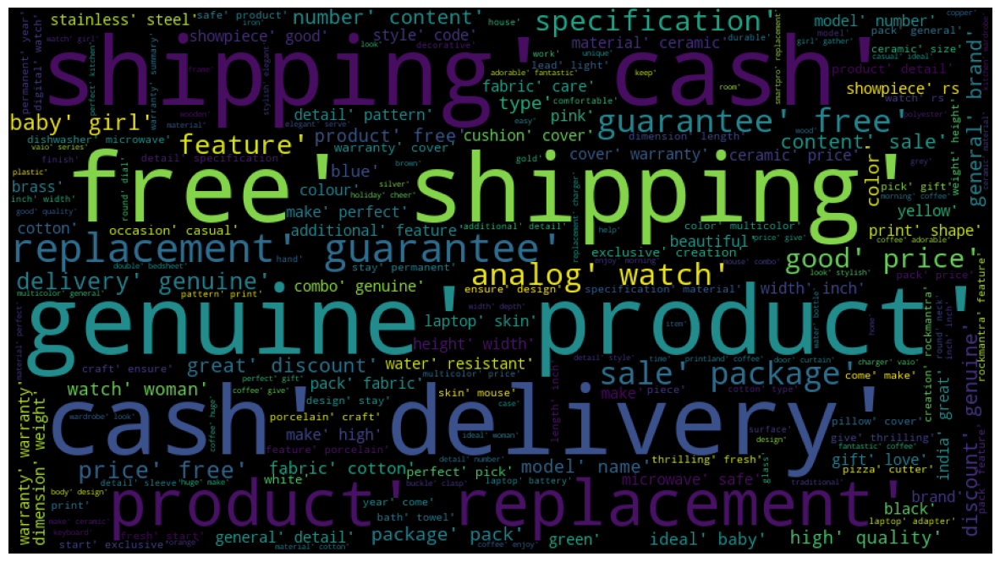

In [77]:
# Wordcloud global
plt.figure(figsize=(15, 12))
cloud = WordCloud(width=900, height=500,random_state=10, max_font_size=100).generate(corpus)
plt.imshow(cloud)
plt.axis('off')
plt.show()

Home Furnishing   : 


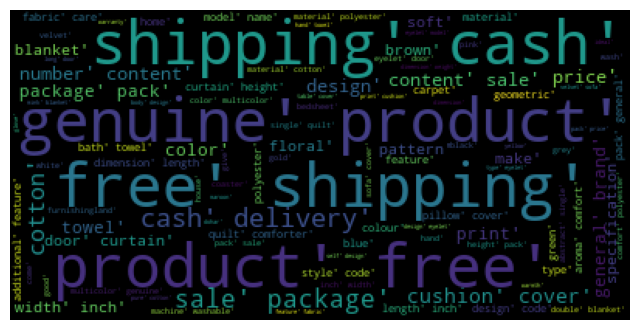

Baby Care   : 


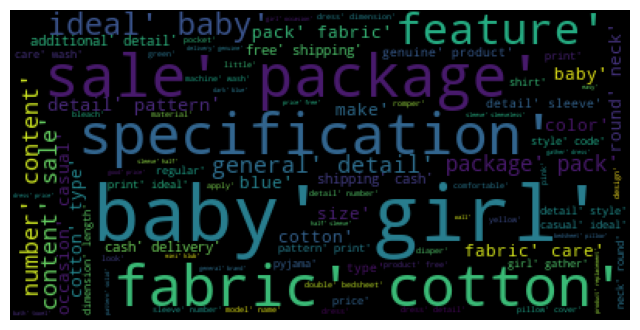

Watches   : 


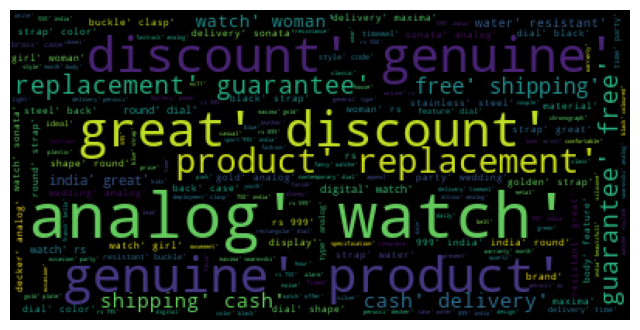

Home Decor & Festive Needs   : 


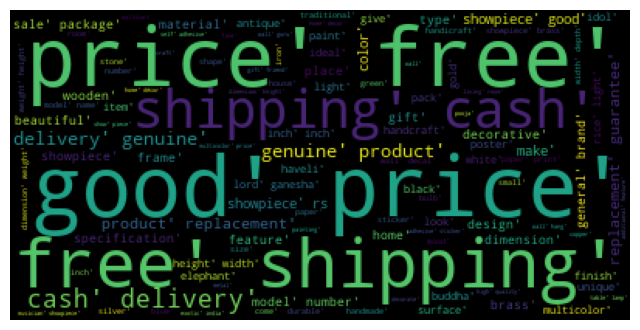

Kitchen & Dining   : 


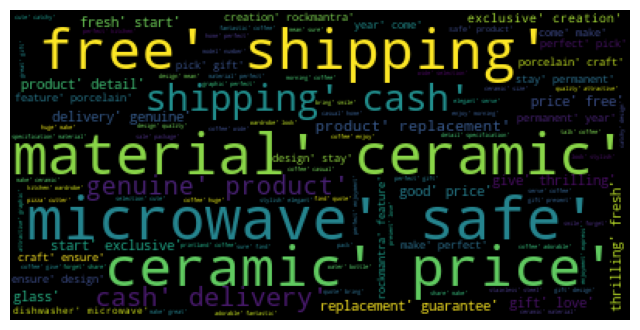

Beauty and Personal Care   : 


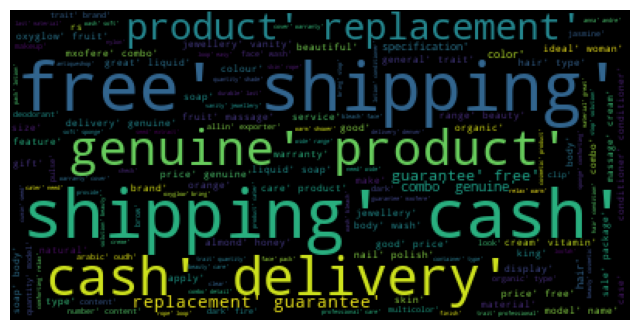

Computers   : 


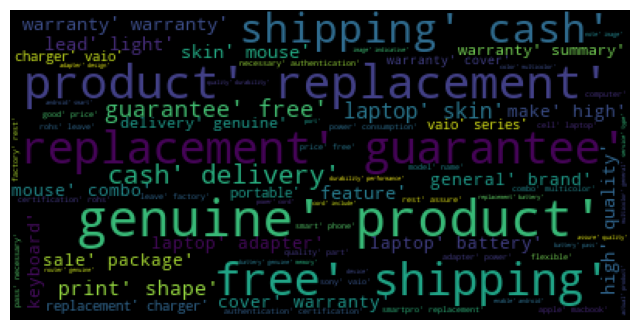

In [78]:
# Wordcloud by category
for classe in df["cat_classe_1"].unique():
    df_temp = df.loc[df['cat_classe_1'] == classe,:]
    corpus_c = ' '.join(df_temp['description_spacy'])
    cloud = WordCloud().generate(corpus_c)
    print(classe, " : ")
    plt.imshow(cloud)
    plt.axis('off')
    plt.show()

In [79]:
# Comparing the number of tokens before and after pre-processing
tokens = corpus.split()
tokens_old = corpus_old.split()
counts = Counter(tokens)
counts_old = Counter(tokens_old)
print('Nb of tokens : ', len(counts_old))
print('Nb of tokens after pre-processing : ', len(counts))

Nb of tokens :  9591
Nb of tokens after pre-processing :  4762


Text(0.5, 1.0, '10 most common words in the initial corpus')

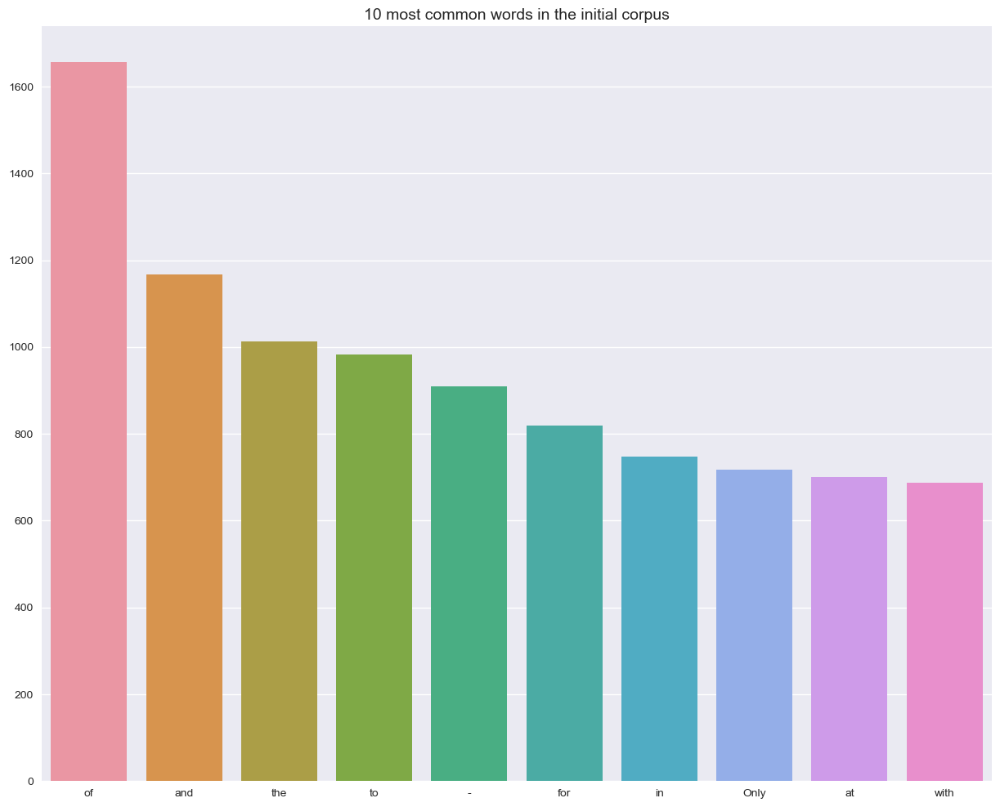

In [80]:
# Visualising 10 most common tokens after pre-processing
common_words = [word[0] for word in counts_old.most_common(10)]
common_counts = [word[1] for word in counts_old.most_common(10)]

plt.figure(figsize=(15, 12))
sns.barplot(x=common_words, y=common_counts)
plt.title("10 most common words in the initial corpus", size=14)

Text(0.5, 1.0, '10 most commun words in the pre-processed corpus')

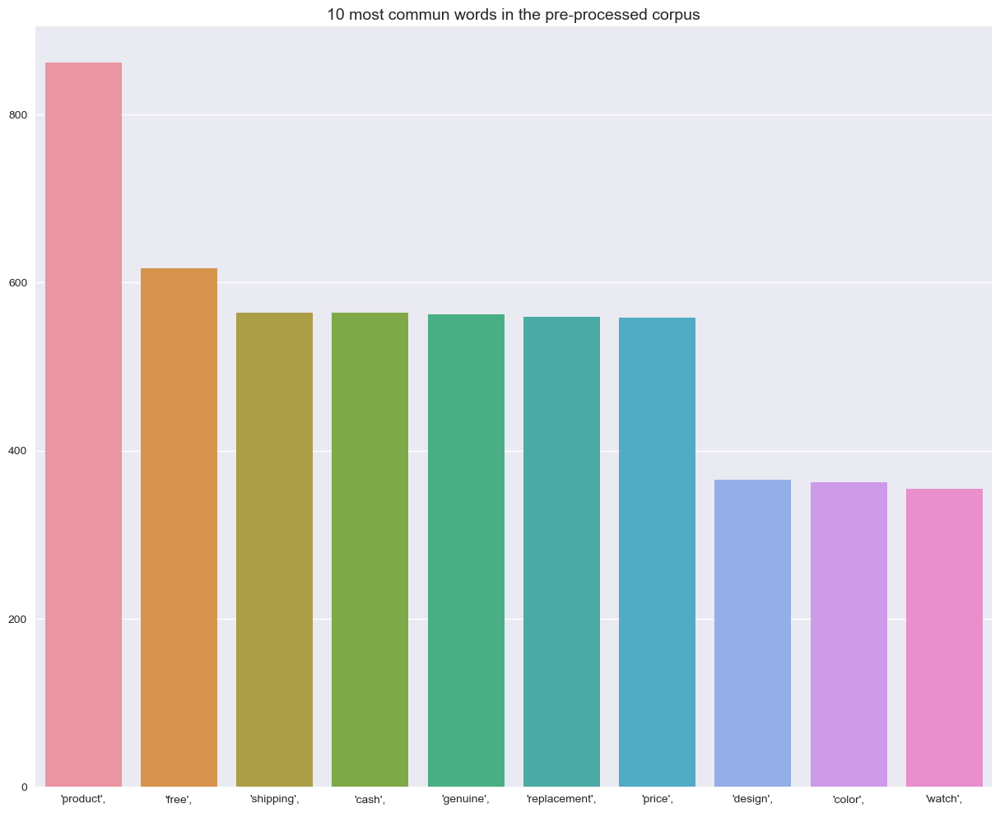

In [81]:
# Visualising 10 most common tokens after pre-processing
common_words = [word[0] for word in counts.most_common(10)]
common_counts = [word[1] for word in counts.most_common(10)]

plt.figure(figsize=(15, 12))
sns.barplot(x=common_words, y=common_counts)
plt.title("10 most commun words in the pre-processed corpus", size=14)

Home Furnishing   : 


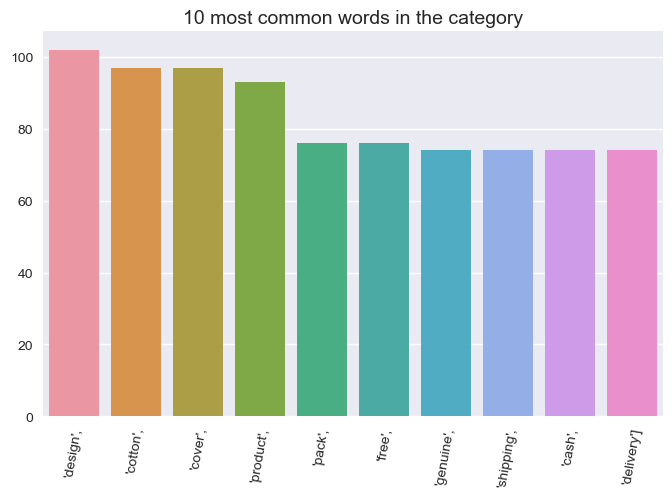

Baby Care   : 


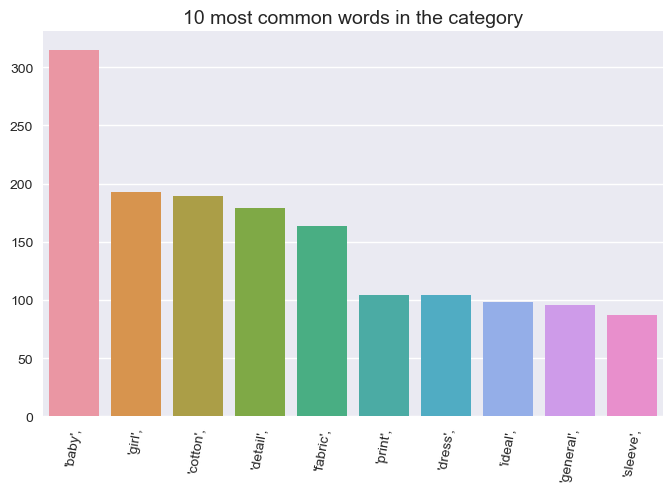

Watches   : 


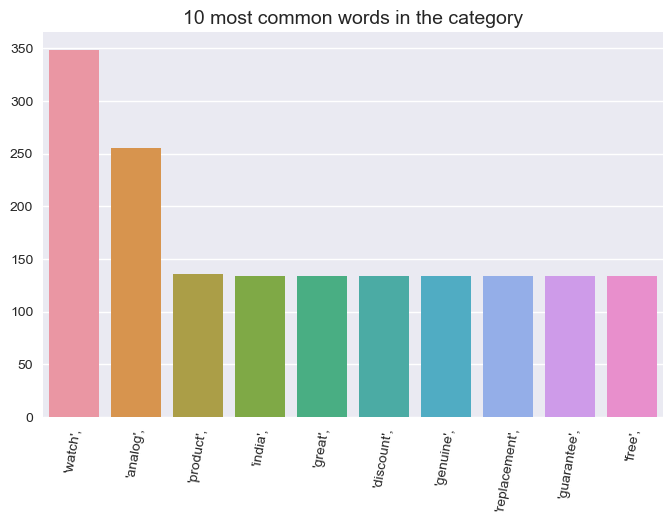

Home Decor & Festive Needs   : 


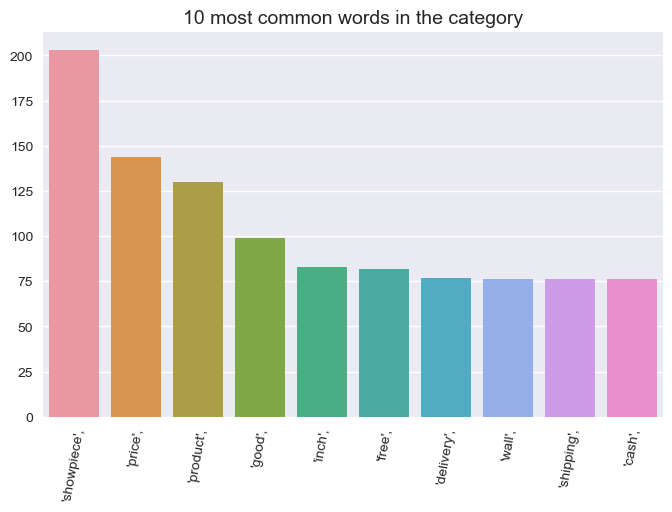

Kitchen & Dining   : 


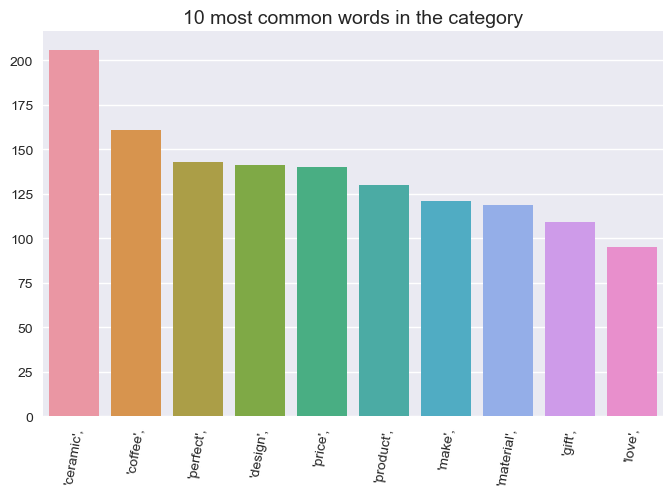

Beauty and Personal Care   : 


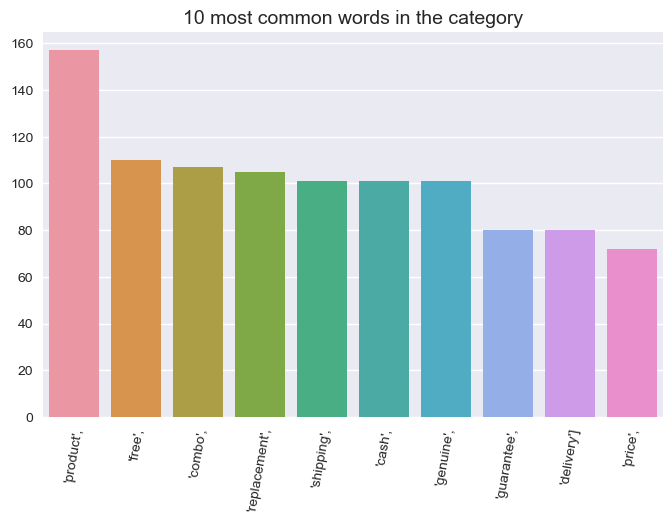

Computers   : 


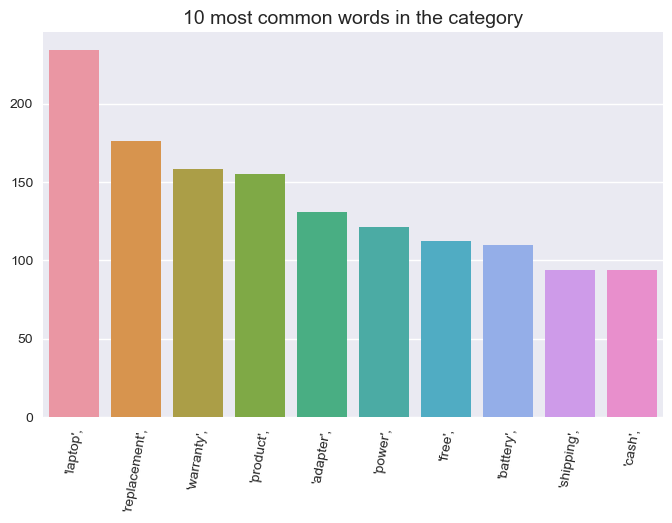

In [82]:
# Visualising 10 most common tokens after pre-processing, by category
for classe in df["cat_classe_1"].unique():
    df_temp = df.loc[df['cat_classe_1'] == classe,:]
    corpus_c = ' '.join(df_temp['description_spacy'])
    tokens_c = corpus_c.split()
    counts_c = Counter(tokens_c)
    common_words = [word[0] for word in counts_c.most_common(10)]
    common_counts = [word[1] for word in counts_c.most_common(10)]
    print(classe, " : ")
    plt.style.use('seaborn')
    plt.figure(figsize=(8, 5))
    plt.xticks(rotation=80)
    sns.barplot(x=common_words, y=common_counts)
    plt.title("10 most common words in the category", size=14)
    plt.show()

In [83]:
# Listing tokens present once in pre-processed feature
one_occ_token=[]
for i in tokens:
    if  tokens.count(i)<2 and i not in one_occ_token:
        one_occ_token.append(i)
one_occ_token

["['feature',",
 "'ring.it',",
 "'romantic',",
 "'apparance.give',",
 "'modernistic',",
 "'surreal',",
 "'steal',",
 "'valance',",
 "'joyous',",
 "'duster25',",
 "'asvtwl322',",
 "'mediam',",
 "'enriched',",
 "'feeling',",
 "'renowned',",
 "'susceptible',",
 "'size-',",
 "'shuvam',",
 "'perfact',",
 "'goldbedi-38',",
 "'machinewash',",
 "'onle',",
 "'cover']['maserati',",
 "'maserati',",
 "'rs.24400',",
 "'delivery']['camerii',",
 "'camerii',",
 "'delivery']['star',",
 "'tsw-005',",
 "'rest']['wy16b',",
 "'rs.4995',",
 "'reminder',",
 "'hijri',",
 "'gregorian',",
 "'calnedar',",
 '"qur\'an",',
 "'bookmark',",
 "'alram',",
 "'delivery']['heuer',",
 "'heuer',",
 "'sapphire',",
 "'metre',",
 "'delivery']['calibro',",
 "'matter',",
 "'matter']['cartier',",
 "'cartier',",
 "'delivery']['lois',",
 "'lois',",
 "'delivery']['titan',",
 "'titan',",
 "'delivery']['srushti',",
 "'megnet_led_sport_blackred1',",
 "'rs.200',",
 "'megnet',",
 "'arrival',",
 "'girlswatch',",
 "'delivery']['escort',",


In [84]:
# Comparing before and after removal of tokens present once in pre-processed feature
desc = df['description_spacy'][0]
print('Preprocessed sentence : '+desc, '\n')
print('Sentence with no unique occurence : '+pas_une_occ(desc,one_occ_token))

Phrase prétraitée : ['feature', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'price', 'curtain', 'enhance', 'look', 'curtain', 'make', 'high', 'quality', 'polyester', 'feature', 'eyelet', 'style', 'stitch', 'metal', 'ring.it', 'make', 'room', 'environment', 'romantic', 'curtain', 'wrinkle', 'anti', 'shrinkage', 'elegant', 'apparance.give', 'home', 'bright', 'modernistic', 'appeal', 'design', 'surreal', 'attention', 'sure', 'steal', 'heart', 'contemporary', 'eyelet', 'valance', 'curtain', 'slide', 'draw', 'first', 'thing', 'morning', 'welcome', 'bright', 'want', 'wish', 'good', 'morning', 'whole', 'world', 'draw', 'evening', 'create', 'special', 'moment', 'joyous', 'beauty', 'give', 'soothe', 'print', 'bring', 'elegant', 'curtain', 'filter', 'light', 'room', 'right', 'amount', 'sunlight', ',specification', 'elegance', 'polyester', 'mul

In [85]:
# Updating feature description with the description without unique occurence
df['description_spacy'] = df.description_spacy.apply(lambda x: pas_une_occ(x,one_occ_token))

In [86]:
# Comparing number of tokens before and after final pre-processing
corpus = ' '.join(df['description_spacy'])
corpus_old = ' '.join(df['description'])
tokens = corpus.split()
tokens_old = corpus_old.split()
counts = Counter(tokens)
counts_old = Counter(tokens_old)
print('Nb of tokens : ', len(counts_old))
print('Nb of tokens after final preprocessing : ', len(counts))

Nombre de tokens de base :  9591
Nombre de tokens après prétraitement final :  4277


In [87]:
# Creating a spacy dataset
df_sp = df[['description_spacy','cat_classe_1']]
df_sp.head()

,description_spacy,cat_classe_1
0,"[ 'feature ' , 'elegance ' , 'polyester ' , 'm...",Home Furnishing
1,"[ 'specification ' , 'sathiyas ' , 'cotton ' ,...",Baby Care
2,"[ 'feature ' , 'eurospa ' , 'cotton ' , 'terry...",Baby Care
3,"[ 'feature ' , 'santosh ' , 'royal ' , 'fashio...",Home Furnishing
4,"[ 'feature ' , 'jaipur ' , 'print ' , 'cotton ...",Home Furnishing


# Part 4 : Features Extraction

# <a name="C6">Method BoW - CV</a>

In [88]:
# Vectorising in BagofWords CV
vectorizer_cv = CountVectorizer()

In [89]:
# Transforming dataset with NLTK
features_NL_CV = encode_df(df_nltk.description_nltk, vectorizer_cv)
features_NL_CV.shape

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


(1050, 2872)

In [90]:
# Transforming dataset with Spacy
features_SP_CV = encode_df(df_sp.description_spacy, vectorizer_cv)
features_SP_CV.shape

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


(1050, 4245)

# <a name="C7">Method BoW - TF_IDF</a>

In [91]:
# Vectorising in TF-IDF 
vectorizer_tfidf = TfidfVectorizer(stop_words='english', analyzer='word')

In [92]:
# Transforming dataset with NLTK
features_NL_TF = encode_df(df_nltk.description_nltk, vectorizer_tfidf)
features_NL_TF.shape

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


(1050, 2796)

In [93]:
# Observing most common bigrams in all dataset
vectorizer_tfidf2 = TfidfVectorizer(ngram_range = (2,2))
X2 = vectorizer_tfidf2.fit_transform(df_nltk.description_nltk)
features = (vectorizer_tfidf2.get_feature_names())

sums = X2.sum(axis = 0)
data2 = []
for col, term in enumerate(features):
    data2.append( (term, sums[0,col] ))
ranking = pd.DataFrame(data2, columns = ['term','rank'])
bigrams = (ranking.sort_values('rank', ascending = False))
print ("Les 10 bigrams les plus communs : \n", bigrams['term'].head(10))

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


Les 10 bigrams les plus communs : 
 1889             cash delivery
5518           genuine product
5319                 free ship
11454                ship cash
5120       flipkartcom genuine
10356      product replacement
10817    replacement guarantee
5951            guarantee free
294               analog watch
10326             product free
Name: term, dtype: object


In [94]:
# Observing most common bigrams by category
vectorizer_tfidf2 = TfidfVectorizer(ngram_range = (2,2))
for classe in df_nltk["cat_classe_1"].unique():
    df_temp = df_nltk.loc[df['cat_classe_1'] == classe,:]
    X2 = vectorizer_tfidf2.fit_transform(df_temp.description_nltk)
    features = (vectorizer_tfidf2.get_feature_names())

    sums = X2.sum(axis = 0)
    data2 = []
    for col, term in enumerate(features):
        data2.append( (term, sums[0,col] ))
    ranking = pd.DataFrame(data2, columns = ['term','rank'])
    bigrams = (ranking.sort_values('rank', ascending = False))
    print("\n", classe, " : Les 10 bigrams les plus communs : \n", bigrams['term'].head(10))

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_fe


 Home Furnishing   : Les 10 bigrams les plus communs : 
 1712                 ship cash
1537              product free
888            genuine product
274              cash delivery
834        flipkartcom genuine
866                  free ship
552              cushion cover
1578           quilt comforter
1254    multicolor flipkartcom
675             double blanket
Name: term, dtype: object

 Baby Care   : Les 10 bigrams les plus communs : 
 100               baby girl
1146        genuine product
2232              ship cash
378           cash delivery
1085              free ship
1054    flipkartcom genuine
2049           product free
920           fabric cotton
2177           sale package
1321             ideal baby
Name: term, dtype: object

 Watches   : Les 10 bigrams les plus communs : 
 19            analog watch
855            watch woman
581    product replacement
645              ship cash
320              free ship
333        genuine product
367         great discount
370      

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [95]:
# Observing most common trigrams in all dataset
vectorizer_tfidf3 = TfidfVectorizer(ngram_range = (3,3))
X3 = vectorizer_tfidf3.fit_transform(df_nltk.description_nltk)
features = (vectorizer_tfidf3.get_feature_names())

sums = X3.sum(axis = 0)
data3 = []
for col, term in enumerate(features):
    data3.append( (term, sums[0,col] ))
ranking = pd.DataFrame(data3, columns = ['term','rank'])
trigrams = (ranking.sort_values('rank', ascending = False))
print ("Les 10 trigrams les plus communs : \n", trigrams['term'].head(10))

Les 10 trigrams les plus communs : 
 14999               ship cash delivery
6797                    free ship cash
13590    product replacement guarantee
7141       genuine product replacement
6555       flipkartcom genuine product
7732               guarantee free ship
14160       replacement guarantee free
13556                product free ship
7140              genuine product free
1310                   best price free
Name: term, dtype: object


C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [96]:
# Observing most common trigrams by category
vectorizer_tfidf3 = TfidfVectorizer(ngram_range = (3,3))
for classe in df_nltk["cat_classe_1"].unique():
    df_temp = df_nltk.loc[df_nltk['cat_classe_1'] == classe,:]
    X3 = vectorizer_tfidf3.fit_transform(df_temp.description_nltk)
    features = (vectorizer_tfidf3.get_feature_names())

    sums = X3.sum(axis = 0)
    data3 = []
    for col, term in enumerate(features):
        data3.append( (term, sums[0,col] ))
    ranking = pd.DataFrame(data3, columns = ['term','rank'])
    trigrams = (ranking.sort_values('rank', ascending = False))
    print("\n", classe, " : Les 10 trigrams les plus communs : \n", trigrams['term'].head(10))

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_fe


 Home Furnishing   : Les 10 trigrams les plus communs : 
 1179              genuine product free
1133                    free ship cash
2016                 product free ship
1089       flipkartcom genuine product
2241                ship cash delivery
1656    multicolor flipkartcom genuine
2481         towel flipkartcom genuine
2288            single quilt comforter
605          cover flipkartcom genuine
708          cushion cover flipkartcom
Name: term, dtype: object

 Baby Care   : Les 10 trigrams les plus communs : 
 2935             ship cash delivery
1427                 free ship cash
1523           genuine product free
1385    flipkartcom genuine product
2704              product free ship
735            content sale package
2293            number content sale
2862              sale package pack
1508         general detail pattern
1764                ideal baby girl
Name: term, dtype: object

 Watches   : Les 10 trigrams les plus communs : 
 68                analog watch woma

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [97]:
# Transforming dataset with Spacy
features_SP_TF = encode_df(df_sp.description_spacy, vectorizer_tfidf)
features_SP_TF.shape

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


(1050, 4188)

In [98]:
# Observing most common bigrams in all dataset
vectorizer_tfidf2 = TfidfVectorizer(ngram_range = (2,2))
X2 = vectorizer_tfidf2.fit_transform(df_sp.description_spacy)
features = (vectorizer_tfidf2.get_feature_names())

sums = X2.sum(axis = 0)
data2 = []
for col, term in enumerate(features):
    data2.append( (term, sums[0,col] ))
ranking = pd.DataFrame(data2, columns = ['term','rank'])
bigrams = (ranking.sort_values('rank', ascending = False))
print ("Les 10 bigrams les plus communs : \n", bigrams['term'].head(10))

Les 10 bigrams les plus communs : 
 12869            shipping cash
6023             free shipping
2361             cash delivery
6246           genuine product
11452      product replacement
11977    replacement guarantee
6730            guarantee free
671               analog watch
11423             product free
6572                good price
Name: term, dtype: object


C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [99]:
# Observing most common bigrams by category
vectorizer_tfidf2 = TfidfVectorizer(ngram_range = (2,2))
for classe in df_sp["cat_classe_1"].unique():
    df_temp = df_sp.loc[df_sp['cat_classe_1'] == classe,:]
    X2 = vectorizer_tfidf2.fit_transform(df_temp.description_spacy)
    features = (vectorizer_tfidf2.get_feature_names())

    sums = X2.sum(axis = 0)
    data2 = []
    for col, term in enumerate(features):
        data2.append( (term, sums[0,col] ))
    ranking = pd.DataFrame(data2, columns = ['term','rank'])
    bigrams = (ranking.sort_values('rank', ascending = False))
    print("\n", classe, " : Les 10 bigrams les plus communs : \n", bigrams['term'].head(10))

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_fe


 Home Furnishing   : Les 10 bigrams les plus communs : 
 1862         shipping cash
322          cash delivery
1663          product free
971        genuine product
945          free shipping
625          cushion cover
1708       quilt comforter
751         double blanket
1368    multicolor genuine
1888          single quilt
Name: term, dtype: object

 Baby Care   : Les 10 bigrams les plus communs : 
 124           baby girl
1234    genuine product
421       cash delivery
2431      shipping cash
1170      free shipping
1007      fabric cotton
2219       product free
2371       sale package
1427         ideal baby
1223     general detail
Name: term, dtype: object

 Watches   : Les 10 bigrams les plus communs : 
 134              analog watch
1109              watch woman
426             free shipping
862             shipping cash
743     replacement guarantee
477            great discount
721       product replacement
220             cash delivery
344          discount genuine
482     

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [100]:
# Observing most common trigrams in all dataset
vectorizer_tfidf3 = TfidfVectorizer(ngram_range = (3,3))
X3 = vectorizer_tfidf3.fit_transform(df_sp.description_spacy)
features = (vectorizer_tfidf3.get_feature_names())

sums = X3.sum(axis = 0)
data3 = []
for col, term in enumerate(features):
    data3.append( (term, sums[0,col] ))
ranking = pd.DataFrame(data3, columns = ['term','rank'])
trigrams = (ranking.sort_values('rank', ascending = False))
print ("Les 10 trigrams les plus communs : \n", trigrams['term'].head(10))

Les 10 trigrams les plus communs : 
 16503           shipping cash delivery
7548                free shipping cash
7921       genuine product replacement
14718    product replacement guarantee
15345       replacement guarantee free
8567           guarantee free shipping
14684            product free shipping
7920              genuine product free
14267              price free shipping
8367                   good price free
Name: term, dtype: object


C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [101]:
# Observing most common trigrams by category
vectorizer_tfidf3 = TfidfVectorizer(ngram_range = (3,3))
for classe in df_sp["cat_classe_1"].unique():
    df_temp = df_sp.loc[df_sp['cat_classe_1'] == classe,:]
    X3 = vectorizer_tfidf3.fit_transform(df_temp.description_spacy)
    features = (vectorizer_tfidf3.get_feature_names())

    sums = X3.sum(axis = 0)
    data3 = []
    for col, term in enumerate(features):
        data3.append( (term, sums[0,col] ))
    ranking = pd.DataFrame(data3, columns = ['term','rank'])
    trigrams = (ranking.sort_values('rank', ascending = False))
    print("\n", classe, " : Les 10 trigrams les plus communs : \n", trigrams['term'].head(10))

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_fe


 Home Furnishing   : Les 10 trigrams les plus communs : 
 2159         product free shipping
1210            free shipping cash
1260          genuine product free
2410        shipping cash delivery
1786    multicolor genuine product
2459        single quilt comforter
2686         towel genuine product
660          cover genuine product
764          cushion cover genuine
43         abstract double blanket
Name: term, dtype: object

 Baby Care   : Les 10 trigrams les plus communs : 
 3157    shipping cash delivery
1523        free shipping cash
1624      genuine product free
2894     product free shipping
805       content sale package
2464       number content sale
3079         sale package pack
1610    general detail pattern
1886           ideal baby girl
2576       package pack fabric
Name: term, dtype: object

 Watches   : Les 10 trigrams les plus communs : 
 224                analog watch woman
510          discount genuine product
1104           shipping cash delivery
596        

C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
C:\Users\najwa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


# <a name="C8">Method Word2Vec</a>

In [102]:
# Initialising model Word2Vec
w2v_size=300
w2v_window=5
w2v_min_count=1
w2v_epochs=100
maxlen = 24 # adapt to length of sentences

In [103]:
# Running the model with pre-processing Spacy
sentences = df_sp['description_spacy'].to_list()
features_SP_W2V = feature_W2V_fct(sentences, w2v_size, w2v_window, w2v_min_count, w2v_epochs, maxlen)
features_SP_W2V.shape

(1050, 300)

In [104]:
# Running the model with pre-processing NLTK
sentences = df_nltk['description_nltk'].to_list()
features_NL_W2V = feature_W2V_fct(sentences, w2v_size, w2v_window, w2v_min_count, w2v_epochs, maxlen)
features_NL_W2V.shape

(1050, 300)

# <a name="C9">Method BERT</a>

In [105]:
import tensorflow_hub as hub

In [ ]:
# Initialising model BERT
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable=True)
model = bert_layer

INFO:absl:Using C:\Users\najwa\AppData\Local\Temp\tfhub_modules to cache modules.


In [ ]:
# Running the model with pre-processing Spacy
sentences = df_sp['description_spacy'].to_list()
features_SP_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='TFhub')
features_SP_bert.shape

temps traitement :  69.0


(1050, 768)

In [ ]:
# Running the model with pre-processing NLTK
sentences = df_nltk['description_nltk'].to_list()
features_NL_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='TFhub')
features_NL_bert.shape

temps traitement :  67.0


(1050, 768)

# <a name="C10">Method USE</a>

In [107]:
# Initialising model USE
batch_size = 10

In [ ]:
# Running the model with pre-processing Spacy
sentences = df_sp['description_spacy'].to_list()
features_SP_USE = feature_USE_fct(sentences, batch_size)
features_SP_USE.shape

(1050, 512)

In [ ]:
# Running the model with pre-processing NLTK
sentences = df_nltk['description_nltk'].to_list()
features_NL_USE = feature_USE_fct(sentences, batch_size)
features_NL_USE.shape

(1050, 512)

# Part 5 : Modeling and Visualisation

# <a name="C11">Clustering</a>

### NLTK, CV

In [109]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_NL_CV, y_cat_num, l_cat)

Nb of PCA features: 266 representing an inertia of: 80.06784904400882
ARI :  0.3255 time :  11.0


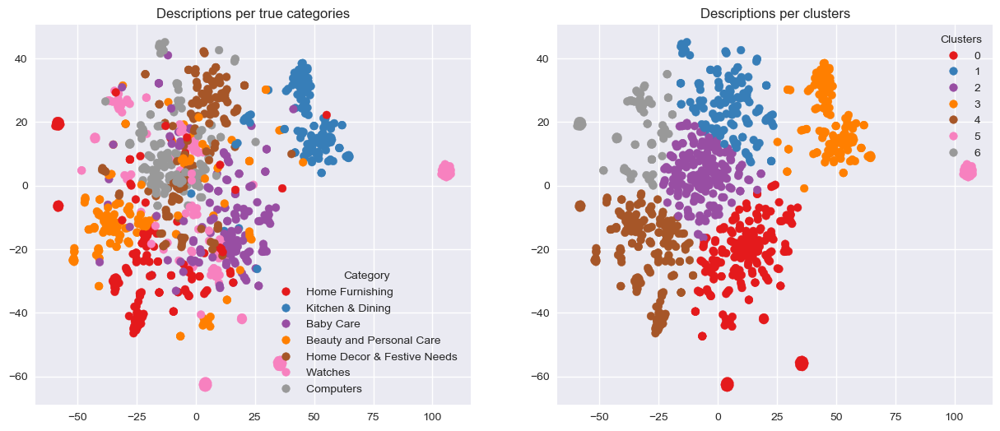

ARI :  0.3255


In [110]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### Spacy, CV

In [111]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_SP_CV, y_cat_num, l_cat)

Nb of PCA features: 346 representing an inertia of: 80.06513300556196
ARI :  0.2881 time :  10.0


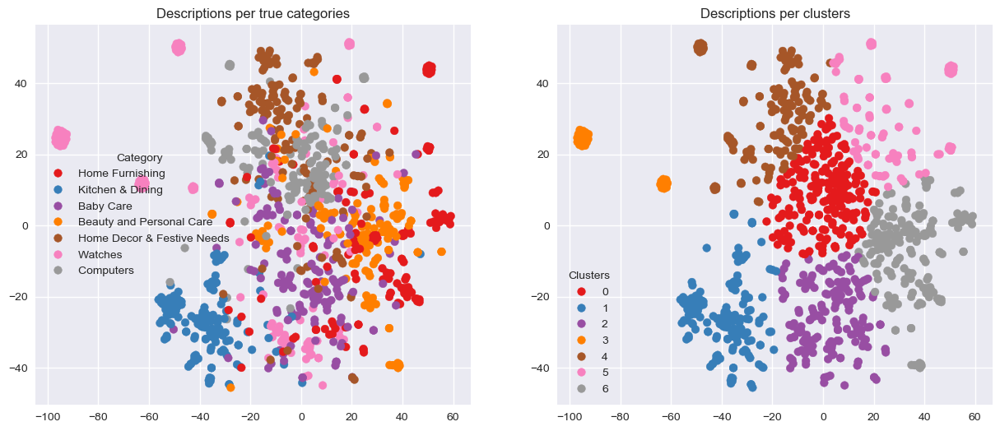

ARI :  0.2881


In [112]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### NLTK, TF_IDF

In [113]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_NL_TF, y_cat_num, l_cat)

Nb of PCA features: 337 representing an inertia of: 80.03126855638057
ARI :  0.3891 time :  8.0


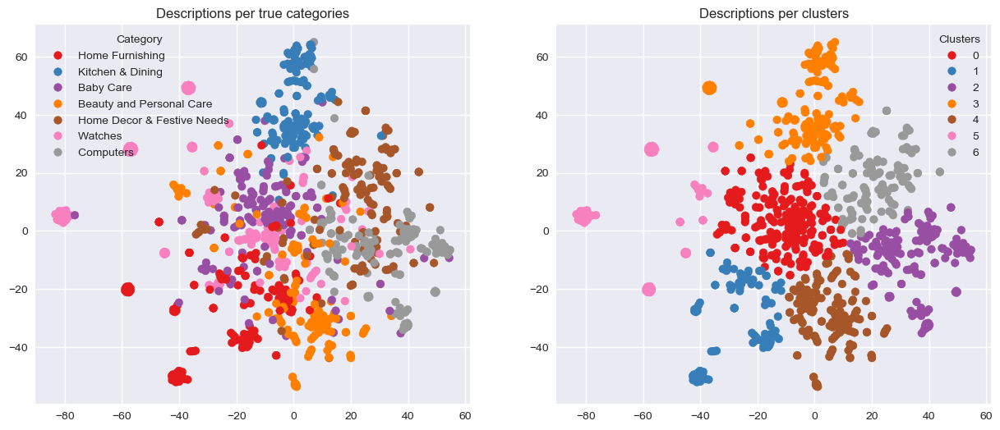

ARI :  0.3891


In [114]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### Spacy, TF_IDF

In [115]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_SP_TF, y_cat_num, l_cat)

Nb of PCA features: 401 representing an inertia of: 80.01218291892853
ARI :  0.2859 time :  9.0


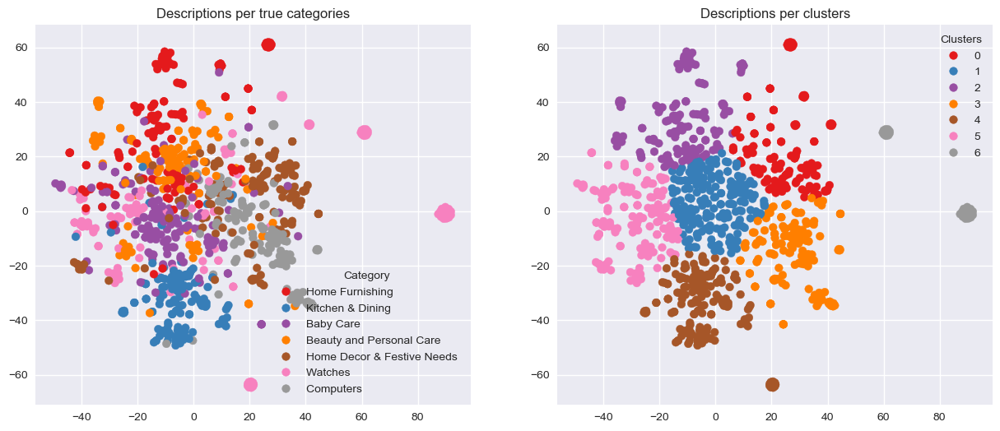

ARI :  0.2859


In [116]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### NLTK, Word2Vec

In [117]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_NL_W2V, y_cat_num, l_cat)

Nb of PCA features: 11 representing an inertia of: 80.4466552734375
ARI :  0.2768 time :  6.0


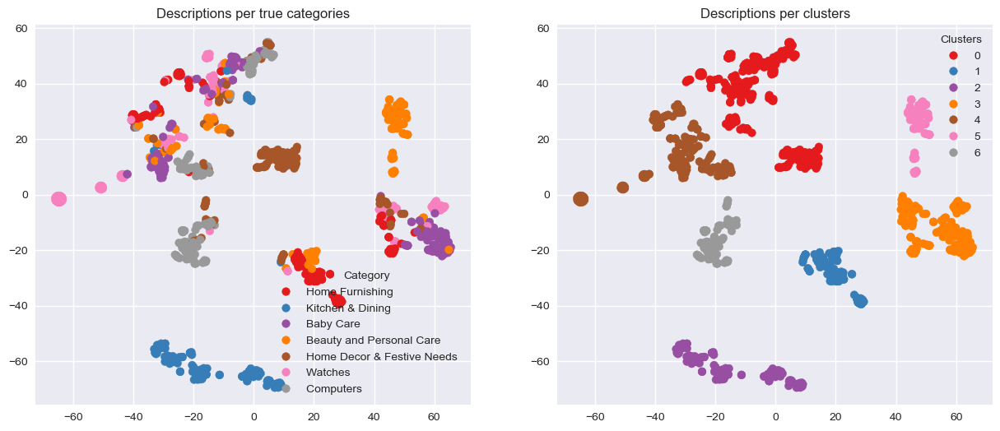

ARI :  0.2768


In [118]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### Spacy, Word2Vec

In [119]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_SP_W2V, y_cat_num, l_cat)

Nb of PCA features: 12 representing an inertia of: 81.60009002685547
ARI :  0.2612 time :  7.0


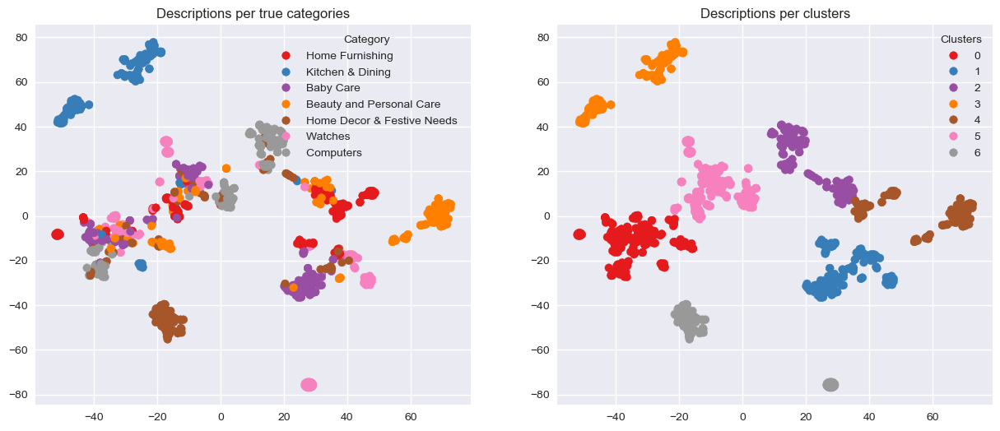

ARI :  0.2612


In [120]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### NLTK, BERT

In [ ]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_NL_bert, y_cat_num, l_cat)

Nombre de features PCA : 46 représentant une inertie de : 80.3475341796875
ARI :  0.3236 time :  8.0


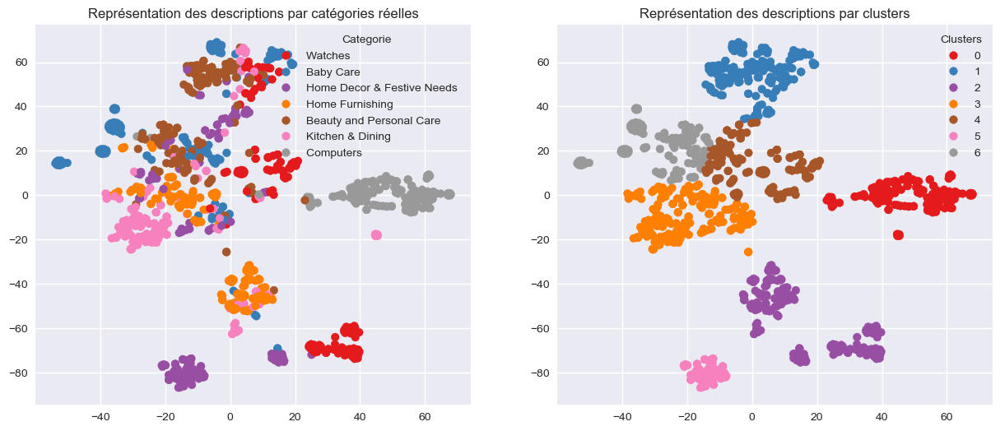

ARI :  0.3236


In [ ]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### Spacy, BERT

In [ ]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_SP_bert, y_cat_num, l_cat)

Nombre de features PCA : 40 représentant une inertie de : 80.03807067871094
ARI :  0.284 time :  8.0


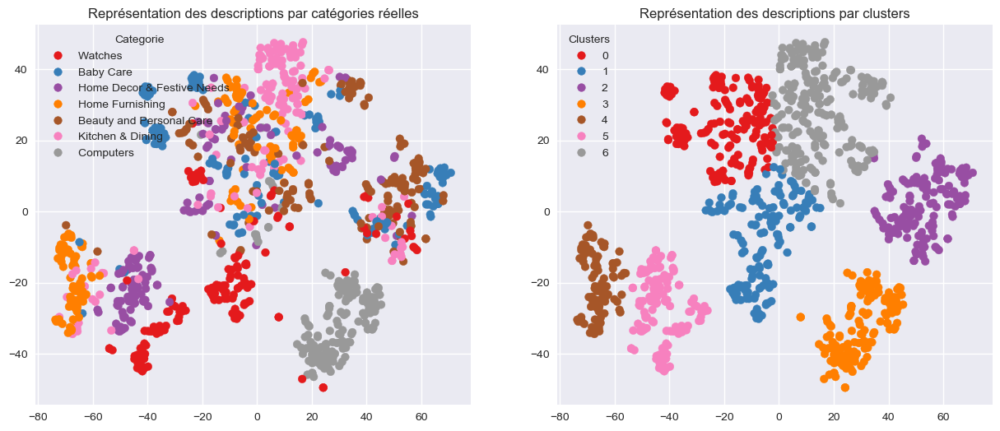

ARI :  0.284


In [ ]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### NLTK, USE

In [ ]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_NL_USE, y_cat_num, l_cat)

Nombre de features PCA : 71 représentant une inertie de : 80.06814575195312
ARI :  0.3695 time :  7.0


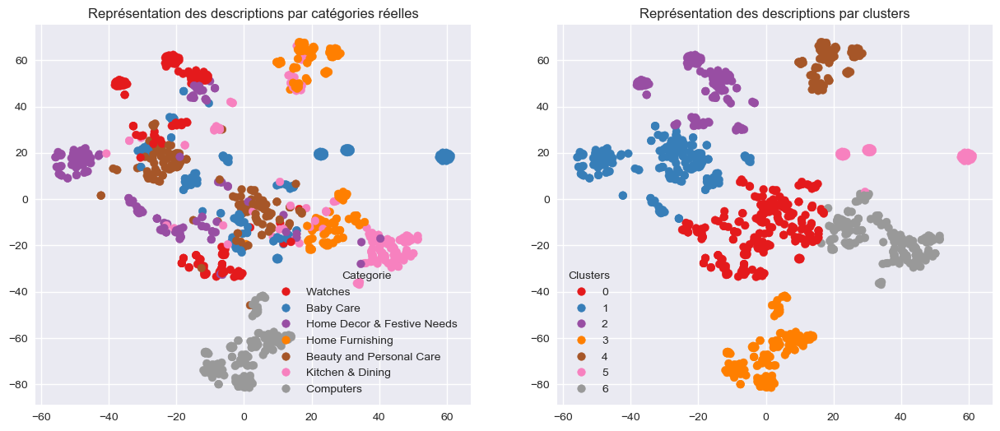

ARI :  0.3695


In [ ]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### Spacy, USE

In [ ]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(features_SP_USE, y_cat_num, l_cat)

Nombre de features PCA : 74 représentant une inertie de : 80.24526977539062
ARI :  0.3571 time :  7.0


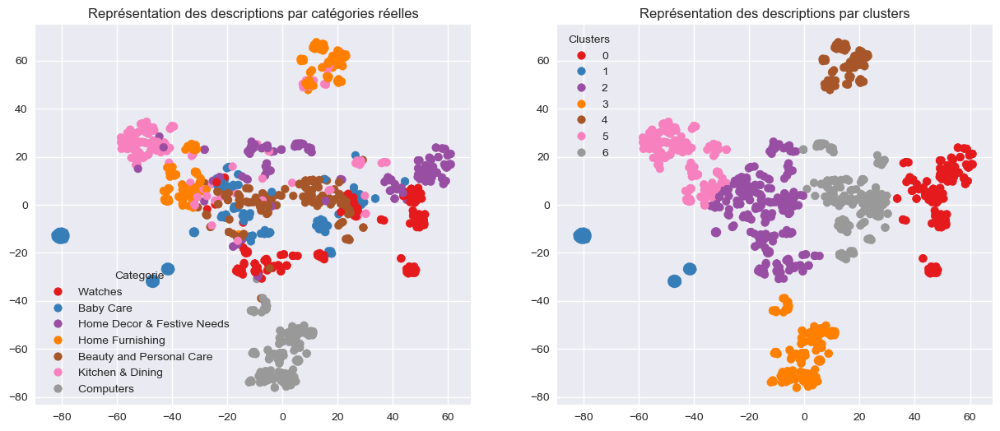

ARI :  0.3571


In [ ]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

# <a name="C22">Supervised Classification</a>

In [122]:
# Encoding class 1 categories
label_enc = LabelEncoder()
df['cat_classe_1'] = label_enc.fit_transform(df.cat_classe_1)
index_mat = label_enc.inverse_transform([0,1,2,3,4,5,6])
index_mat

array(['Baby Care ', 'Beauty and Personal Care ', 'Computers ',
       'Home Decor & Festive Needs ', 'Home Furnishing ',
       'Kitchen & Dining ', 'Watches '], dtype=object)

### NLTK, CV

Nb of PCA features: 266 representing an inertia of: 80.06784904400882
Accuracy :  0.7381 time :  8.0


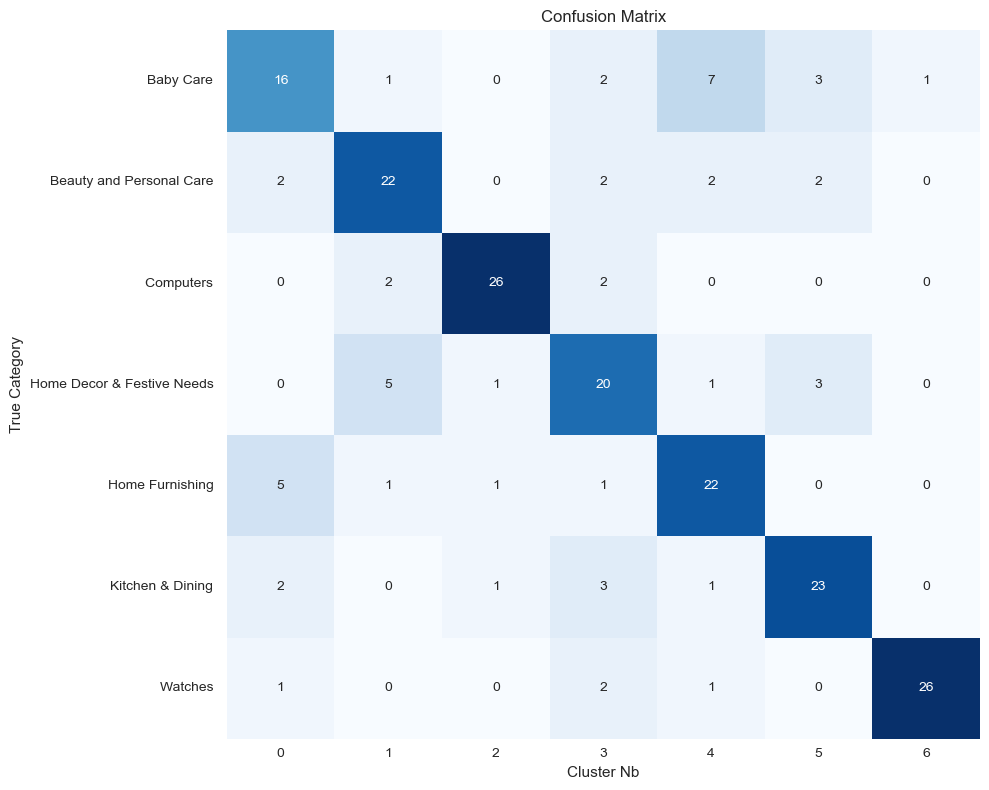

In [123]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_NL_CV, df, index_mat)

### Spacy, CV

Nb of PCA features: 346 representing an inertia of: 80.06513300556196
Accuracy :  0.6667 time :  8.0


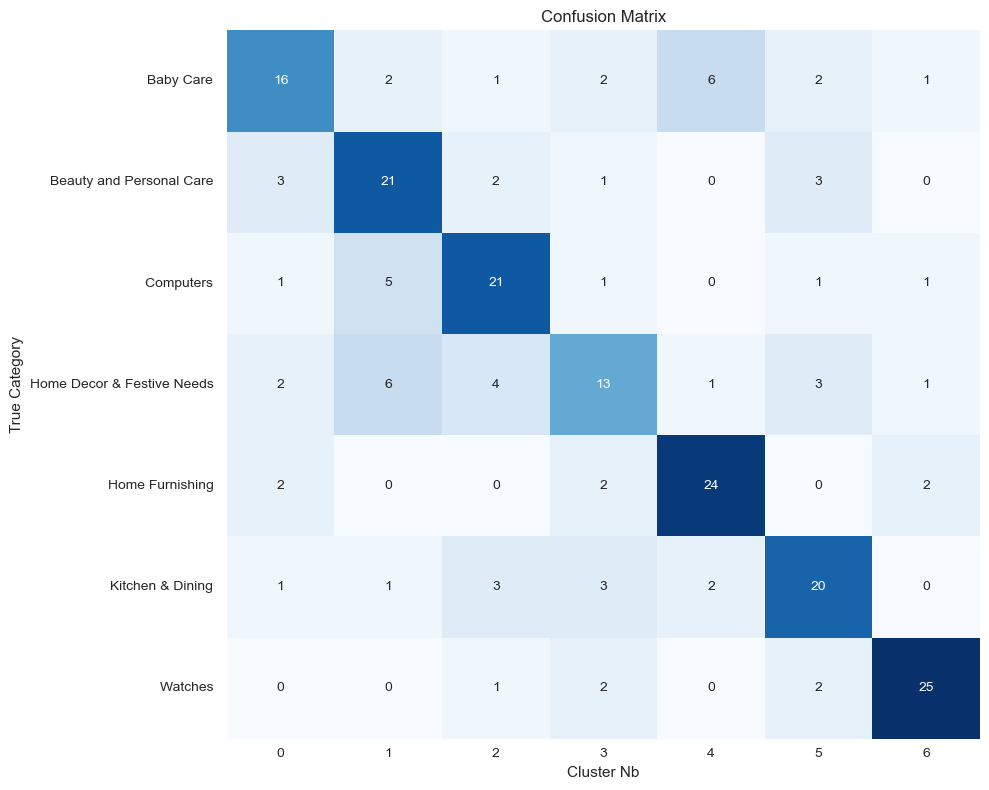

In [124]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_SP_CV, df, index_mat)

### NLTK, TF_IDF

Nb of PCA features: 337 representing an inertia of: 80.03126855638057
Accuracy :  0.7429 time :  7.0


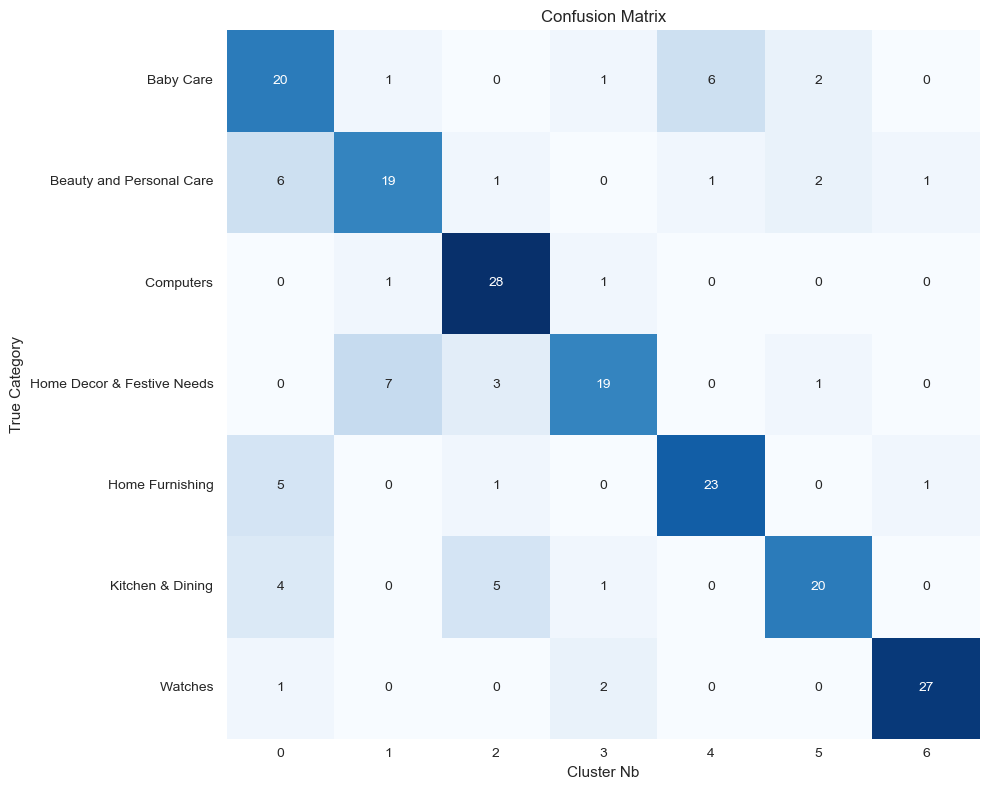

In [125]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_NL_TF, df, index_mat)

### Spacy, TF_IDF

Nb of PCA features: 401 representing an inertia of: 80.01218291892853
Accuracy :  0.7524 time :  9.0


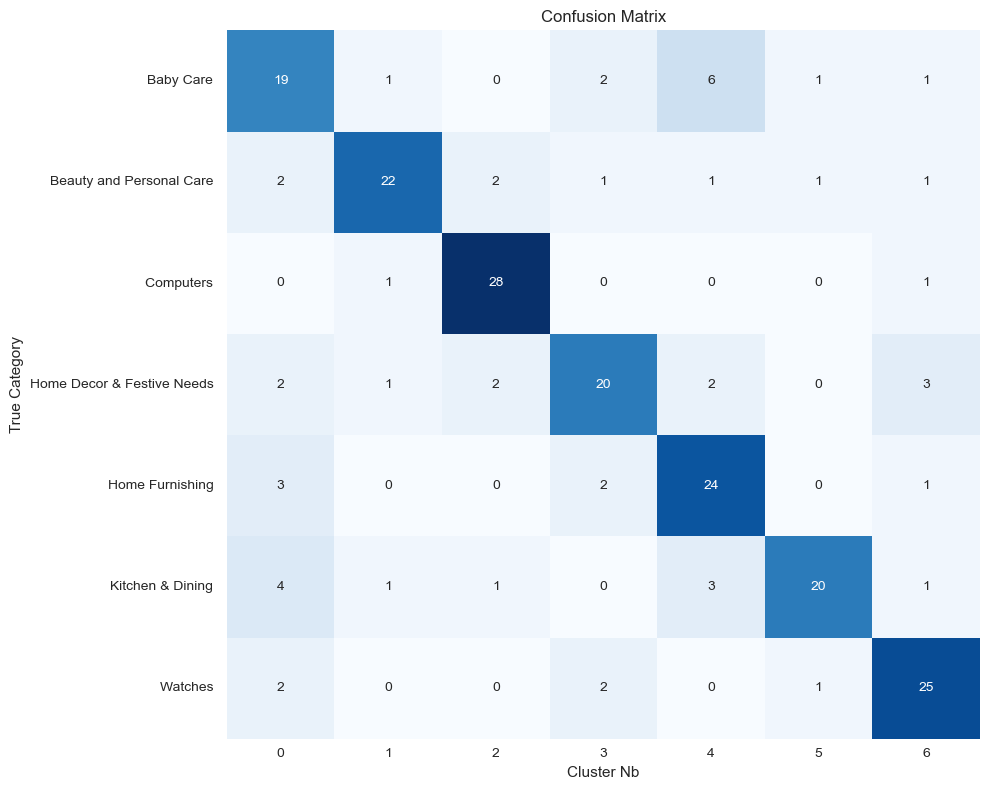

In [126]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_SP_TF, df, index_mat)

### NLTK, Word2Vec

Nb of PCA features: 11 representing an inertia of: 80.4466552734375
Accuracy :  0.8095 time :  5.0


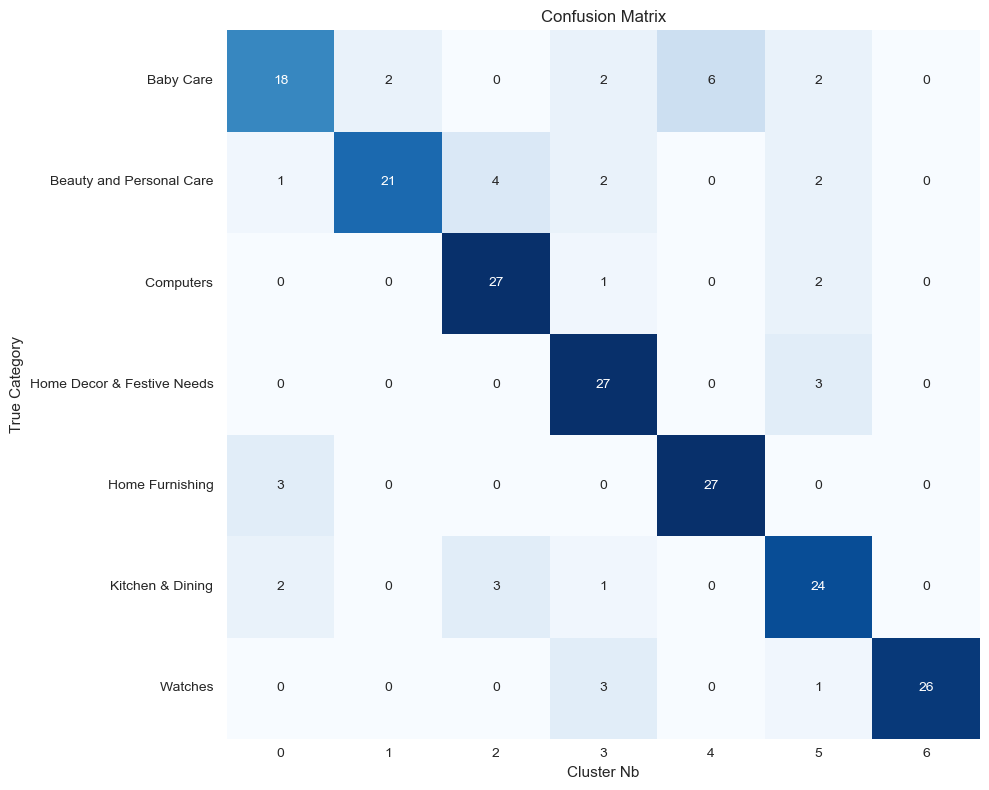

In [127]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_NL_W2V, df, index_mat)

### Spacy, Word2Vec

Nb of PCA features: 12 representing an inertia of: 81.60009002685547
Accuracy :  0.8238 time :  5.0


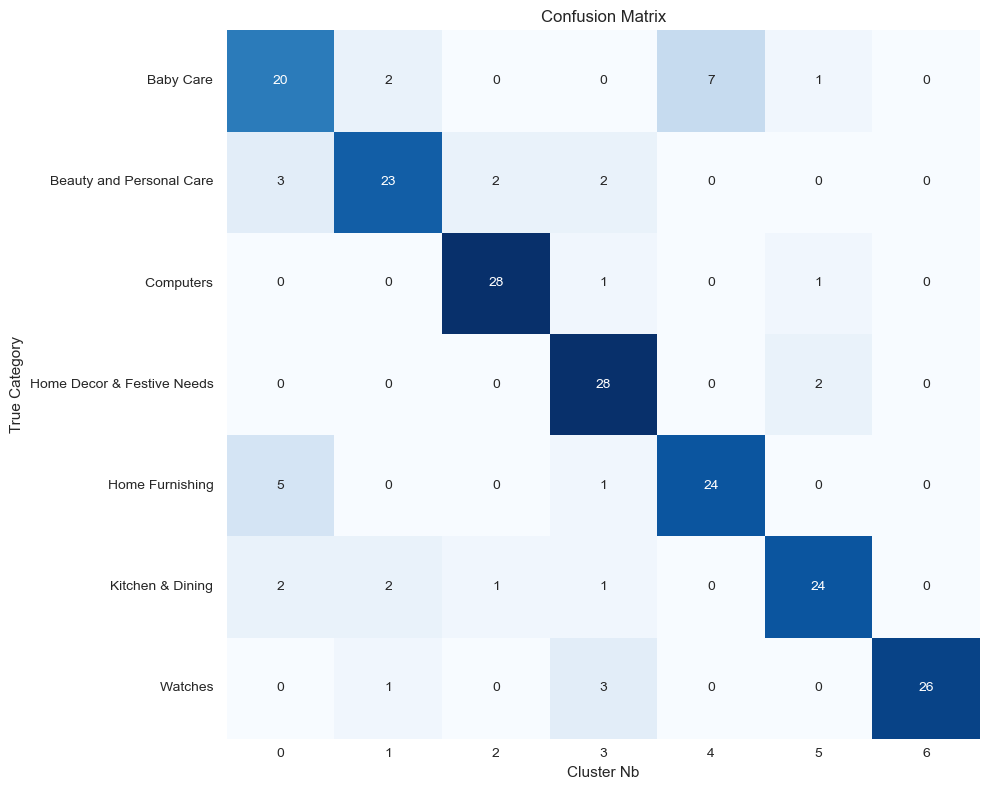

In [128]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_SP_W2V, df, index_mat)

### NLTK, BERT

Nombre de features PCA : 46 représentant une inertie de : 80.3475341796875
Accuracy :  0.8381 time :  6.0


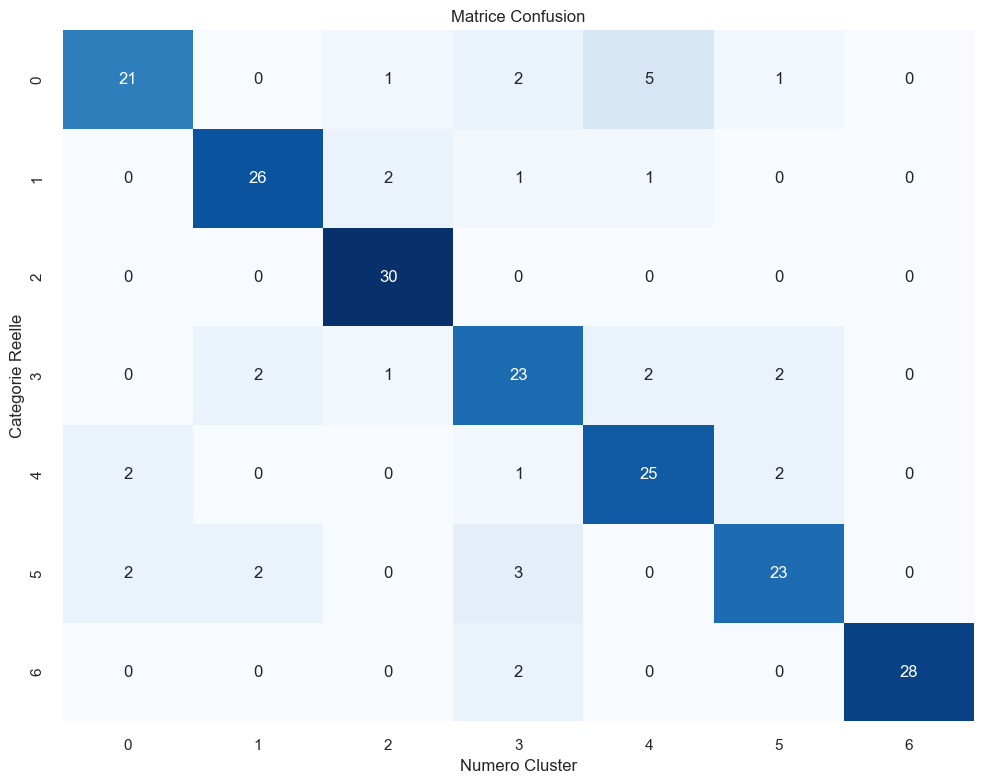

In [ ]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_NL_bert, df, index_mat)

### Spacy, BERT

Nombre de features PCA : 46 représentant une inertie de : 80.3475341796875
Accuracy :  0.8381 time :  6.0


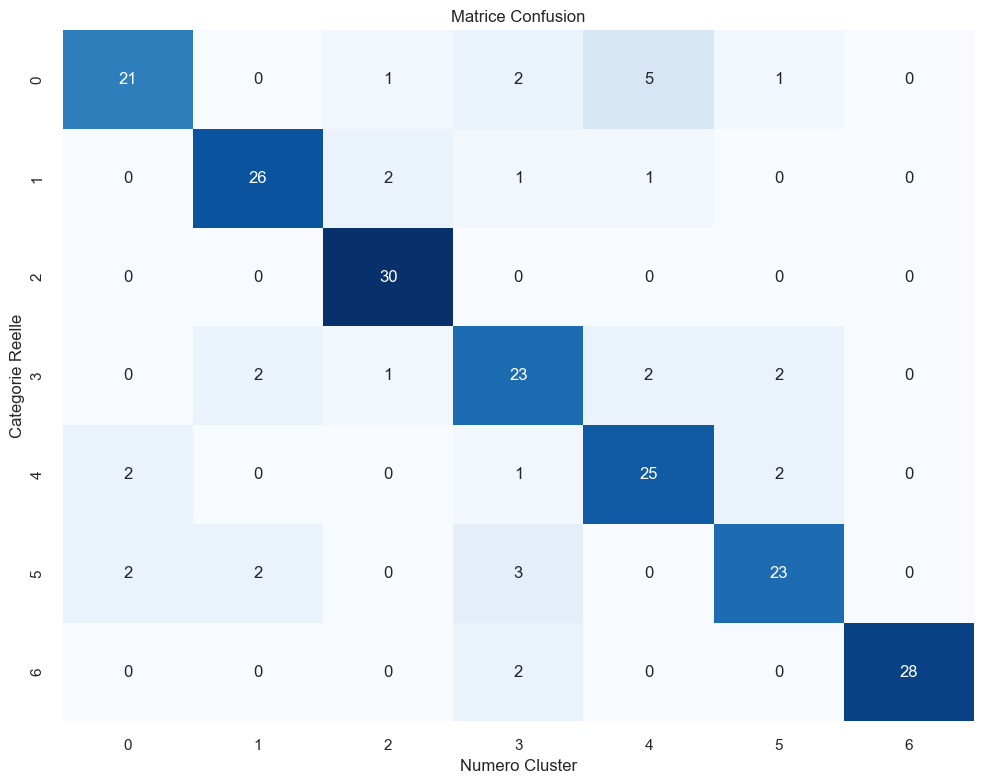

In [ ]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_NL_bert, df, index_mat)

### NLTK, USE

Nombre de features PCA : 71 représentant une inertie de : 80.06814575195312
Accuracy :  0.8952 time :  6.0


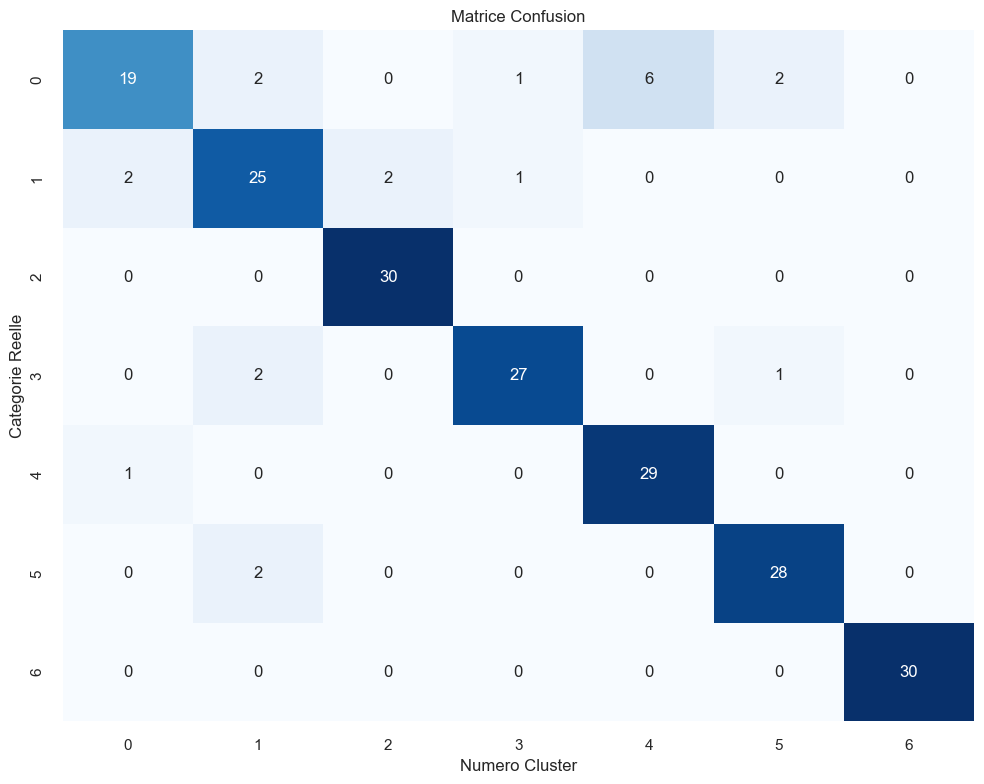

In [ ]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_NL_USE, df, index_mat)

### Spacy, USE

Nombre de features PCA : 74 représentant une inertie de : 80.24526977539062
Accuracy :  0.8571 time :  6.0


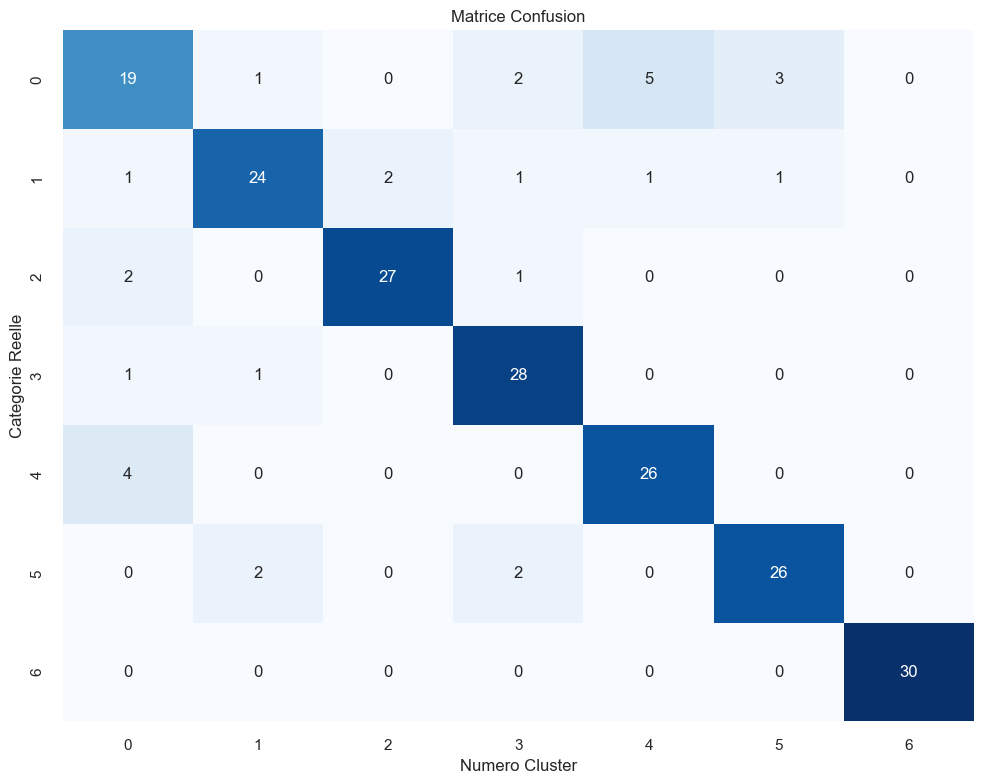

In [ ]:
# Computing the accuracy
accuracy, X_tsne = accuracy_fct(features_SP_USE, df, index_mat)

# --- Part C : Visual Data Classification --- #

# Part 6 : Preprocessing with OpenCV

In [130]:
# Importing the file dataset
df = pd.read_csv("dataset.csv")

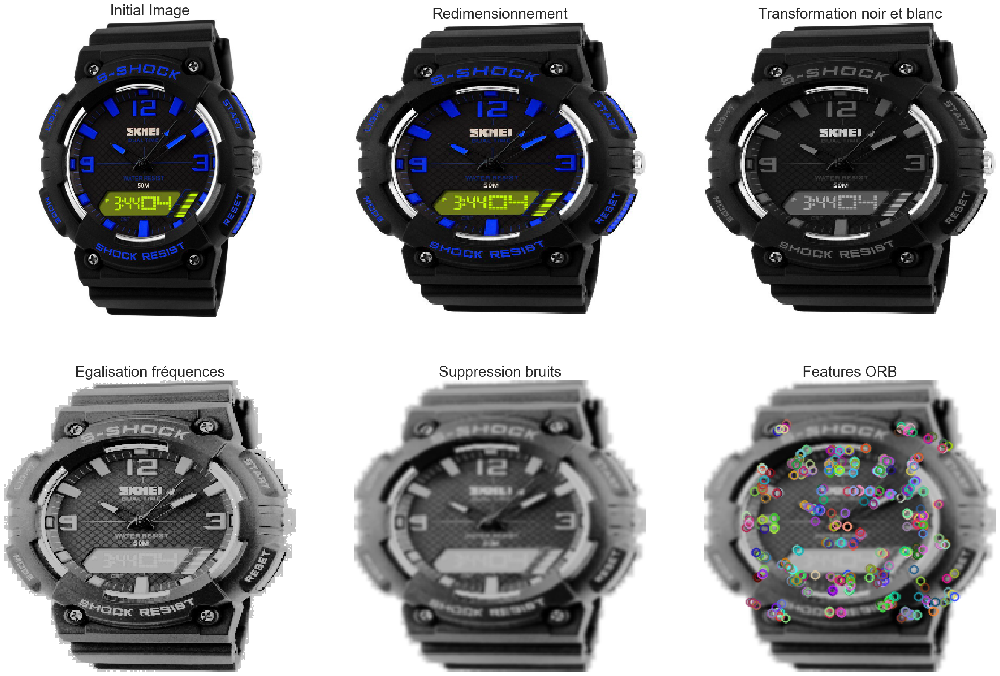

In [131]:
# Following various steps for normalisation and simplification applied to an image

path = ""
filename = path + df['image'][20]

orb = cv2.ORB_create(500)
image = cv2.imread(filename)

plt.figure(figsize=(30, 20))

# Displaying initial image
plt.subplot(2,3,1)
plt.axis('off')
plt.title('Initial Image', fontsize=25)
plt.imshow(image)

# Redimensionning the image
plt.subplot(2,3,2)
dsize = (224, 224)
image = cv2.resize(image, dsize)
plt.axis('off')
plt.title('Redimensionnement', fontsize=25)
plt.imshow(image)

# Transforming to black and white
plt.subplot(2,3,3)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.axis('off')
plt.title('Transformation to black and white', fontsize=25)
plt.imshow(image,cmap='gray')

# Eauqlising frequencies
plt.subplot(2,3,4)
image = cv2.equalizeHist(image)   # equalize image histogram
plt.axis('off')
plt.title('Equalising frequencies', fontsize=25)
plt.imshow(image, cmap='gray')

# Removing noise
plt.subplot(2,3,5)
image = cv2.GaussianBlur(image, (5, 5), 0)
plt.axis('off')
plt.title('Noise suppression', fontsize=25)
plt.imshow(image, cmap='gray')

# Identifying points of interest with ORB algo
plt.subplot(2,3,6)
kp, des = orb.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp,image)
plt.axis('off')
plt.title('Features ORB', fontsize=25)
plt.imshow(img)

plt.show()

# Part 7 : Features Extraction 

# <a name="C13">Method ORB</a>

In [132]:
# Running the model with image preprocessing to extract features
orb_features = features_ORB_fct(df)
orb_features.shape

C:\Users\najwa\AppData\Local\Temp\ipykernel_9716\3364204173.py:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  orb_keypoints_by_img = np.asarray(orb_keypoints)



Nb of descripteurs :  (329785, 32)
time ORB descriptor :            26.68 secondes


C:\Users\najwa\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1043: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 3072 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


0
100
200
300
400
500
600
700
800
900
1000
time ORB features :           147.39 secondes


(1050, 574)

# <a name="C14">Method CNN Simple</a>

In [133]:
# Creating CNN
model = Sequential()
model.add(Conv2D(32, kernel_size=(3,3), padding='same', activation='relu', input_shape=(224,224,3,)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Conv2D(32, kernel_size=(3,3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Flatten())
model.add(Dense(7, activation='softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 32)      9248      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 32)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 100352)            0         
                                                                 
 dense (Dense)               (None, 7)                 7

In [134]:
# Compiling the model
model.compile(loss='mean_squared_error', optimizer='sgd',
              metrics=['accuracy'])

In [135]:
# Running the model with image preprocessing to extract features
cnn_simpl_features = features_CNN_fct(df, model)
cnn_simpl_features.shape

C:\Users\najwa\anaconda3\lib\site-packages\PIL\Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(



Nb of descriptors VGG :  (1050, 7)
time VGG descriptor :           176.13 secondes


(1050, 7)

# <a name="C15">Method CNN VGG16</a>

### VGG16 - No change

In [136]:
# Creating the model
model = VGG16()
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [137]:
# Compiling the model
model.compile(loss='mean_squared_error', optimizer='sgd',
              metrics=['accuracy'])

In [138]:
# Running the model with image preprocessing to extract features
cnn_vgg16_features = features_CNN_fct(df, model)
cnn_vgg16_features.shape


Nb of descriptors VGG :  (1050, 1000)
time VGG descriptor :           289.46 secondes


(1050, 1000)

### VGG16 Option 1 - No last classification layer

In [139]:
# Loading VGG16
model = VGG16()
# Deleting last classification layer
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [140]:
# Compiling the model
model.compile(loss='mean_squared_error', optimizer='sgd',
              metrics=['accuracy'])

In [141]:
# Running the model with image preprocessing to extract features
cnn_vgg16_opt1_features = features_CNN_fct(df, model)
cnn_vgg16_opt1_features.shape


Nb of descriptors VGG :  (1050, 4096)
time VGG descriptor :           297.31 secondes


(1050, 4096)

### VGG16 Option 2 - No last classification layer and addition of classification layer with 7 clusters

In [142]:
# Loading VGG16
model = VGG16()
# Deleting last classification layer
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)
# Creating the model
vgg_transfer = Sequential()
vgg_transfer.add(model)
# Adding classification layer with 7 clusters
vgg_transfer.add(Dense(len(l_cat), activation='softmax'))
vgg_transfer.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 model_3 (Functional)        (None, 4096)              134260544 
                                                                 
 dense_1 (Dense)             (None, 7)                 28679     
                                                                 
Total params: 134,289,223
Trainable params: 134,289,223
Non-trainable params: 0
_________________________________________________________________


In [143]:
# Compiling the model
vgg_transfer.compile(loss='mean_squared_error', optimizer='sgd',
              metrics=['accuracy'])

In [144]:
# Running the model with image preprocessing to extract features
cnn_vgg16_opt2_features = features_CNN_fct(df, vgg_transfer)
cnn_vgg16_opt2_features.shape


Nb of descriptors VGG :  (1050, 7)
time VGG descriptor :           294.71 secondes


(1050, 7)

### VGG16 Option 3 - No last classification layers and additonal layers Flatten and Dense 7

In [145]:
# Loading VGG16 without last layers (fully connected).
model = VGG16(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

x = model.output
# Adding a Flatten layer to reduce the dimensions of the input.
x = Flatten()(x)
# Adding a Dense layer of prediciton adapted to our classification problem (7 classes).
predictions = Dense(7, activation='softmax')(x)

# Creating the new model
new_model = Model(inputs=model.input, outputs=predictions)

# No training of the first layers (10 +).
for layer in new_model.layers[:10]:
    layer.trainable=False
    
# Training of last years and classifier  
for layer in new_model.layers[10:]:
    layer.trainable=True
    
new_model.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [146]:
# Compiling the model
new_model.compile(loss='mean_squared_error', optimizer='sgd',
              metrics=['accuracy'])

In [147]:
# Running the model with image preprocessing to extract features
cnn_vgg16_opt3_features = features_CNN_fct(df, new_model)
cnn_vgg16_opt3_features.shape


Nb of descriptors VGG :  (1050, 7)
time VGG descriptor :           282.36 secondes


(1050, 7)

# Part 8 : Modeling and Visualisation

# <a name="C16">Clustering</a>

### ORB

In [148]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(orb_features, y_cat_num, l_cat)

Nb of PCA features: 238 representing an inertia of: 80.00188858203776
ARI :  0.0222 time :  8.0


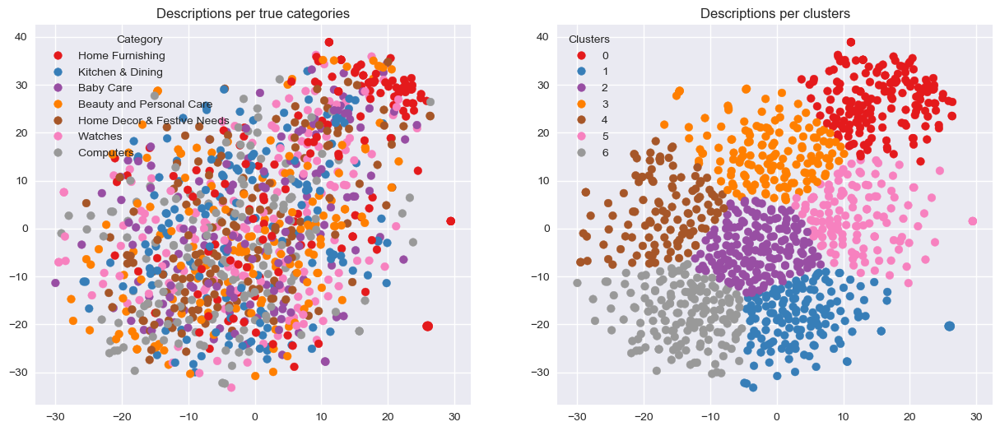

ARI :  0.0222


In [149]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### CNN Simple

In [150]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(cnn_simpl_features, y_cat_num, l_cat)

Nb of PCA features: 5 representing an inertia of: 85.784912109375
ARI :  0.0117 time :  7.0


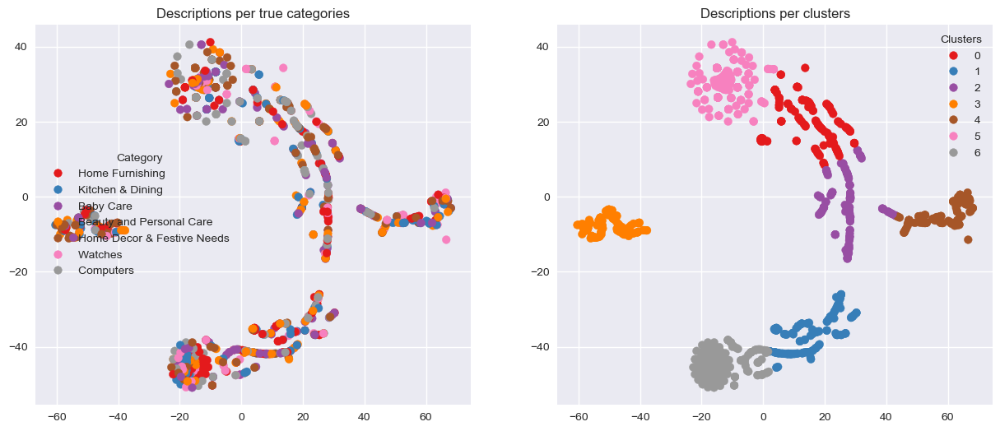

ARI :  0.0117


In [151]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### VGG16 - No change

In [152]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(cnn_vgg16_features, y_cat_num, l_cat)

Nb of PCA features: 184 representing an inertia of: 80.02264404296875
ARI :  0.3286 time :  8.0


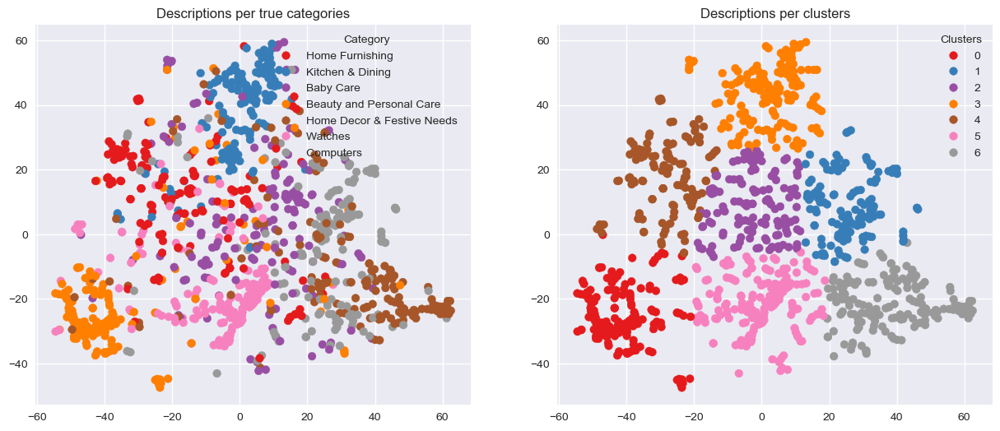

ARI :  0.3286


In [153]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### VGG16 Option 1 - No last classfication layer

In [154]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(cnn_vgg16_opt1_features, y_cat_num, l_cat)

Nb of PCA features: 244 representing an inertia of: 80.02812194824219
ARI :  0.4565 time :  8.0


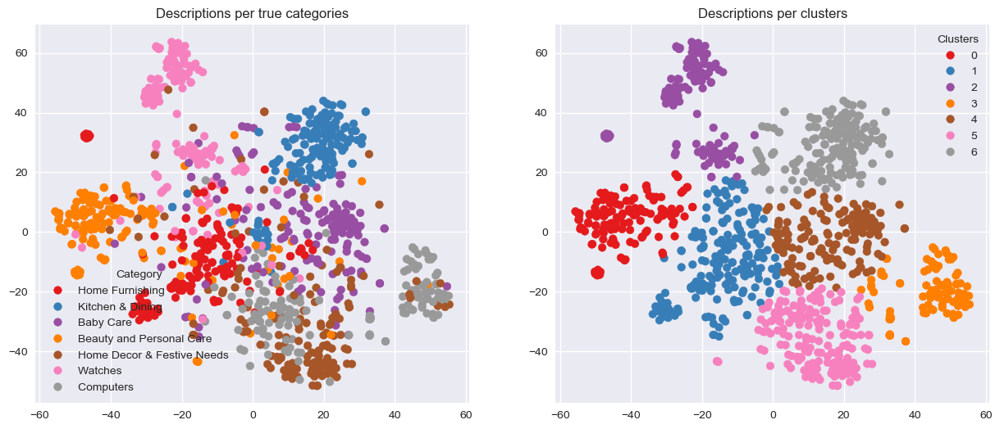

ARI :  0.4565


In [155]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### VGG16 Option 2 - No last classfication layer and addition of 7 clusters layer

In [156]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(cnn_vgg16_opt2_features, y_cat_num, l_cat)

Nb of PCA features: 5 representing an inertia of: 86.89718627929688
ARI :  0.0596 time :  6.0


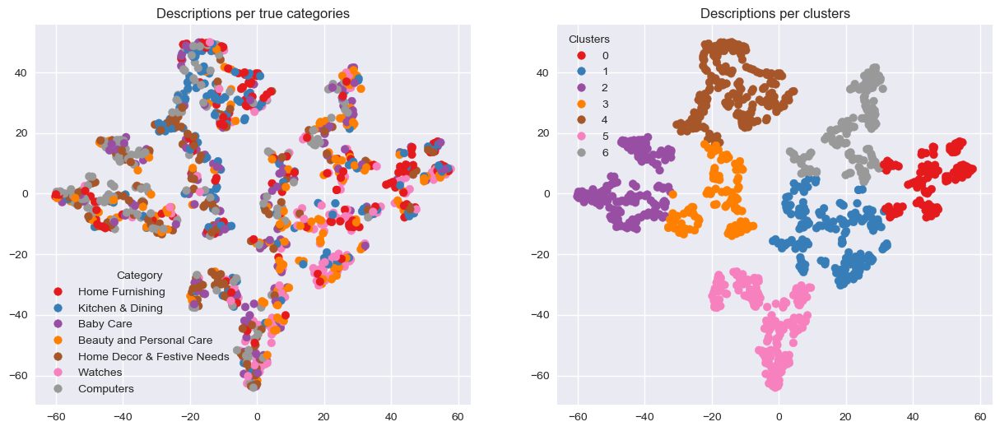

ARI :  0.0596


In [157]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

### VGG16 Option 3 - No last 2 classfication layers and addition of layers Flatten and Dense 7

In [158]:
# Calculating ARI from KMeans clustering
ARI, X_tsne, labels = ARI_fct(cnn_vgg16_opt3_features, y_cat_num, l_cat)

Nb of PCA features: 5 representing an inertia of: 85.10942077636719
ARI :  0.0147 time :  7.0


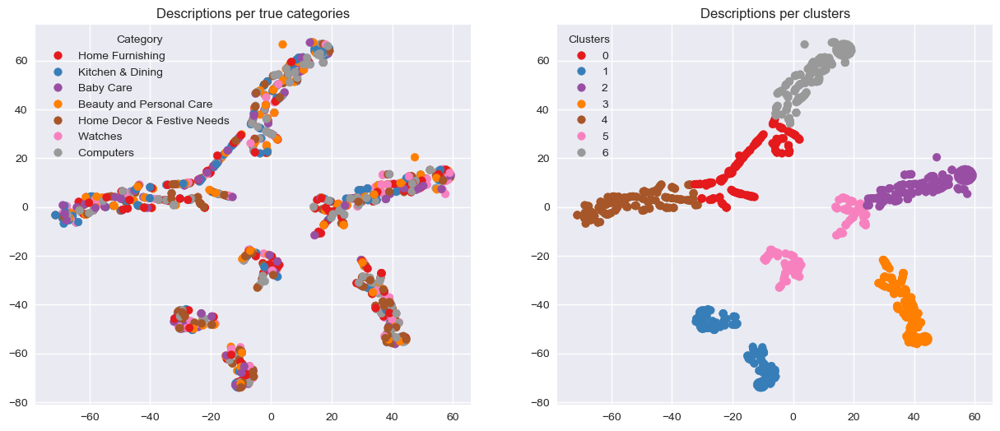

ARI :  0.0147


In [159]:
# Visualising TSNE 2D and comparing true categories to clusters
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

# <a name="C17">Supervised Classification</a>

In [160]:
# Encoding of class 1 category
label_enc = LabelEncoder()
df['cat_classe_1'] = label_enc.fit_transform(df.cat_classe_1)
index_mat = label_enc.inverse_transform([0,1,2,3,4,5,6])
index_mat

array(['Baby Care ', 'Beauty and Personal Care ', 'Computers ',
       'Home Decor & Festive Needs ', 'Home Furnishing ',
       'Kitchen & Dining ', 'Watches '], dtype=object)

### ORB

Nb of PCA features: 238 representing an inertia of: 80.00188858203776
Accuracy :  0.2333 time :  6.0


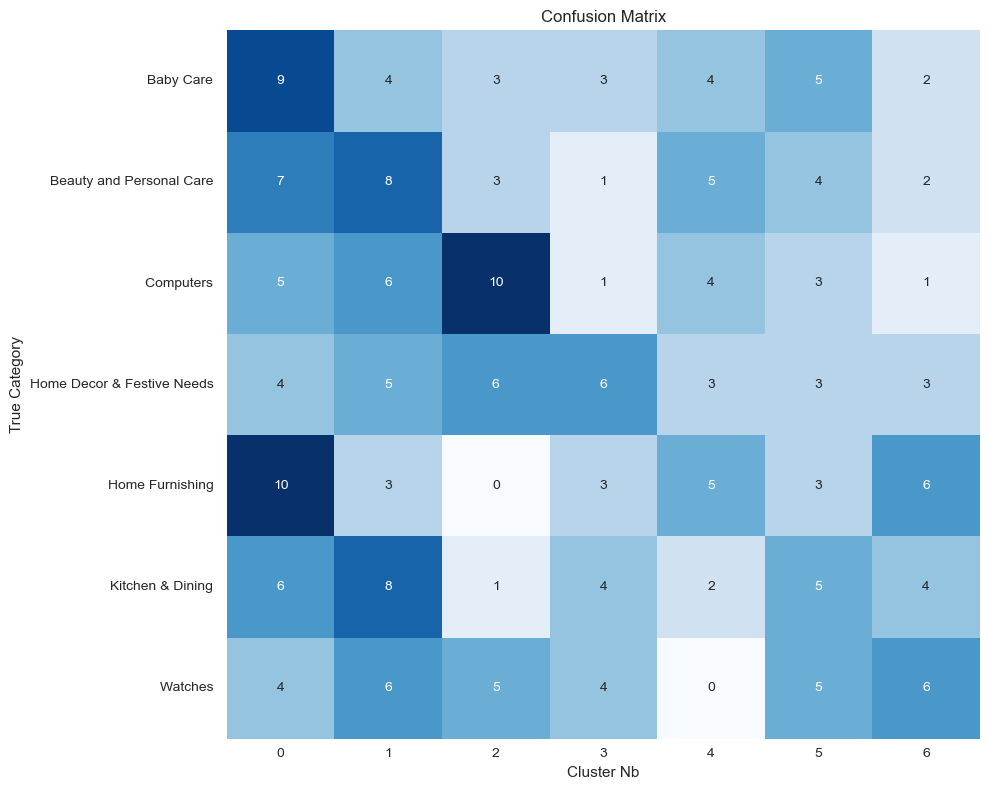

(0.2333,
 array([[-21.687246 , -23.480284 ],
        [-10.541541 , -15.043409 ],
        [-21.742622 ,  -1.8523757],
        ...,
        [-10.846497 , -10.529273 ],
        [ 20.574682 ,  17.523136 ],
        [-15.093007 , -20.09903  ]], dtype=float32))

In [161]:
# Computing the accuracy
accuracy_fct(orb_features, df, index_mat)

### CNN Simple

Nb of PCA features: 5 representing an inertia of: 85.784912109375
Accuracy :  0.219 time :  5.0


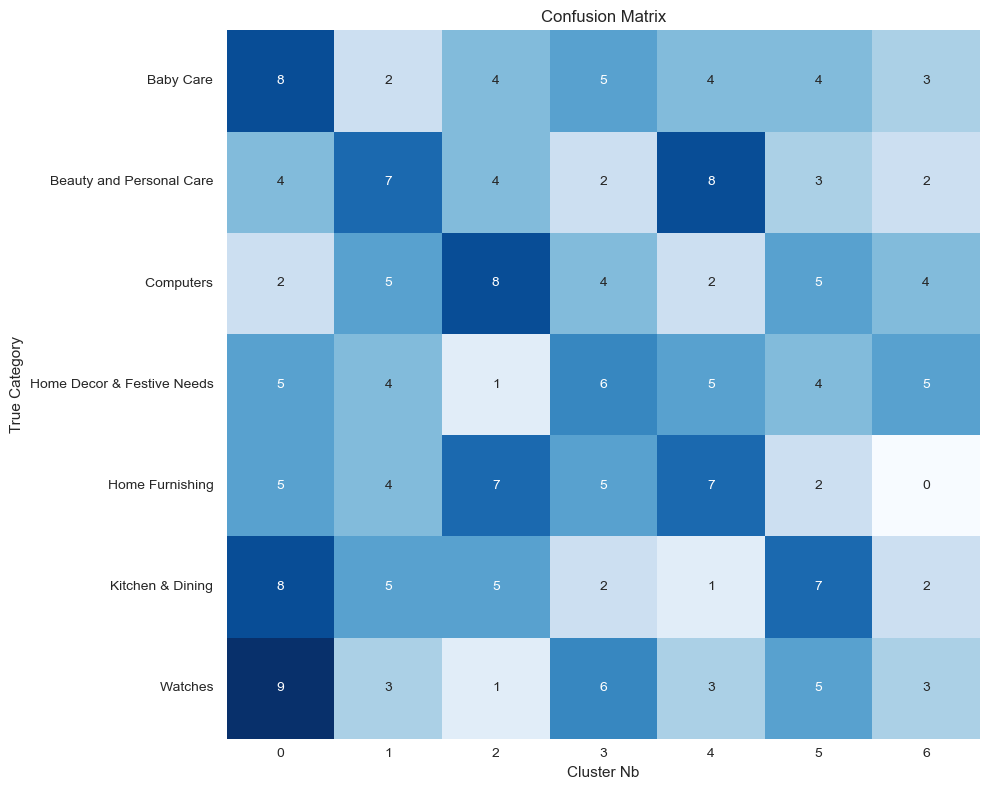

(0.219,
 array([[-43.391632,  -9.317872],
        [-11.291576,  29.310137],
        [-10.737741,  30.16674 ],
        ...,
        [ 27.552492,  18.06288 ],
        [-58.069798,  -8.023412],
        [ -2.772579,  31.17079 ]], dtype=float32))

In [162]:
# Computing the accuracy
accuracy_fct(cnn_simpl_features, df, index_mat)

### VGG16 - No change

Nb of PCA features: 184 representing an inertia of: 80.02264404296875
Accuracy :  0.6952 time :  7.0


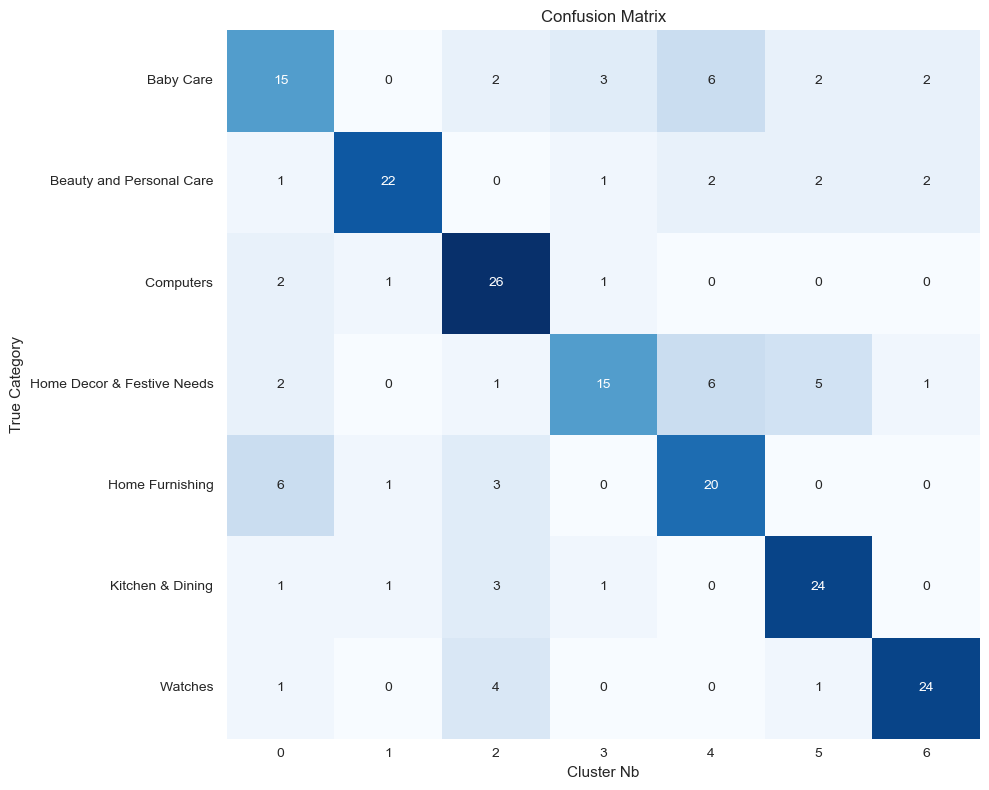

(0.6952,
 array([[ 32.163822  ,  21.866058  ],
        [ 28.590097  , -27.278204  ],
        [ 32.435158  , -24.344044  ],
        ...,
        [ 24.839378  ,  22.092058  ],
        [ 32.583233  ,  -0.80715895],
        [  9.295145  ,  33.00314   ]], dtype=float32))

In [163]:
# Computing the accuracy
accuracy_fct(cnn_vgg16_features, df, index_mat)

### VGG16 Option 1 - No last classification layer

Nb of PCA features: 244 representing an inertia of: 80.02812194824219
Accuracy :  0.7857 time :  7.0


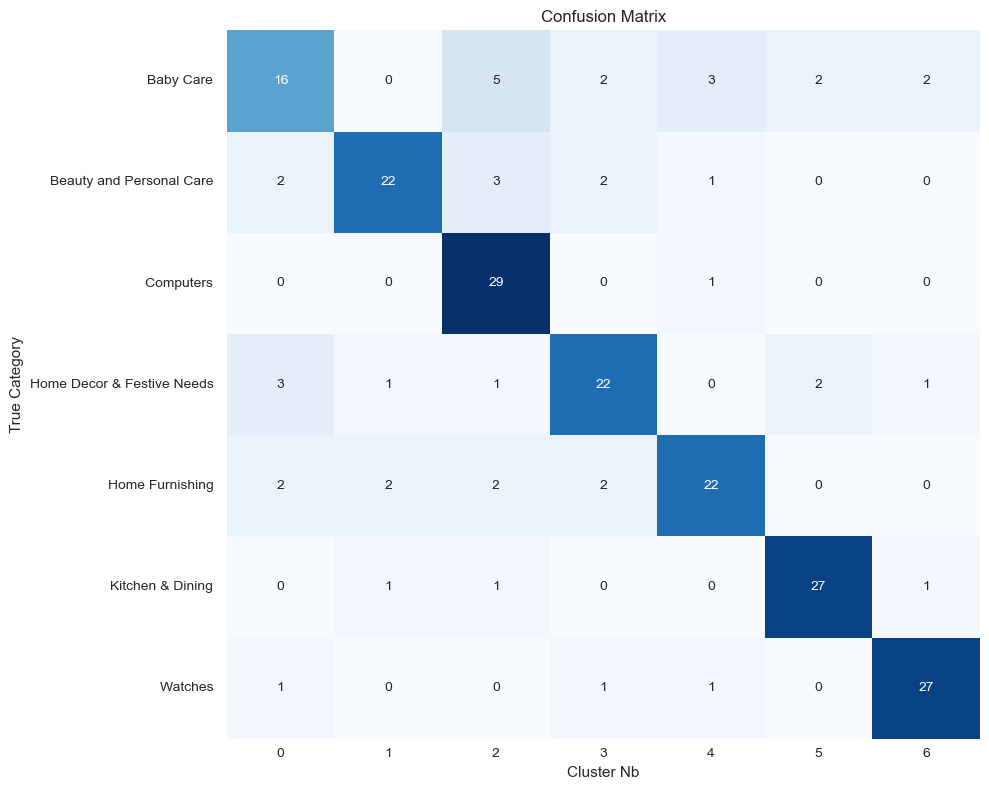

(0.7857,
 array([[ 45.486595, -10.838002],
        [ 14.359187, -26.377579],
        [  6.225976, -29.060638],
        ...,
        [ 46.11282 , -16.482254],
        [ 27.705235, -18.53386 ],
        [ 24.757793, -11.893318]], dtype=float32))

In [164]:
# Computing the accuracy
accuracy_fct(cnn_vgg16_opt1_features, df, index_mat)

### VGG16 Option 2 - No last classification layer and and additional layer with 7 clusters

Nb of PCA features: 5 representing an inertia of: 86.89718627929688
Accuracy :  0.3143 time :  6.0


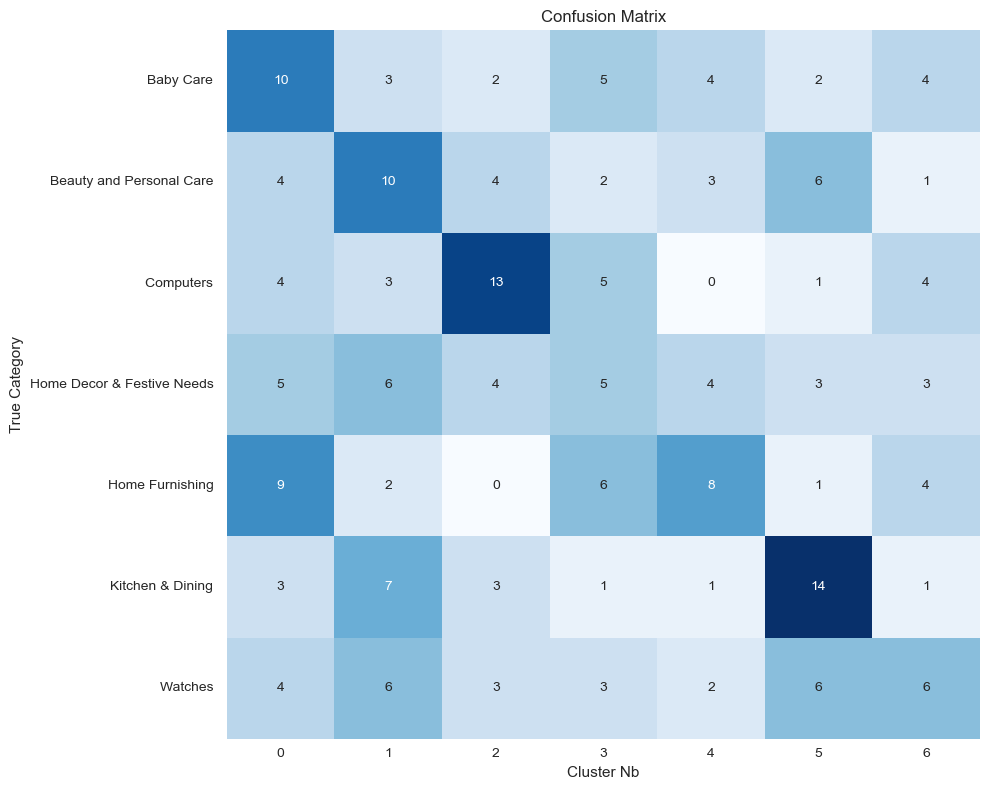

(0.3143,
 array([[-11.990263,  49.200386],
        [ 19.16967 ,  22.057835],
        [-29.676706, -12.857156],
        ...,
        [ 20.190834,  20.531   ],
        [-40.276794,  14.275087],
        [ 52.484684,  13.692384]], dtype=float32))

In [165]:
# Computing the accuracy
accuracy_fct(cnn_vgg16_opt2_features, df, index_mat)

### VGG16 Option 3 - No last classification layers, additon of layers Flatten and Dense 7

Nb of PCA features: 5 representing an inertia of: 85.10942077636719
Accuracy :  0.1762 time :  6.0


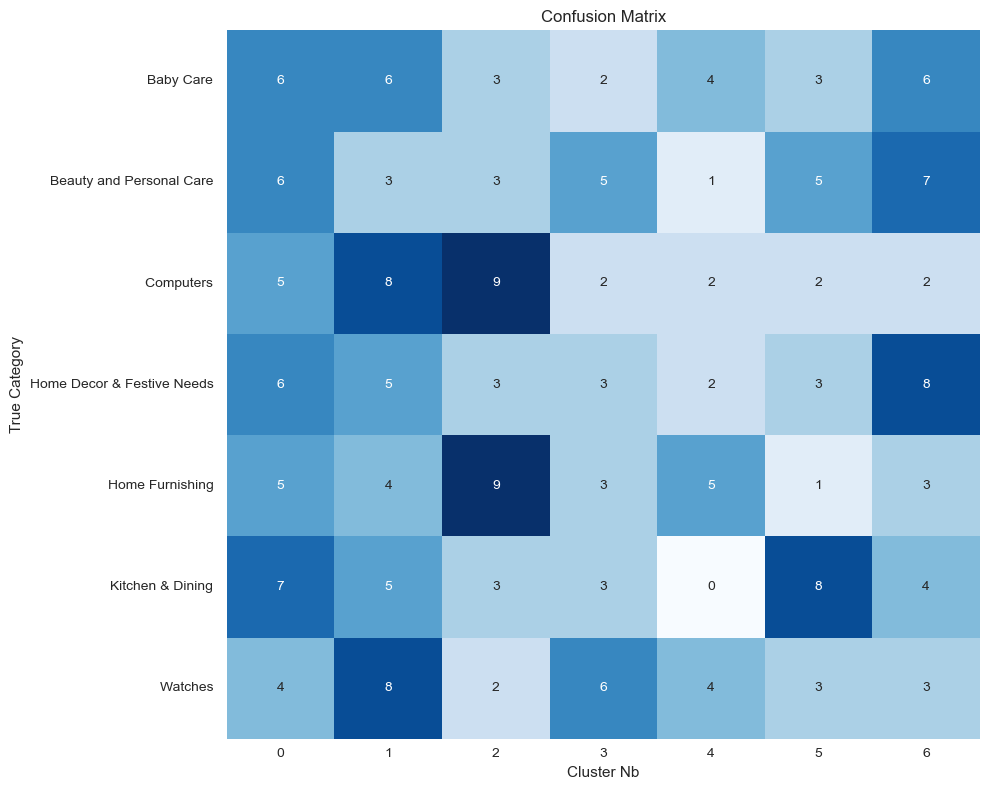

(0.1762,
 array([[ 36.329647 , -27.095894 ],
        [ 43.22054  , -54.778072 ],
        [ 23.187061 ,  -3.0295186],
        ...,
        [ 37.724022 , -53.725616 ],
        [-23.307615 ,   1.236551 ],
        [-30.305758 , -49.667778 ]], dtype=float32))

In [166]:
# Computing the accuracy
accuracy_fct(cnn_vgg16_opt3_features, df, index_mat)

The end of notebook